# `Hackathon -----------------------------------------------------`
### - [Data Description](https://www.kaggle.com/karangadiya/fifa19)

# `Task 1 - Data Visualization and Data Preparation`

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt

In [2]:
data = pd.read_csv('football_data.csv')
data.head()

,Unnamed: 0,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
0,0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,€226.5M
1,1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,€127.1M
2,2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,€228.1M
3,3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,€138.6M
4,4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,€196.4M


In [3]:
data.drop('Unnamed: 0',axis=1,inplace=True)

In [4]:
col_names = [col.lower().replace(' ','_') for col in data.columns]
data.columns = col_names

In [5]:
data.shape

(18207, 88)

In [6]:
data.columns

Index(['id', 'name', 'age', 'photo', 'nationality', 'flag', 'overall',
       'potential', 'club', 'club_logo', 'value', 'wage', 'special',
       'preferred_foot', 'international_reputation', 'weak_foot',
       'skill_moves', 'work_rate', 'body_type', 'real_face', 'position',
       'jersey_number', 'joined', 'loaned_from', 'contract_valid_until',
       'height', 'weight', 'ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw',
       'lam', 'cam', 'ram', 'lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm',
       'cdm', 'rdm', 'rwb', 'lb', 'lcb', 'cb', 'rcb', 'rb', 'crossing',
       'finishing', 'headingaccuracy', 'shortpassing', 'volleys', 'dribbling',
       'curve', 'fkaccuracy', 'longpassing', 'ballcontrol', 'acceleration',
       'sprintspeed', 'agility', 'reactions', 'balance', 'shotpower',
       'jumping', 'stamina', 'strength', 'longshots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'composure',
       'marking', 'standingtackle', 'slidingtackle', 'gkdiv

#### `useless columns`

In [7]:
data.drop(['ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam',
       'ram', 'lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm',
       'rwb', 'lb', 'lcb', 'cb', 'rcb', 'rb'],axis=1,inplace=True)

In [8]:
pd.set_option("display.max_rows", None)
(data.isnull().sum()/data.shape[0])*100

id                           0.000000
name                         0.000000
age                          0.000000
photo                        0.000000
nationality                  0.000000
flag                         0.000000
overall                      0.000000
potential                    0.000000
club                         1.323667
club_logo                    0.000000
value                        0.000000
wage                         0.000000
special                      0.000000
preferred_foot               0.263635
international_reputation     0.263635
weak_foot                    0.263635
skill_moves                  0.263635
work_rate                    0.263635
body_type                    0.263635
real_face                    0.263635
position                     0.329544
jersey_number                0.329544
joined                       8.529686
loaned_from                 93.057615
contract_valid_until         1.587302
height                       0.263635
weight      

In [9]:
data.dtypes

id                            int64
name                         object
age                           int64
photo                        object
nationality                  object
flag                         object
overall                       int64
potential                     int64
club                         object
club_logo                    object
value                        object
wage                         object
special                       int64
preferred_foot               object
international_reputation    float64
weak_foot                   float64
skill_moves                 float64
work_rate                    object
body_type                    object
real_face                    object
position                     object
jersey_number               float64
joined                       object
loaned_from                  object
contract_valid_until         object
height                       object
weight                       object
crossing                    

In [10]:
numerical_data = data.select_dtypes(include=['int64','float64'])
len(numerical_data.columns)

43

In [11]:
categorical_data = data.select_dtypes(include=['object'])
len(categorical_data.columns)

19

In [12]:
pd.set_option("display.max_columns", None)
numerical_data.head()

,id,age,overall,potential,special,international_reputation,weak_foot,skill_moves,jersey_number,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes
0,158023,31,94,94,2202,5.0,4.0,4.0,10.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0
1,20801,33,94,94,2228,5.0,4.0,5.0,7.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0
2,190871,26,92,93,2143,5.0,5.0,5.0,10.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0
3,193080,27,91,93,1471,4.0,3.0,1.0,1.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0
4,192985,27,91,92,2281,4.0,5.0,4.0,7.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0


In [13]:
pd.set_option("display.max_columns", None)
categorical_data.head()

,name,photo,nationality,flag,club,club_logo,value,wage,preferred_foot,work_rate,body_type,real_face,position,joined,loaned_from,contract_valid_until,height,weight,release_clause
0,L. Messi,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,FC Barcelona,https://cdn.sofifa.org/teams/2/light/241.png,€110.5M,€565K,Left,Medium/ Medium,Messi,Yes,RF,"Jul 1, 2004",NaN,2021,5'7,159lbs,€226.5M
1,Cristiano Ronaldo,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,Juventus,https://cdn.sofifa.org/teams/2/light/45.png,€77M,€405K,Right,High/ Low,C. Ronaldo,Yes,ST,"Jul 10, 2018",NaN,2022,6'2,183lbs,€127.1M
2,Neymar Jr,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,Paris Saint-Germain,https://cdn.sofifa.org/teams/2/light/73.png,€118.5M,€290K,Right,High/ Medium,Neymar,Yes,LW,"Aug 3, 2017",NaN,2022,5'9,150lbs,€228.1M
3,De Gea,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,Manchester United,https://cdn.sofifa.org/teams/2/light/11.png,€72M,€260K,Right,Medium/ Medium,Lean,Yes,GK,"Jul 1, 2011",NaN,2020,6'4,168lbs,€138.6M
4,K. De Bruyne,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,Manchester City,https://cdn.sofifa.org/teams/2/light/10.png,€102M,€355K,Right,High/ High,Normal,Yes,RCM,"Aug 30, 2015",NaN,2023,5'11,154lbs,€196.4M


In [14]:
data.value = data.value.apply(lambda x: x.replace('\u20ac','') if '\u20ac' in x else x)
data.value = data.value.apply(lambda x: float(x.replace('M',''))*1000000 if 'M' in x else float(x.replace('K',''))*1000 if 'K' in x else x)
data.value

0        110500000.0
1         77000000.0
2        118500000.0
3         72000000.0
4        102000000.0
5         93000000.0
6         67000000.0
7         80000000.0
8         51000000.0
9         68000000.0
10        77000000.0
11        76500000.0
12        44000000.0
13        60000000.0
14        63000000.0
15        89000000.0
16        83500000.0
17        78000000.0
18        58000000.0
19        53500000.0
20        51500000.0
21        60000000.0
22        38000000.0
23        64500000.0
24        27000000.0
25        81000000.0
26        69500000.0
27        59500000.0
28        69500000.0
29        62000000.0
30        73500000.0
31        73500000.0
32        69500000.0
33        59000000.0
34        46000000.0
35        43000000.0
36        60000000.0
37        36000000.0
38        57000000.0
39        24000000.0
40        30000000.0
41         4000000.0
42        57000000.0
43        64500000.0
44        51000000.0
45        64000000.0
46        30500000.0
47        625

In [15]:
data.wage = data.wage.apply(lambda x: x.replace('\u20ac','') if '\u20ac' in x else x)
data.wage = data.wage.apply(lambda x: float(x.replace('K',''))*1000 if 'K' in x else x)
data.wage

0        565000.0
1        405000.0
2        290000.0
3        260000.0
4        355000.0
5        340000.0
6        420000.0
7        455000.0
8        380000.0
9         94000.0
10       205000.0
11       355000.0
12       125000.0
13       285000.0
14       225000.0
15       205000.0
16       205000.0
17       145000.0
18       240000.0
19       240000.0
20       315000.0
21       200000.0
22       130000.0
23       300000.0
24       215000.0
25       100000.0
26       255000.0
27       285000.0
28       315000.0
29       165000.0
30       315000.0
31       205000.0
32       340000.0
33       265000.0
34       160000.0
35       285000.0
36       355000.0
37       150000.0
38       245000.0
39       165000.0
40       110000.0
41        77000.0
42       205000.0
43       130000.0
44       115000.0
45       210000.0
46       195000.0
47       230000.0
48       115000.0
49       250000.0
50       135000.0
51       155000.0
52       125000.0
53       260000.0
54       240000.0
55       1

In [16]:
data.release_clause = data.release_clause.apply(lambda x: x.replace('\u20ac','') if '\u20ac' in str(x) else x)
data.release_clause = data.release_clause.apply(lambda x: float(x.replace('M',''))*1000000 if 'M' in str(x) else float(x.replace('K',''))*1000 if 'K' in str(x) else x)
data.release_clause

0        226500000.0
1        127100000.0
2        228100000.0
3        138600000.0
4        196400000.0
5        172100000.0
6        137400000.0
7        164000000.0
8        104600000.0
9        144500000.0
10       127100000.0
11       156800000.0
12        90200000.0
13       111000000.0
14       121300000.0
15       153500000.0
16       160700000.0
17       165800000.0
18       123300000.0
19       113700000.0
20       105600000.0
21       111000000.0
22        62700000.0
23       119300000.0
24        44600000.0
25       166100000.0
26       137300000.0
27       126400000.0
28               NaN
29       105400000.0
30       156200000.0
31       141500000.0
32       147700000.0
33       112100000.0
34        75900000.0
35        88200000.0
36       123000000.0
37        66600000.0
38               NaN
39        44400000.0
40        51000000.0
41         7400000.0
42       121100000.0
43       114500000.0
44        90500000.0
45       123200000.0
46        62500000.0
47       1203

In [17]:
data.weight = data.weight.apply(lambda x: int(x.replace('lbs','')) if 'lbs' in str(x) else x)
data.weight

0        159.0
1        183.0
2        150.0
3        168.0
4        154.0
5        163.0
6        146.0
7        190.0
8        181.0
9        192.0
10       176.0
11       168.0
12       172.0
13       148.0
14       159.0
15       165.0
16       196.0
17       161.0
18       187.0
19       212.0
20       168.0
21       170.0
22       203.0
23       154.0
24       187.0
25       161.0
26       157.0
27       185.0
28       172.0
29       130.0
30       174.0
31       168.0
32       150.0
33       176.0
34       203.0
35       176.0
36       181.0
37       181.0
38       196.0
39       181.0
40       203.0
41       203.0
42       165.0
43       165.0
44       196.0
45       185.0
46       176.0
47       207.0
48       187.0
49       150.0
50       134.0
51       190.0
52       174.0
53       172.0
54       187.0
55       165.0
56       141.0
57       190.0
58       152.0
59       203.0
60       152.0
61       168.0
62       179.0
63       132.0
64       176.0
65       154.0
66       1

In [18]:
data.height = data.height.apply(lambda x: (float(x.replace("'",'.'))*30.48) if "'" in str(x) else x)
data.height

0        173.7360
1        188.9760
2        179.8320
3        195.0720
4        155.7528
5        176.7840
6        176.7840
7        182.8800
8        182.8800
9        188.9760
10       182.8800
11       182.8800
12       188.9760
13       176.7840
14       170.6880
15       155.4480
16       188.9760
17       179.8320
18       188.9760
19       201.1680
20       188.9760
21       185.9280
22       195.0720
23       176.7840
24       188.9760
25       155.4480
26       179.8320
27       185.9280
28       155.7528
29       164.5920
30       179.8320
31       155.7528
32       176.7840
33       188.9760
34       192.0240
35       179.8320
36       185.9280
37       188.9760
38       185.9280
39       182.8800
40       195.0720
41       195.0720
42       182.8800
43       155.7528
44       188.9760
45       195.0720
46       185.9280
47       192.0240
48       185.9280
49       173.7360
50       173.7360
51       188.9760
52       182.8800
53       182.8800
54       195.0720
55       1

In [19]:
data.head()

,id,name,age,photo,nationality,flag,overall,potential,club,club_logo,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,loaned_from,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause
0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,https://cdn.sofifa.org/teams/2/light/241.png,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,Messi,Yes,RF,10.0,"Jul 1, 2004",NaN,2021,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0
1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,https://cdn.sofifa.org/teams/2/light/45.png,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,C. Ronaldo,Yes,ST,7.0,"Jul 10, 2018",NaN,2022,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0
2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,https://cdn.sofifa.org/teams/2/light/73.png,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,Neymar,Yes,LW,10.0,"Aug 3, 2017",NaN,2022,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0
3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,https://cdn.sofifa.org/teams/2/light/11.png,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,"Jul 1, 2011",NaN,2020,195.0720,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0
4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,https://cdn.sofifa.org/teams/2/light/10.png,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,"Aug 30, 2015",NaN,2023,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0


In [20]:
data[['value','wage']] = data[['value','wage']].astype('float64')

In [21]:
data.dtypes

id                            int64
name                         object
age                           int64
photo                        object
nationality                  object
flag                         object
overall                       int64
potential                     int64
club                         object
club_logo                    object
value                       float64
wage                        float64
special                       int64
preferred_foot               object
international_reputation    float64
weak_foot                   float64
skill_moves                 float64
work_rate                    object
body_type                    object
real_face                    object
position                     object
jersey_number               float64
joined                       object
loaned_from                  object
contract_valid_until         object
height                      float64
weight                      float64
crossing                    

In [22]:
data.head()

,id,name,age,photo,nationality,flag,overall,potential,club,club_logo,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,loaned_from,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause
0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,https://cdn.sofifa.org/teams/2/light/241.png,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,Messi,Yes,RF,10.0,"Jul 1, 2004",NaN,2021,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0
1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,https://cdn.sofifa.org/teams/2/light/45.png,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,C. Ronaldo,Yes,ST,7.0,"Jul 10, 2018",NaN,2022,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0
2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,https://cdn.sofifa.org/teams/2/light/73.png,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,Neymar,Yes,LW,10.0,"Aug 3, 2017",NaN,2022,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0
3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,https://cdn.sofifa.org/teams/2/light/11.png,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,"Jul 1, 2011",NaN,2020,195.0720,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0
4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,https://cdn.sofifa.org/teams/2/light/10.png,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,"Aug 30, 2015",NaN,2023,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0


In [23]:
numerical_data = data.select_dtypes(include=['int64','float64'])
len(numerical_data.columns)

48

In [24]:
categorical_data = data.select_dtypes(include=['object'])
len(categorical_data.columns)

14

In [25]:
(numerical_data.isnull().sum()/numerical_data.shape[0])*100

id                          0.000000
age                         0.000000
overall                     0.000000
potential                   0.000000
value                       0.000000
wage                        0.000000
special                     0.000000
international_reputation    0.263635
weak_foot                   0.263635
skill_moves                 0.263635
jersey_number               0.329544
height                      0.263635
weight                      0.263635
crossing                    0.263635
finishing                   0.263635
headingaccuracy             0.263635
shortpassing                0.263635
volleys                     0.263635
dribbling                   0.263635
curve                       0.263635
fkaccuracy                  0.263635
longpassing                 0.263635
ballcontrol                 0.263635
acceleration                0.263635
sprintspeed                 0.263635
agility                     0.263635
reactions                   0.263635
b

In [26]:
data.head()

,id,name,age,photo,nationality,flag,overall,potential,club,club_logo,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,loaned_from,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause
0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,https://cdn.sofifa.org/teams/2/light/241.png,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,Messi,Yes,RF,10.0,"Jul 1, 2004",NaN,2021,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0
1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,https://cdn.sofifa.org/teams/2/light/45.png,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,C. Ronaldo,Yes,ST,7.0,"Jul 10, 2018",NaN,2022,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0
2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,https://cdn.sofifa.org/teams/2/light/73.png,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,Neymar,Yes,LW,10.0,"Aug 3, 2017",NaN,2022,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0
3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,https://cdn.sofifa.org/teams/2/light/11.png,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,"Jul 1, 2011",NaN,2020,195.0720,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0
4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,https://cdn.sofifa.org/teams/2/light/10.png,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,"Aug 30, 2015",NaN,2023,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0


In [27]:
data.drop(['id','photo','flag','club_logo'],axis=1,inplace=True) # useless columns

In [28]:
numerical_data = data.select_dtypes(include=['int64','float64'])
categorical_data = data.select_dtypes(include=['object'])

In [29]:
(categorical_data.isnull().sum()/categorical_data.shape[0])*100

name                     0.000000
nationality              0.000000
club                     1.323667
preferred_foot           0.263635
work_rate                0.263635
body_type                0.263635
real_face                0.263635
position                 0.329544
joined                   8.529686
loaned_from             93.057615
contract_valid_until     1.587302
dtype: float64

In [30]:
data.drop(['loaned_from'],axis=1,inplace=True) # 93% missing values
categorical_data = data.select_dtypes(include=['object'])

In [31]:
categorical_data.columns

Index(['name', 'nationality', 'club', 'preferred_foot', 'work_rate',
       'body_type', 'real_face', 'position', 'joined', 'contract_valid_until'],
      dtype='object')

### `Univariate Analysis`

<AxesSubplot:>

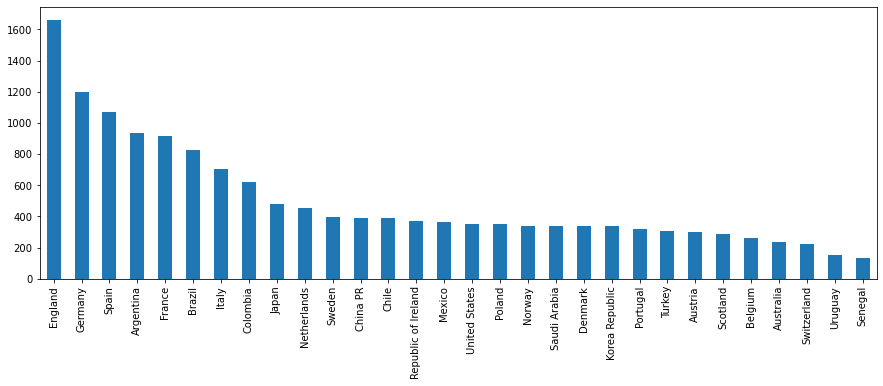

In [32]:
freq = data['nationality'].value_counts()[:30]
freq.plot(kind='bar', figsize=(15,5))

#### `England has maximum number of football players, the country who invented football`

In [33]:
data.club.isnull().sum()

241

In [34]:
# data.dropna('club',axis=0,inplace=True)

<AxesSubplot:>

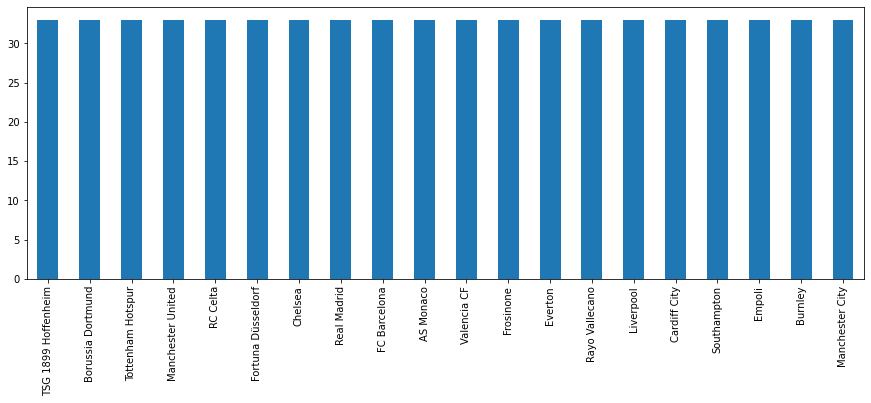

In [35]:
freq = data['club'].value_counts()[:20]
freq.plot(kind='bar', figsize=(15,5))

#### `Top 10 Football clubs, they had almost same number of players`

<AxesSubplot:xlabel='preferred_foot', ylabel='count'>

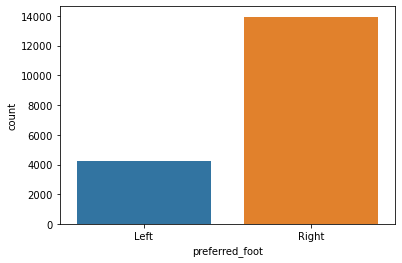

In [36]:
sns.countplot(data.preferred_foot)

#### `Most of the players preferred right foot`

In [37]:
data.body_type.value_counts()   # wierd values in some rows

Normal                 10595
Lean                    6417
Stocky                  1140
Messi                      1
C. Ronaldo                 1
Courtois                   1
Shaqiri                    1
Neymar                     1
Akinfenwa                  1
PLAYER_BODY_TYPE_25        1
Name: body_type, dtype: int64

In [38]:
data.loc[data['body_type'] == 'PLAYER_BODY_TYPE_25','body_type'] = np.NaN
data.loc[data['body_type'] == 'Courtois','body_type'] = np.NaN
data.loc[data['body_type'] == 'Shaqiri','body_type'] = np.NaN
data.loc[data['body_type'] == 'Neymar','body_type'] = np.NaN
data.loc[data['body_type'] == 'Messi','body_type'] = np.NaN
data.loc[data['body_type'] == 'C. Ronaldo','body_type'] = np.NaN
data.loc[data['body_type'] == 'Akinfenwa','body_type'] = np.NaN

In [39]:
data.body_type.value_counts()

Normal    10595
Lean       6417
Stocky     1140
Name: body_type, dtype: int64

<AxesSubplot:xlabel='body_type', ylabel='count'>

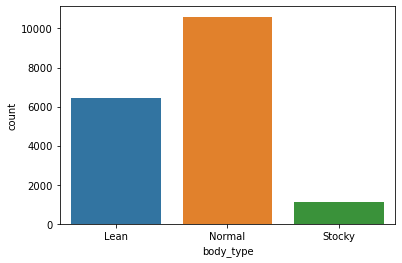

In [40]:
sns.countplot(data.body_type)

#### `Most of the players have normal body, but some players do have leaniness and stockiness`

<AxesSubplot:xlabel='work_rate', ylabel='count'>

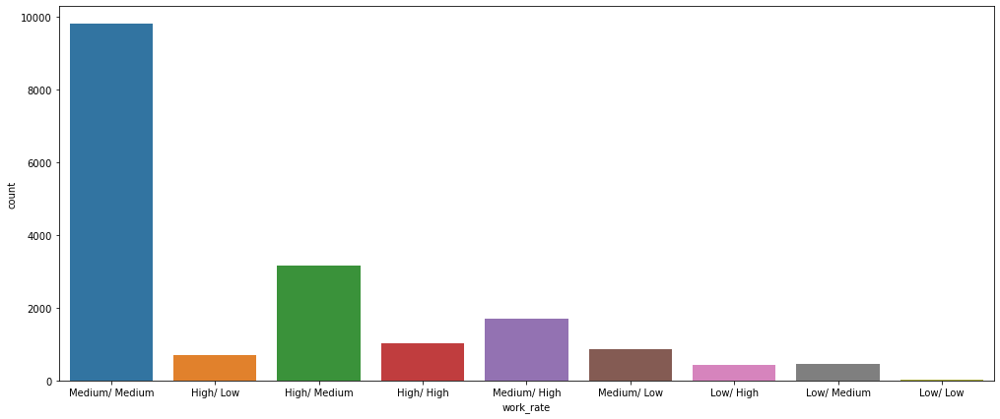

In [41]:
plt.figure(figsize=(17,7))
sns.countplot(data.work_rate)

#### In football, work rate refers to the extent to which a player contributes to running and chasing in a match while not in possession of the ball. Work rate is generally indicated by the distance covered by a player during a match.
#### `Most of the players have Medium/Medium work rate`

### `Positions`
- [Position](https://en.wikipedia.org/wiki/Association_football_positions#Centre-back)

<AxesSubplot:>

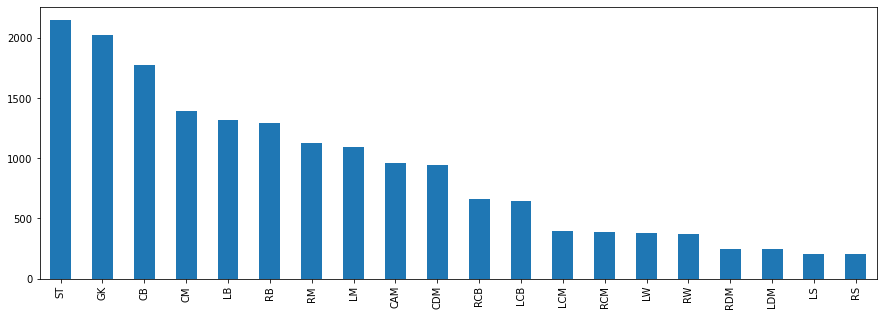

In [42]:
freq = data['position'].value_counts()[:20]
freq.plot(kind='bar', figsize=(15,5))

#### `Most of the players used to prefer defence and goalkeeepr positions`

### `Extracted only year from joined and contact `

In [43]:
import datetime as dt
data.joined = pd.to_datetime(data.joined)
data['date_joined'] = data.joined.dt.year

In [44]:
data.contract_valid_until = pd.to_datetime(data.contract_valid_until)
data['contract_valid_until'] = data.contract_valid_until.dt.year

<AxesSubplot:xlabel='date_joined', ylabel='count'>

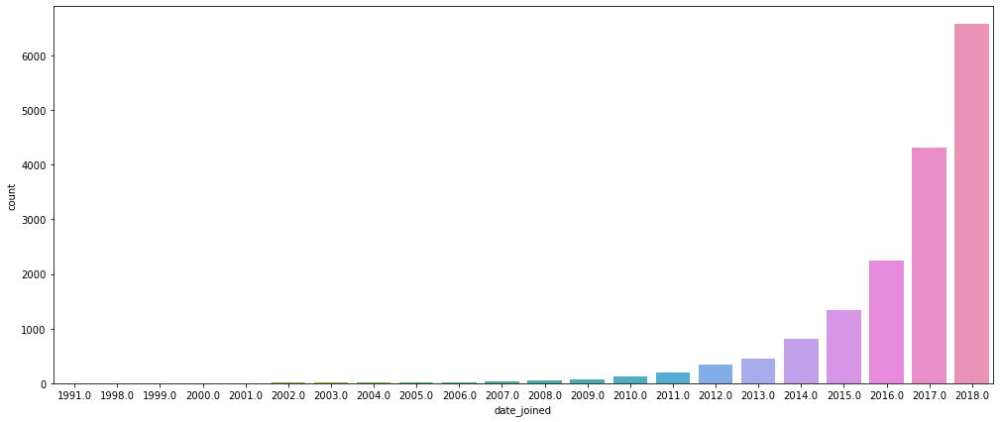

In [45]:
plt.figure(figsize=(17,7))
sns.countplot(data.date_joined)

#### `2018 is the year when most of the players have joined`

<AxesSubplot:xlabel='contract_valid_until', ylabel='count'>

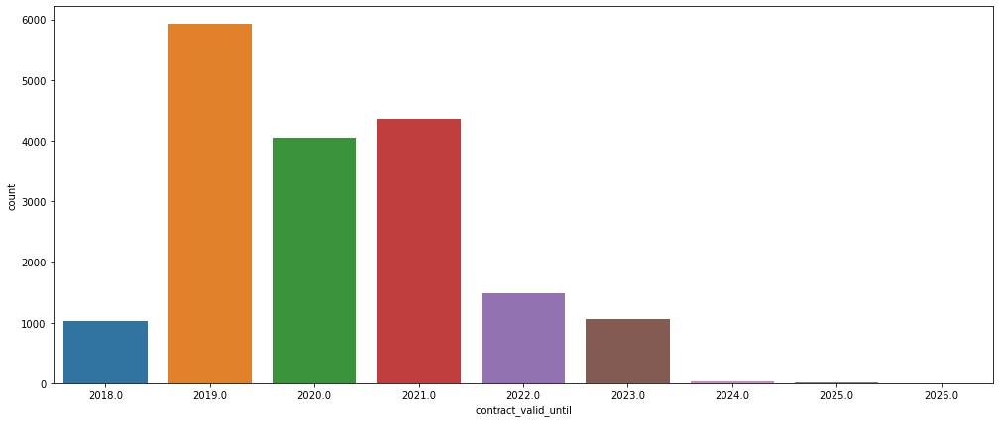

In [46]:
plt.figure(figsize=(17,7))
sns.countplot(data.contract_valid_until)

#### `Most of the players had contract till 2019, 2020, 2021`

<AxesSubplot:xlabel='age', ylabel='Density'>

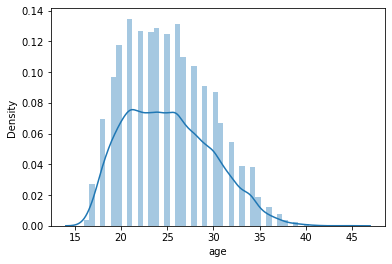

In [47]:
sns.distplot(data.age)

<AxesSubplot:xlabel='overall', ylabel='Density'>

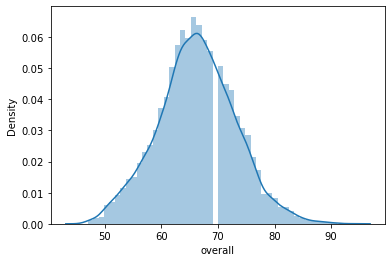

In [48]:
sns.distplot(data.overall)

<AxesSubplot:xlabel='potential', ylabel='Density'>

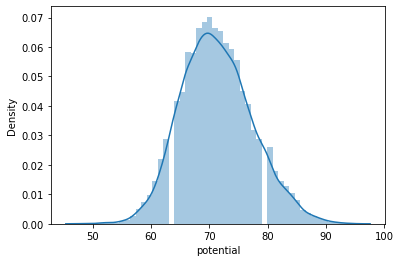

In [49]:
sns.distplot(data.potential)

<AxesSubplot:xlabel='value', ylabel='Density'>

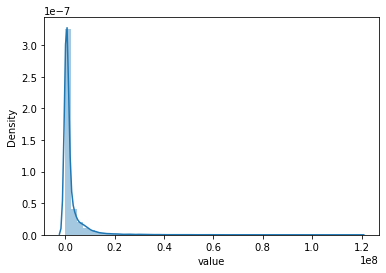

In [50]:
sns.distplot(data.value)

<AxesSubplot:xlabel='wage', ylabel='Density'>

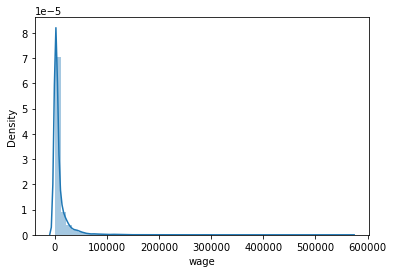

In [51]:
sns.distplot(data.wage)

<AxesSubplot:xlabel='special', ylabel='Density'>

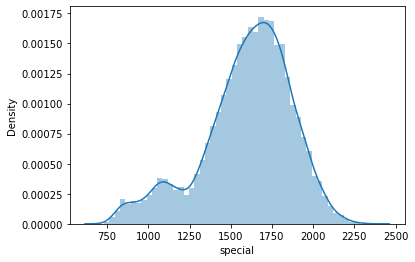

In [52]:
sns.distplot(data.special)

<AxesSubplot:xlabel='international_reputation', ylabel='count'>

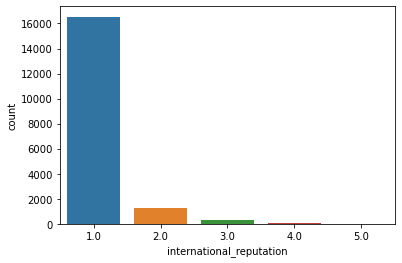

In [53]:
sns.countplot(data.international_reputation)

#### `Most of the players have international reputaion of 1`

<AxesSubplot:xlabel='weak_foot', ylabel='count'>

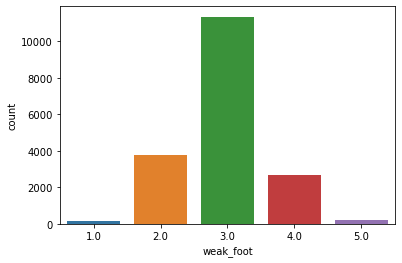

In [54]:
sns.countplot(data.weak_foot)

#### `Most o the players have weak foot rating of 3 out of 5`

<AxesSubplot:xlabel='skill_moves', ylabel='count'>

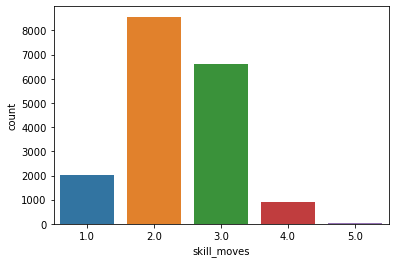

In [55]:
sns.countplot(data.skill_moves)

#### `Most of the players have skill moves rating of 2 out of 5`

<AxesSubplot:xlabel='height', ylabel='Density'>

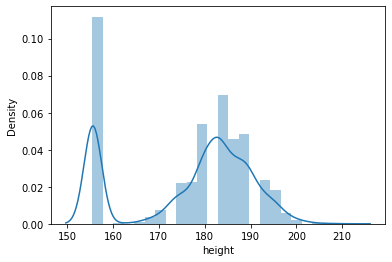

In [56]:
sns.distplot(data.height)

<AxesSubplot:xlabel='weight', ylabel='Density'>

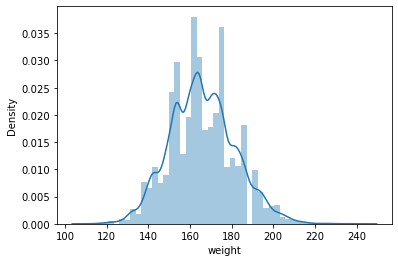

In [57]:
sns.distplot(data.weight)

# `Rating of players according to features`

### `Details of top 10 players with highest value`

In [58]:
data.sort_values(by='value',ascending=False)[:10]  

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
5,E. Hazard,27,Belgium,91,91,Chelsea,93000000.0,340000.0,2142,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,10.0,2012-07-01,2020.0,176.7840,163.0,81.0,84.0,61.0,89.0,80.0,95.0,83.0,79.0,83.0,94.0,94.0,88.0,95.0,90.0,94.0,82.0,56.0,83.0,66.0,80.0,54.0,41.0,87.0,89.0,86.0,91.0,34.0,27.0,22.0,11.0,12.0,6.0,8.0,8.0,172100000.0,2012.0
15,P. Dybala,24,Argentina,89,94,Juventus,89000000.0,205000.0,2092,Left,3.0,3.0,4.0,High/ Medium,Normal,Yes,LF,21.0,2015-07-01,2022.0,155.4480,165.0,82.0,84.0,68.0,87.0,88.0,92.0,88.0,88.0,75.0,92.0,87.0,83.0,91.0,86.0,85.0,82.0,75.0,80.0,65.0,88.0,48.0,32.0,84.0,87.0,86.0,84.0,23.0,20.0,20.0,5.0,4.0,4.0,5.0,8.0,153500000.0,2015.0
16,H. Kane,24,England,89,91,Tottenham Hotspur,83500000.0,205000.0,2165,Right,3.0,4.0,3.0,High/ High,Normal,Yes,ST,9.0,2010-07-01,2024.0,188.9760,196.0,75.0,94.0,85.0,80.0,84.0,80.0,78.0,68.0,82.0,84.0,68.0,72.0,71.0,91.0,71.0,88.0,78.0,89.0,84.0,85.0,76.0,35.0,93.0,80.0,90.0,89.0,56.0,36.0,38.0,8.0,10.0,11.0,14.0,11.0,160700000.0,2010.0
25,K. Mbappé,19,France,88,95,Paris Saint-Germain,81000000.0,100000.0,2118,Right,3.0,4.0,5.0,High/ Medium,Lean,Yes,RM,10.0,2018-07-01,2022.0,155.4480,161.0,77.0,88.0,77.0,82.0,78.0,90.0,77.0,63.0,73.0,91.0,96.0,96.0,92.0,87.0,83.0,79.0,75.0,83.0,71.0,78.0,62.0,38.0,88.0,82.0,70.0,86.0,34.0,34.0,32.0,13.0,5.0,7.0,11.0,6.0,166100000.0,2018.0
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.8800,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
17,A. Griezmann,27,France,89,90,Atlético Madrid,78000000.0,145000.0,2246,Left,4.0,3.0,4.0,High/ High,Lean,Yes,CAM,7.0,2014-07-28,2023.0,179.8320,161.0,82.0,90.0,84.0,83.0,87.0,88.0,84.0,78.0,76.0,90.0,88.0,85.0,90.0,90.0,80.0,80.0,90.0,83.0,62.0,82.0,69.0,35.0,91.0,83.0,79.0,87.0,59.0,47.0,48.0,14.0,8.0,14.0,13.0,14.0,165800000.0,2014.0
10,R. Lewandowski,29,Poland,90,90,FC Bayern München,77000000.0,205000.0,2152,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,ST,9.0,2014-07-01,2021.0,182.8800,176.0,62.0,91.0,85.0,83.0,89.0,85.0,77.0,86.0,65.0,89.0,77.0,78.0,78.0,90.0,78.0,88.0,84.0,78.0,84.0,84.0,80.0,39.0,91.0,77.0,88.0,86.0,34.0,42.0,19.0,15.0,6.0,12.0,8.0,10.0,127100000.0,2014.0


# `Neymar Jr is the most valued player`

### `Details of top 10 players with highest wage`

In [59]:
data.sort_values(by='wage',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.8800,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
6,L. Modrić,32,Croatia,91,91,Real Madrid,67000000.0,420000.0,2280,Right,4.0,4.0,4.0,High/ High,Lean,Yes,RCM,10.0,2012-08-01,2020.0,176.7840,146.0,86.0,72.0,55.0,93.0,76.0,90.0,85.0,78.0,88.0,93.0,80.0,72.0,93.0,90.0,94.0,79.0,68.0,89.0,58.0,82.0,62.0,83.0,79.0,92.0,82.0,84.0,60.0,76.0,73.0,13.0,9.0,7.0,14.0,9.0,137400000.0,2012.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
8,Sergio Ramos,32,Spain,91,91,Real Madrid,51000000.0,380000.0,2201,Right,4.0,3.0,3.0,High/ Medium,Normal,Yes,RCB,15.0,2005-08-01,2020.0,182.8800,181.0,66.0,60.0,91.0,78.0,66.0,63.0,74.0,72.0,77.0,84.0,76.0,75.0,78.0,85.0,66.0,79.0,93.0,84.0,83.0,59.0,88.0,90.0,60.0,63.0,75.0,82.0,87.0,92.0,91.0,11.0,8.0,9.0,7.0,11.0,104600000.0,2005.0
11,T. Kroos,28,Germany,90,90,Real Madrid,76500000.0,355000.0,2190,Right,4.0,5.0,3.0,Medium/ Medium,Normal,Yes,LCM,8.0,2014-07-17,2022.0,182.8800,168.0,88.0,76.0,54.0,92.0,82.0,81.0,86.0,84.0,93.0,90.0,64.0,62.0,70.0,89.0,71.0,87.0,30.0,75.0,73.0,92.0,60.0,82.0,79.0,86.0,73.0,85.0,72.0,79.0,69.0,10.0,11.0,13.0,7.0,10.0,156800000.0,2014.0
36,G. Bale,28,Wales,88,88,Real Madrid,60000000.0,355000.0,2279,Left,4.0,3.0,4.0,High/ Medium,Lean,Yes,ST,11.0,2013-09-02,2022.0,185.9280,181.0,87.0,86.0,84.0,85.0,85.0,87.0,90.0,87.0,80.0,85.0,94.0,95.0,82.0,85.0,65.0,92.0,87.0,75.0,80.0,91.0,65.0,59.0,85.0,79.0,76.0,86.0,54.0,55.0,52.0,15.0,15.0,11.0,5.0,6.0,123000000.0,2013.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
5,E. Hazard,27,Belgium,91,91,Chelsea,93000000.0,340000.0,2142,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,10.0,2012-07-01,2020.0,176.7840,163.0,81.0,84.0,61.0,89.0,80.0,95.0,83.0,79.0,83.0,94.0,94.0,88.0,95.0,90.0,94.0,82.0,56.0,83.0,66.0,80.0,54.0,41.0,87.0,89.0,86.0,91.0,34.0,27.0,22.0,11.0,12.0,6.0,8.0,8.0,172100000.0,2012.0
32,Coutinho,26,Brazil,88,89,FC Barcelona,69500000.0,340000.0,2175,Right,3.0,4.0,5.0,High/ High,Normal,Yes,LW,7.0,2018-01-06,2023.0,176.7840,150.0,79.0,79.0,48.0,88.0,75.0,91.0,91.0,86.0,83.0,92.0,89.0,75.0,92.0,83.0,93.0,83.0,59.0,79.0,61.0,93.0,59.0,49.0,84.0,90.0,70.0,85.0,55.0,54.0,47.0,12.0,7.0,9.0,14.0,6.0,147700000.0,2018.0


# `L. Messi is the player who gets the highest wage`

### `Details of top 10 players with highest release contract`

In [60]:
data.sort_values(by='release_clause',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
5,E. Hazard,27,Belgium,91,91,Chelsea,93000000.0,340000.0,2142,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,10.0,2012-07-01,2020.0,176.7840,163.0,81.0,84.0,61.0,89.0,80.0,95.0,83.0,79.0,83.0,94.0,94.0,88.0,95.0,90.0,94.0,82.0,56.0,83.0,66.0,80.0,54.0,41.0,87.0,89.0,86.0,91.0,34.0,27.0,22.0,11.0,12.0,6.0,8.0,8.0,172100000.0,2012.0
25,K. Mbappé,19,France,88,95,Paris Saint-Germain,81000000.0,100000.0,2118,Right,3.0,4.0,5.0,High/ Medium,Lean,Yes,RM,10.0,2018-07-01,2022.0,155.4480,161.0,77.0,88.0,77.0,82.0,78.0,90.0,77.0,63.0,73.0,91.0,96.0,96.0,92.0,87.0,83.0,79.0,75.0,83.0,71.0,78.0,62.0,38.0,88.0,82.0,70.0,86.0,34.0,34.0,32.0,13.0,5.0,7.0,11.0,6.0,166100000.0,2018.0
17,A. Griezmann,27,France,89,90,Atlético Madrid,78000000.0,145000.0,2246,Left,4.0,3.0,4.0,High/ High,Lean,Yes,CAM,7.0,2014-07-28,2023.0,179.8320,161.0,82.0,90.0,84.0,83.0,87.0,88.0,84.0,78.0,76.0,90.0,88.0,85.0,90.0,90.0,80.0,80.0,90.0,83.0,62.0,82.0,69.0,35.0,91.0,83.0,79.0,87.0,59.0,47.0,48.0,14.0,8.0,14.0,13.0,14.0,165800000.0,2014.0
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.8800,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
16,H. Kane,24,England,89,91,Tottenham Hotspur,83500000.0,205000.0,2165,Right,3.0,4.0,3.0,High/ High,Normal,Yes,ST,9.0,2010-07-01,2024.0,188.9760,196.0,75.0,94.0,85.0,80.0,84.0,80.0,78.0,68.0,82.0,84.0,68.0,72.0,71.0,91.0,71.0,88.0,78.0,89.0,84.0,85.0,76.0,35.0,93.0,80.0,90.0,89.0,56.0,36.0,38.0,8.0,10.0,11.0,14.0,11.0,160700000.0,2010.0
11,T. Kroos,28,Germany,90,90,Real Madrid,76500000.0,355000.0,2190,Right,4.0,5.0,3.0,Medium/ Medium,Normal,Yes,LCM,8.0,2014-07-17,2022.0,182.8800,168.0,88.0,76.0,54.0,92.0,82.0,81.0,86.0,84.0,93.0,90.0,64.0,62.0,70.0,89.0,71.0,87.0,30.0,75.0,73.0,92.0,60.0,82.0,79.0,86.0,73.0,85.0,72.0,79.0,69.0,10.0,11.0,13.0,7.0,10.0,156800000.0,2014.0
30,Isco,26,Spain,88,91,Real Madrid,73500000.0,315000.0,2137,Right,3.0,3.0,4.0,High/ Medium,Normal,Yes,LW,22.0,2013-07-03,2022.0,179.8320,174.0,75.0,79.0,55.0,89.0,65.0,94.0,88.0,76.0,83.0,95.0,75.0,69.0,87.0,77.0,90.0,69.0,64.0,70.0,59.0,87.0,58.0,64.0,78.0,89.0,76.0,86.0,60.0,64.0,51.0,10.0,8.0,12.0,15.0,6.0,156200000.0,2013.0


## `Naymar Jr` had 1st and `L.Messi` had 2nd highest `release clause` cost`

### `Details of top 10 highest players`

In [61]:
data.sort_values(by='height',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
11614,T. Holý,26,Czech Republic,64,68,Gillingham,400000.0,2000.0,1028,Right,1.0,3.0,1.0,Medium/ Medium,Normal,No,GK,1.0,2017-01-20,2019.0,210.312,225.0,13.0,18.0,18.0,18.0,20.0,16.0,20.0,14.0,29.0,19.0,34.0,33.0,35.0,53.0,41.0,26.0,48.0,19.0,60.0,16.0,21.0,15.0,9.0,30.0,23.0,43.0,16.0,25.0,25.0,68.0,58.0,57.0,63.0,68.0,730000.0,2017.0
17927,D. Hodzic,22,Croatia,51,61,Vejle Boldklub,50000.0,1000.0,793,Right,1.0,3.0,1.0,Medium/ Medium,Lean,No,GK,31.0,2017-07-27,2018.0,210.312,176.0,16.0,7.0,15.0,15.0,10.0,13.0,11.0,13.0,27.0,19.0,17.0,22.0,31.0,34.0,24.0,22.0,33.0,20.0,36.0,9.0,25.0,12.0,10.0,36.0,13.0,30.0,17.0,12.0,11.0,50.0,47.0,56.0,52.0,58.0,73000.0,2017.0
11903,K. Scherpen,18,Netherlands,64,78,FC Emmen,750000.0,1000.0,974,Right,1.0,5.0,1.0,Medium/ Medium,Normal,No,GK,12.0,2017-07-01,2020.0,207.264,187.0,11.0,9.0,10.0,26.0,8.0,12.0,12.0,13.0,25.0,17.0,37.0,46.0,37.0,60.0,42.0,19.0,42.0,37.0,69.0,8.0,25.0,7.0,8.0,31.0,12.0,51.0,14.0,11.0,10.0,64.0,63.0,61.0,63.0,65.0,1600000.0,2017.0
17694,M. Casey,18,England,53,73,Portsmouth,110000.0,1000.0,1194,Right,1.0,3.0,2.0,Medium/ Medium,Lean,No,CB,31.0,2017-12-09,2019.0,207.264,176.0,24.0,21.0,51.0,46.0,29.0,29.0,22.0,25.0,21.0,42.0,55.0,57.0,41.0,48.0,44.0,34.0,60.0,55.0,68.0,18.0,41.0,49.0,27.0,30.0,37.0,35.0,50.0,55.0,52.0,12.0,12.0,15.0,10.0,14.0,303000.0,2017.0
4189,V. Milinković-Savić,21,Serbia,71,79,SPAL,2600000.0,12000.0,1314,Right,1.0,3.0,1.0,Medium/ Medium,Normal,No,GK,32.0,NaT,2019.0,207.264,203.0,18.0,20.0,12.0,31.0,16.0,15.0,55.0,59.0,30.0,18.0,40.0,45.0,37.0,66.0,38.0,62.0,58.0,33.0,73.0,45.0,34.0,21.0,12.0,50.0,24.0,65.0,11.0,15.0,19.0,70.0,69.0,77.0,70.0,71.0,NaN,NaN
11403,A. Noppert,24,Netherlands,64,69,Foggia,425000.0,1000.0,1154,Right,1.0,3.0,1.0,Medium/ Medium,Lean,No,GK,22.0,2018-01-30,2023.0,207.264,207.0,14.0,19.0,19.0,20.0,19.0,19.0,41.0,14.0,39.0,20.0,45.0,50.0,40.0,60.0,60.0,41.0,66.0,42.0,66.0,20.0,21.0,16.0,15.0,16.0,19.0,54.0,10.0,15.0,13.0,66.0,61.0,62.0,65.0,61.0,712000.0,2018.0
9559,A. Vukotić,22,Serbia,66,72,Waasland-Beveren,750000.0,3000.0,1440,Left,1.0,3.0,2.0,Medium/ Medium,Normal,No,RCB,26.0,2018-07-01,2023.0,207.264,209.0,27.0,38.0,68.0,63.0,36.0,37.0,31.0,32.0,65.0,57.0,39.0,45.0,46.0,60.0,29.0,55.0,42.0,63.0,89.0,33.0,63.0,65.0,33.0,45.0,34.0,55.0,65.0,63.0,61.0,10.0,9.0,13.0,12.0,12.0,1200000.0,2018.0
4281,C. Pantilimon,31,Romania,71,71,Nottingham Forest,1400000.0,22000.0,1120,Right,1.0,2.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2018-07-03,2021.0,207.264,212.0,19.0,11.0,16.0,38.0,13.0,15.0,15.0,12.0,36.0,22.0,48.0,42.0,33.0,66.0,22.0,14.0,34.0,31.0,78.0,15.0,40.0,27.0,12.0,38.0,21.0,65.0,16.0,19.0,17.0,68.0,69.0,66.0,73.0,74.0,2700000.0,2018.0
14542,M. Qvist,25,Denmark,61,64,AC Horsens,325000.0,2000.0,1568,Left,1.0,2.0,2.0,Medium/ Medium,Normal,No,LCB,20.0,2017-01-01,2022.0,207.264,207.0,60.0,55.0,68.0,60.0,42.0,63.0,33.0,25.0,52.0,61.0,50.0,57.0,33.0,63.0,35.0,62.0,33.0,73.0,85.0,28.0,68.0,54.0,63.0,61.0,35.0,50.0,58.0,62.0,60.0,15.0,14.0,12.0,14.0,14.0,431000.0,2017.0
12494,A. Chapman,28,England,63,63,Peterborough United,260000.0,2000.0,983,Right,1.0,1.0,1.0,Medium/ Medium,Normal,No,GK,1.0,2018-07-01,2020.0,207.264,203.0,13.0,11.0,13.0,18.0,8.0,12.0,13.0,14.0,16.0,17.0,31.0,32.0,30.0,52.0,52.0,23.0,58.0,38.0,61.0,9.0,28.0,9.0,10.0,38.0,23.0,46.0,21.0,12.0,13.0,66.0,60.0,55.0,62.0,65.0,455000.0,2018.0


## `A. Akinfenwa of England is the hishest football player`

### `Details of top 10 heaviest players`

In [62]:
data.sort_values(by='weight',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
9501,A. Akinfenwa,36,England,66,66,Wycombe Wanderers,230000.0,2000.0,1586,Right,1.0,3.0,2.0,Low/ Low,NaN,Yes,LS,20.0,2016-07-10,2019.0,155.448,243.0,39.0,66.0,71.0,59.0,59.0,52.0,50.0,42.0,47.0,69.0,38.0,49.0,35.0,61.0,71.0,70.0,49.0,77.0,97.0,54.0,66.0,17.0,71.0,62.0,66.0,70.0,27.0,40.0,24.0,14.0,7.0,15.0,6.0,16.0,403000.0,2016.0
13520,L. Watkowiak,22,Germany,62,68,SV Wehen Wiesbaden,300000.0,1000.0,868,Right,1.0,3.0,1.0,Medium/ Medium,Stocky,No,GK,25.0,2017-07-01,2019.0,201.168,236.0,13.0,7.0,13.0,19.0,5.0,10.0,11.0,12.0,25.0,18.0,20.0,23.0,18.0,52.0,19.0,21.0,27.0,26.0,83.0,8.0,32.0,6.0,6.0,32.0,15.0,21.0,7.0,13.0,13.0,65.0,59.0,64.0,60.0,66.0,495000.0,2017.0
8652,C. Seitz,31,United States,67,67,Houston Dynamo,475000.0,2000.0,1103,Right,1.0,3.0,1.0,Medium/ Medium,Normal,No,GK,18.0,2018-02-07,2021.0,192.024,236.0,15.0,14.0,13.0,35.0,12.0,11.0,16.0,14.0,33.0,9.0,57.0,48.0,28.0,61.0,21.0,19.0,54.0,44.0,84.0,14.0,35.0,21.0,13.0,41.0,18.0,49.0,18.0,10.0,10.0,67.0,61.0,71.0,69.0,67.0,713000.0,2018.0
15179,M. Rhead,34,England,60,60,Lincoln City,110000.0,3000.0,1458,Right,1.0,2.0,2.0,Medium/ Medium,Stocky,No,ST,9.0,2015-07-01,2019.0,195.072,234.0,31.0,57.0,74.0,61.0,57.0,45.0,38.0,32.0,38.0,62.0,22.0,31.0,39.0,57.0,47.0,63.0,70.0,54.0,94.0,56.0,77.0,26.0,62.0,60.0,67.0,57.0,35.0,22.0,28.0,9.0,8.0,12.0,10.0,14.0,193000.0,2015.0
8908,F. Farnolle,33,Benin,66,66,Yeni Malatyaspor,325000.0,3000.0,1045,Right,1.0,2.0,1.0,Medium/ Medium,Stocky,No,GK,30.0,2017-07-01,2019.0,198.120,229.0,18.0,10.0,12.0,29.0,11.0,9.0,12.0,15.0,23.0,18.0,39.0,45.0,27.0,66.0,21.0,16.0,62.0,35.0,82.0,10.0,39.0,24.0,15.0,21.0,18.0,38.0,11.0,17.0,14.0,67.0,64.0,65.0,66.0,64.0,650000.0,2017.0
1426,L. Unnerstall,27,Germany,76,78,VVV-Venlo,6000000.0,12000.0,1061,Right,1.0,1.0,1.0,Medium/ Medium,Stocky,No,GK,1.0,NaT,2019.0,201.168,227.0,10.0,13.0,10.0,26.0,15.0,16.0,13.0,11.0,24.0,19.0,28.0,37.0,19.0,72.0,20.0,14.0,40.0,35.0,82.0,12.0,36.0,21.0,13.0,42.0,16.0,58.0,11.0,17.0,15.0,76.0,75.0,72.0,74.0,77.0,NaN,NaN
11894,D. Telgenkamp,31,Netherlands,64,64,FC Emmen,270000.0,1000.0,963,Right,1.0,2.0,1.0,Medium/ Medium,Stocky,No,GK,26.0,2015-07-13,2019.0,195.072,227.0,15.0,11.0,11.0,22.0,11.0,11.0,17.0,17.0,25.0,22.0,34.0,33.0,39.0,50.0,32.0,15.0,42.0,29.0,75.0,11.0,18.0,10.0,11.0,31.0,20.0,50.0,11.0,11.0,11.0,68.0,63.0,60.0,62.0,65.0,392000.0,2015.0
15491,E. Louro,22,United States,59,67,New York Red Bulls,170000.0,1000.0,998,Right,1.0,2.0,1.0,Medium/ Medium,Stocky,No,GK,24.0,2017-01-23,2018.0,192.024,225.0,12.0,15.0,13.0,20.0,16.0,11.0,14.0,15.0,21.0,17.0,34.0,36.0,44.0,46.0,33.0,15.0,53.0,36.0,78.0,16.0,16.0,21.0,13.0,46.0,15.0,44.0,20.0,12.0,10.0,59.0,57.0,62.0,63.0,59.0,289000.0,2017.0
11614,T. Holý,26,Czech Republic,64,68,Gillingham,400000.0,2000.0,1028,Right,1.0,3.0,1.0,Medium/ Medium,Normal,No,GK,1.0,2017-01-20,2019.0,210.312,225.0,13.0,18.0,18.0,18.0,20.0,16.0,20.0,14.0,29.0,19.0,34.0,33.0,35.0,53.0,41.0,26.0,48.0,19.0,60.0,16.0,21.0,15.0,9.0,30.0,23.0,43.0,16.0,25.0,25.0,68.0,58.0,57.0,63.0,68.0,730000.0,2017.0
2805,B. Hamid,27,United States,73,76,DC United,3400000.0,14000.0,1147,Right,1.0,2.0,1.0,Medium/ Medium,Stocky,No,GK,24.0,NaT,2019.0,192.024,225.0,15.0,12.0,11.0,35.0,14.0,11.0,15.0,12.0,26.0,20.0,42.0,41.0,34.0,66.0,46.0,18.0,68.0,25.0,75.0,20.0,31.0,19.0,15.0,43.0,23.0,32.0,19.0,18.0,12.0,74.0,70.0,70.0,73.0,74.0,NaN,NaN


## `A. Akinfenwa of England is also the heaviest football player`

In [63]:
data.sort_values(by='age',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
4741,O. Pérez,45,Mexico,71,71,Pachuca,160000.0,8000.0,1256,Right,2.0,3.0,1.0,Medium/ Medium,Stocky,No,GK,21.0,1991-06-01,2021.0,176.7840,165.0,19.0,14.0,24.0,26.0,13.0,12.0,12.0,20.0,27.0,23.0,60.0,57.0,69.0,72.0,69.0,24.0,85.0,41.0,66.0,18.0,26.0,12.0,12.0,40.0,23.0,62.0,23.0,12.0,11.0,70.0,64.0,65.0,73.0,74.0,272000.0,1991.0
18183,K. Pilkington,44,England,48,48,Cambridge United,0.0,1000.0,774,Right,1.0,2.0,1.0,Medium/ Medium,Normal,No,GK,44.0,2018-08-17,2023.0,188.9760,190.0,11.0,12.0,12.0,18.0,11.0,11.0,12.0,13.0,13.0,16.0,15.0,17.0,31.0,48.0,31.0,23.0,45.0,22.0,44.0,12.0,24.0,15.0,10.0,11.0,22.0,56.0,15.0,15.0,13.0,45.0,48.0,44.0,49.0,46.0,NaN,2018.0
17726,T. Warner,44,Trinidad & Tobago,53,53,Accrington Stanley,0.0,1000.0,926,Right,1.0,2.0,1.0,Medium/ Medium,Normal,No,GK,34.0,2018-08-03,2019.0,195.0720,185.0,19.0,13.0,15.0,24.0,15.0,14.0,14.0,12.0,24.0,27.0,23.0,21.0,27.0,47.0,38.0,36.0,43.0,25.0,58.0,20.0,31.0,15.0,15.0,21.0,17.0,46.0,19.0,15.0,14.0,48.0,56.0,56.0,60.0,44.0,NaN,2018.0
10545,S. Narazaki,42,Japan,65,65,Nagoya Grampus,40000.0,1000.0,1296,Right,2.0,3.0,1.0,Medium/ Medium,Normal,No,GK,1.0,1999-01-01,2021.0,188.9760,176.0,23.0,11.0,23.0,29.0,19.0,30.0,22.0,40.0,28.0,30.0,52.0,56.0,55.0,65.0,62.0,40.0,65.0,40.0,65.0,18.0,30.0,14.0,12.0,64.0,11.0,45.0,27.0,24.0,22.0,64.0,63.0,62.0,67.0,63.0,50000.0,1999.0
7225,C. Muñoz,41,Argentina,68,68,CD Universidad de Concepción,60000.0,1000.0,1234,Right,1.0,3.0,1.0,Medium/ Medium,Normal,No,GK,1.0,2013-01-01,2018.0,155.4480,161.0,25.0,15.0,13.0,36.0,12.0,22.0,19.0,20.0,34.0,31.0,53.0,56.0,33.0,62.0,58.0,23.0,73.0,29.0,65.0,20.0,35.0,25.0,16.0,45.0,24.0,62.0,18.0,14.0,19.0,67.0,65.0,68.0,71.0,68.0,84000.0,2013.0
1120,J. Villar,41,Paraguay,77,77,NaN,0.0,0.0,1168,Right,2.0,3.0,1.0,Medium/ Medium,Normal,No,GK,1.0,NaT,NaN,155.7528,187.0,14.0,12.0,12.0,30.0,8.0,21.0,15.0,22.0,22.0,24.0,31.0,32.0,50.0,73.0,68.0,29.0,56.0,22.0,62.0,16.0,22.0,22.0,14.0,51.0,21.0,55.0,13.0,13.0,14.0,75.0,75.0,74.0,78.0,77.0,NaN,NaN
12192,H. Sulaimani,41,Saudi Arabia,63,63,Ohod Club,0.0,3000.0,1842,Left,1.0,3.0,3.0,High/ Medium,Lean,No,LB,24.0,2018-06-11,2019.0,176.7840,154.0,71.0,43.0,61.0,67.0,43.0,63.0,69.0,69.0,70.0,64.0,48.0,52.0,67.0,63.0,68.0,65.0,69.0,49.0,72.0,63.0,92.0,65.0,64.0,69.0,60.0,67.0,62.0,66.0,63.0,15.0,8.0,15.0,14.0,13.0,NaN,2018.0
15426,M. Tyler,41,England,59,59,Peterborough United,10000.0,1000.0,1031,Right,1.0,3.0,1.0,Medium/ Medium,Normal,No,GK,40.0,2016-03-08,2019.0,182.8800,183.0,19.0,8.0,19.0,26.0,15.0,17.0,18.0,10.0,25.0,23.0,21.0,41.0,48.0,54.0,46.0,23.0,54.0,30.0,54.0,16.0,39.0,19.0,17.0,38.0,7.0,57.0,24.0,16.0,17.0,61.0,54.0,54.0,63.0,55.0,18000.0,2016.0
4228,B. Nivet,41,France,71,71,ESTAC Troyes,0.0,5000.0,1785,Right,2.0,3.0,3.0,Medium/ Medium,Normal,No,CAM,10.0,2012-07-01,2019.0,155.4480,165.0,67.0,69.0,58.0,75.0,67.0,68.0,73.0,71.0,72.0,76.0,39.0,40.0,59.0,70.0,67.0,75.0,30.0,41.0,56.0,72.0,58.0,54.0,65.0,83.0,76.0,82.0,58.0,56.0,43.0,11.0,7.0,8.0,14.0,7.0,NaN,2012.0
10356,F. Kippe,40,Norway,65,65,Lillestrøm SK,0.0,1000.0,1468,Left,1.0,3.0,2.0,Low/ Medium,Normal,No,LCB,13.0,2002-02-22,2019.0,195.0720,214.0,33.0,46.0,70.0,56.0,43.0,24.0,51.0,53.0,55.0,49.0,24.0,25.0,27.0,66.0,31.0,70.0,44.0,41.0,93.0,52.0,76.0,63.0,40.0,49.0,62.0,64.0,62.0,58.0,55.0,14.0,9.0,10.0,6.0,11.0,NaN,2002.0


## `O. Perez of Mexico is the eldest football player`

In [64]:
data.sort_values(by='age')[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
18206,G. Nugent,16,England,46,66,Tranmere Rovers,60000.0,1000.0,1321,Right,1.0,3.0,2.0,Medium/ Medium,Lean,No,CM,33.0,2018-10-30,2019.0,155.448,176.0,41.0,34.0,46.0,48.0,30.0,43.0,40.0,34.0,44.0,51.0,57.0,55.0,55.0,51.0,63.0,43.0,62.0,47.0,60.0,32.0,56.0,42.0,34.0,49.0,33.0,43.0,40.0,43.0,50.0,10.0,15.0,9.0,12.0,9.0,165000.0,2018.0
17743,J. Olstad,16,Norway,52,69,Sarpsborg 08 FF,100000.0,1000.0,1308,Right,1.0,3.0,2.0,Medium/ Medium,Lean,No,ST,25.0,2017-11-08,2019.0,176.784,150.0,28.0,53.0,49.0,48.0,41.0,51.0,36.0,31.0,31.0,53.0,70.0,68.0,75.0,47.0,78.0,44.0,72.0,50.0,42.0,45.0,35.0,10.0,53.0,49.0,54.0,42.0,13.0,19.0,20.0,7.0,8.0,9.0,11.0,8.0,188000.0,2017.0
13293,H. Massengo,16,France,62,75,AS Monaco,450000.0,2000.0,1651,Right,1.0,3.0,2.0,Medium/ Medium,Lean,No,CDM,42.0,2018-07-01,2021.0,155.448,146.0,52.0,39.0,60.0,66.0,39.0,53.0,46.0,44.0,61.0,58.0,62.0,62.0,59.0,60.0,74.0,58.0,61.0,62.0,61.0,52.0,64.0,62.0,56.0,52.0,51.0,50.0,52.0,62.0,65.0,8.0,14.0,12.0,9.0,15.0,1100000.0,2018.0
16081,J. Italiano,16,Australia,58,79,Perth Glory,280000.0,1000.0,1434,Right,1.0,2.0,3.0,High/ Medium,Lean,No,LM,26.0,2017-10-15,2019.0,173.736,143.0,43.0,50.0,36.0,61.0,35.0,59.0,41.0,36.0,57.0,56.0,80.0,72.0,72.0,53.0,79.0,54.0,58.0,57.0,42.0,33.0,38.0,22.0,53.0,52.0,40.0,57.0,36.0,38.0,43.0,7.0,7.0,9.0,10.0,5.0,630000.0,2017.0
18166,N. Ayéva,16,Sweden,48,72,Örebro SK,70000.0,1000.0,1286,Right,1.0,3.0,2.0,Medium/ Medium,Normal,No,ST,23.0,2018-05-18,2020.0,155.448,154.0,34.0,47.0,42.0,43.0,40.0,50.0,45.0,32.0,30.0,46.0,65.0,66.0,63.0,45.0,74.0,45.0,81.0,58.0,52.0,43.0,26.0,18.0,42.0,50.0,60.0,44.0,14.0,19.0,16.0,10.0,9.0,8.0,7.0,6.0,158000.0,2018.0
17712,K. Broda,16,Poland,53,74,Wisła Kraków,110000.0,1000.0,784,Right,1.0,2.0,1.0,Medium/ Medium,Normal,No,GK,48.0,2017-08-18,2021.0,192.024,187.0,11.0,8.0,13.0,29.0,7.0,6.0,11.0,14.0,15.0,14.0,20.0,31.0,32.0,40.0,29.0,20.0,37.0,17.0,56.0,5.0,21.0,7.0,4.0,26.0,14.0,37.0,8.0,11.0,12.0,59.0,51.0,53.0,45.0,58.0,259000.0,2017.0
17354,L. D'Arrigo,16,Australia,54,71,Adelaide United,130000.0,1000.0,1344,Right,1.0,3.0,2.0,Medium/ Medium,Lean,No,CAM,27.0,2018-07-24,2019.0,179.832,154.0,34.0,40.0,48.0,55.0,32.0,53.0,31.0,35.0,52.0,56.0,65.0,61.0,60.0,54.0,68.0,49.0,55.0,60.0,35.0,29.0,49.0,37.0,52.0,53.0,41.0,41.0,20.0,35.0,34.0,5.0,10.0,12.0,15.0,9.0,244000.0,2018.0
13567,Y. Verschaeren,16,Belgium,62,83,RSC Anderlecht,650000.0,1000.0,1588,Right,1.0,3.0,3.0,Medium/ Medium,Normal,No,CAM,51.0,2017-07-17,2021.0,176.784,139.0,48.0,54.0,39.0,64.0,51.0,68.0,51.0,48.0,56.0,70.0,79.0,73.0,83.0,39.0,87.0,53.0,73.0,61.0,51.0,54.0,38.0,31.0,57.0,53.0,49.0,50.0,35.0,38.0,35.0,15.0,6.0,12.0,10.0,7.0,1600000.0,2017.0
16927,B. Nygren,16,Sweden,56,73,IFK Göteborg,180000.0,1000.0,1329,Left,1.0,3.0,2.0,Medium/ Medium,Normal,No,ST,14.0,2018-05-23,2020.0,182.880,161.0,38.0,60.0,52.0,48.0,35.0,47.0,37.0,30.0,36.0,55.0,66.0,63.0,60.0,48.0,61.0,52.0,68.0,61.0,61.0,48.0,32.0,14.0,57.0,48.0,58.0,43.0,18.0,16.0,18.0,6.0,10.0,6.0,12.0,8.0,338000.0,2018.0
18018,B. O'Gorman,16,Republic of Ireland,50,69,Bray Wanderers,60000.0,1000.0,1261,Right,1.0,3.0,2.0,Medium/ Medium,Normal,No,RM,26.0,2018-05-25,2018.0,179.832,161.0,42.0,48.0,47.0,46.0,35.0,47.0,31.0,31.0,44.0,47.0,70.0,74.0,61.0,42.0,64.0,49.0,38.0,46.0,39.0,39.0,44.0,19.0,48.0,44.0,50.0,46.0,28.0,18.0,14.0,14.0,15.0,12.0,10.0,5.0,131000.0,2018.0


## `G. Nugent of England is the youngest football player`

In [65]:
data.sort_values(by='international_reputation',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.736,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.832,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
109,Z. Ibrahimović,36,Sweden,85,85,LA Galaxy,14000000.0,15000.0,2012,Right,5.0,4.0,5.0,Medium/ Low,Normal,Yes,RS,9.0,2018-03-23,2022.0,198.120,209.0,73.0,86.0,83.0,79.0,86.0,79.0,82.0,82.0,73.0,84.0,58.0,59.0,75.0,82.0,39.0,90.0,68.0,61.0,86.0,82.0,84.0,20.0,85.0,79.0,89.0,90.0,28.0,37.0,24.0,13.0,15.0,10.0,9.0,12.0,21000000.0,2018.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.976,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.880,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
22,M. Neuer,32,Germany,89,89,FC Bayern München,38000000.0,130000.0,1473,Right,5.0,4.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2011-07-01,2021.0,195.072,203.0,15.0,13.0,25.0,55.0,11.0,30.0,14.0,11.0,59.0,48.0,54.0,60.0,51.0,84.0,35.0,25.0,77.0,43.0,80.0,16.0,29.0,30.0,12.0,70.0,47.0,70.0,17.0,10.0,11.0,90.0,86.0,91.0,87.0,87.0,62700000.0,2011.0
39,Thiago Silva,33,Brazil,88,88,Paris Saint-Germain,24000000.0,165000.0,2077,Right,4.0,3.0,2.0,Medium/ High,Normal,Yes,RCB,2.0,2012-07-01,2020.0,182.880,181.0,60.0,38.0,81.0,80.0,63.0,62.0,61.0,64.0,80.0,80.0,70.0,72.0,68.0,82.0,68.0,71.0,90.0,74.0,82.0,68.0,76.0,89.0,59.0,72.0,60.0,81.0,88.0,89.0,85.0,9.0,12.0,5.0,9.0,10.0,44400000.0,2012.0
317,P. Čech,36,Czech Republic,82,82,Arsenal,3000000.0,60000.0,1166,Left,4.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2015-06-29,2019.0,198.120,198.0,19.0,12.0,19.0,35.0,17.0,12.0,13.0,19.0,33.0,22.0,35.0,38.0,46.0,77.0,34.0,21.0,50.0,32.0,63.0,11.0,17.0,23.0,13.0,53.0,23.0,63.0,12.0,13.0,12.0,78.0,82.0,70.0,83.0,79.0,5700000.0,2015.0
41,G. Buffon,40,Italy,88,88,Paris Saint-Germain,4000000.0,77000.0,1334,Right,4.0,2.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2018-07-06,2019.0,195.072,203.0,13.0,15.0,13.0,37.0,17.0,26.0,20.0,13.0,35.0,28.0,49.0,43.0,55.0,79.0,49.0,39.0,75.0,39.0,69.0,13.0,38.0,28.0,12.0,50.0,22.0,70.0,13.0,11.0,11.0,88.0,87.0,74.0,90.0,83.0,7400000.0,2018.0
280,M. Götze,26,Germany,82,85,Borussia Dortmund,27000000.0,67000.0,2101,Right,4.0,4.0,4.0,Medium/ Medium,Normal,Yes,CM,10.0,2016-08-01,2020.0,179.832,165.0,78.0,75.0,51.0,87.0,86.0,84.0,81.0,72.0,82.0,90.0,74.0,64.0,86.0,84.0,85.0,68.0,58.0,73.0,68.0,66.0,58.0,65.0,81.0,86.0,77.0,85.0,63.0,53.0,57.0,14.0,7.0,12.0,6.0,10.0,47900000.0,2016.0


## `L. Messi`, `Neymar Jr`, `Z. Ibrahimović`, `Cristiano Ronaldo`, `L. Suárez`,  `M. Neuer` are the most reputed football players

In [66]:
data.sort_values(by='crossing',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
153,Quaresma,34,Portugal,84,84,Beşiktaş JK,15500000.0,80000.0,1988,Right,3.0,4.0,5.0,High/ Low,Normal,Yes,RM,7.0,2015-07-22,2020.0,179.8320,148.0,92.0,67.0,41.0,79.0,80.0,89.0,94.0,73.0,75.0,88.0,84.0,82.0,91.0,78.0,84.0,79.0,63.0,65.0,55.0,80.0,74.0,24.0,78.0,84.0,74.0,80.0,29.0,17.0,13.0,12.0,14.0,10.0,5.0,15.0,29500000.0,2015.0
390,Pedro León,31,Spain,81,81,SD Eibar,15500000.0,32000.0,1980,Right,2.0,3.0,4.0,Medium/ Low,Normal,Yes,RM,21.0,2016-07-05,2020.0,182.8800,161.0,91.0,76.0,36.0,83.0,68.0,84.0,87.0,85.0,85.0,85.0,63.0,63.0,68.0,76.0,73.0,84.0,39.0,65.0,63.0,80.0,55.0,43.0,79.0,82.0,71.0,71.0,50.0,46.0,36.0,11.0,12.0,10.0,15.0,16.0,32600000.0,2016.0
290,K. Trippier,27,England,82,82,Tottenham Hotspur,18500000.0,99000.0,2161,Right,2.0,4.0,3.0,High/ High,Normal,Yes,RB,12.0,2015-06-19,2022.0,155.4480,159.0,91.0,48.0,73.0,79.0,54.0,75.0,87.0,83.0,78.0,80.0,76.0,75.0,74.0,81.0,74.0,75.0,73.0,88.0,65.0,70.0,70.0,79.0,75.0,80.0,66.0,73.0,77.0,82.0,79.0,11.0,14.0,8.0,11.0,10.0,34200000.0,2015.0
291,A. Kolarov,32,Serbia,82,82,Roma,12500000.0,73000.0,2230,Left,2.0,3.0,3.0,High/ Medium,Normal,Yes,LB,11.0,2017-07-22,2020.0,188.9760,183.0,91.0,55.0,80.0,77.0,64.0,79.0,85.0,86.0,77.0,76.0,73.0,70.0,63.0,84.0,58.0,91.0,80.0,84.0,77.0,83.0,85.0,81.0,75.0,77.0,74.0,88.0,81.0,82.0,81.0,16.0,15.0,8.0,16.0,6.0,21300000.0,2017.0
797,P. Max,24,Germany,78,81,FC Augsburg,11000000.0,22000.0,2007,Left,1.0,3.0,3.0,High/ Medium,Normal,No,LWB,31.0,2015-08-04,2022.0,155.4480,170.0,91.0,40.0,59.0,77.0,43.0,73.0,80.0,74.0,72.0,78.0,78.0,85.0,77.0,79.0,74.0,75.0,66.0,85.0,66.0,46.0,72.0,69.0,62.0,70.0,41.0,71.0,69.0,74.0,75.0,15.0,12.0,11.0,8.0,11.0,19500000.0,2015.0
35,Marcelo,30,Brazil,88,88,Real Madrid,43000000.0,285000.0,2279,Left,4.0,4.0,5.0,High/ Low,Normal,Yes,LB,12.0,2007-01-01,2022.0,179.8320,176.0,90.0,70.0,75.0,84.0,54.0,90.0,85.0,67.0,76.0,92.0,83.0,82.0,86.0,88.0,86.0,83.0,76.0,91.0,78.0,70.0,84.0,85.0,85.0,82.0,59.0,86.0,71.0,85.0,86.0,12.0,5.0,5.0,5.0,9.0,88200000.0,2007.0
28,J. Rodríguez,26,Colombia,88,89,FC Bayern München,69500000.0,315000.0,2171,Left,4.0,3.0,4.0,Medium/ Medium,Normal,Yes,LAM,10.0,NaT,2019.0,155.7528,172.0,90.0,83.0,62.0,89.0,90.0,85.0,89.0,86.0,83.0,90.0,73.0,67.0,83.0,85.0,76.0,86.0,54.0,70.0,68.0,92.0,64.0,55.0,80.0,89.0,81.0,87.0,52.0,41.0,44.0,15.0,15.0,15.0,5.0,14.0,NaN,NaN
82,J. Kimmich,23,Germany,85,88,FC Bayern München,40500000.0,92000.0,2185,Right,3.0,4.0,3.0,High/ Low,Lean,Yes,RCM,18.0,2015-07-01,2023.0,179.8320,154.0,90.0,66.0,74.0,85.0,61.0,80.0,81.0,61.0,80.0,85.0,78.0,68.0,84.0,85.0,83.0,75.0,79.0,85.0,65.0,69.0,74.0,79.0,80.0,79.0,44.0,82.0,75.0,81.0,79.0,8.0,15.0,7.0,15.0,15.0,69900000.0,2015.0
112,Alex Telles,25,Brazil,84,87,FC Porto,32000000.0,22000.0,2259,Left,3.0,2.0,3.0,High/ Medium,Lean,Yes,LB,13.0,2016-07-13,2021.0,155.7528,157.0,89.0,65.0,74.0,83.0,67.0,82.0,87.0,79.0,86.0,82.0,84.0,85.0,73.0,83.0,70.0,80.0,81.0,92.0,68.0,75.0,78.0,80.0,76.0,74.0,68.0,80.0,80.0,81.0,79.0,13.0,8.0,12.0,11.0,14.0,66400000.0,2016.0


### A cross is a medium-to-long-range pass from a wide area of the field towards the centre of the field near the opponent's goal
### `K. De Bruyne had the highest rating in crossing`

In [67]:
data.sort_values(by='finishing',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
16,H. Kane,24,England,89,91,Tottenham Hotspur,83500000.0,205000.0,2165,Right,3.0,4.0,3.0,High/ High,Normal,Yes,ST,9.0,2010-07-01,2024.0,188.9760,196.0,75.0,94.0,85.0,80.0,84.0,80.0,78.0,68.0,82.0,84.0,68.0,72.0,71.0,91.0,71.0,88.0,78.0,89.0,84.0,85.0,76.0,35.0,93.0,80.0,90.0,89.0,56.0,36.0,38.0,8.0,10.0,11.0,14.0,11.0,160700000.0,2010.0
23,S. Agüero,30,Argentina,89,89,Manchester City,64500000.0,300000.0,2107,Right,4.0,4.0,4.0,High/ Medium,Stocky,Yes,ST,10.0,2011-07-28,2021.0,176.7840,154.0,70.0,93.0,77.0,81.0,85.0,89.0,82.0,73.0,64.0,89.0,88.0,80.0,86.0,90.0,91.0,88.0,81.0,76.0,73.0,83.0,65.0,24.0,92.0,83.0,83.0,90.0,30.0,20.0,12.0,13.0,15.0,6.0,11.0,14.0,119300000.0,2011.0
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.8800,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
38,G. Higuaín,30,Argentina,88,88,Milan,57000000.0,245000.0,1965,Right,4.0,4.0,3.0,High/ Medium,Normal,Yes,LS,9.0,NaT,2019.0,185.9280,196.0,68.0,92.0,80.0,75.0,90.0,84.0,74.0,62.0,59.0,85.0,73.0,73.0,75.0,86.0,69.0,86.0,79.0,70.0,85.0,80.0,50.0,20.0,92.0,74.0,70.0,86.0,35.0,22.0,18.0,5.0,12.0,7.0,5.0,10.0,NaN,NaN
10,R. Lewandowski,29,Poland,90,90,FC Bayern München,77000000.0,205000.0,2152,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,ST,9.0,2014-07-01,2021.0,182.8800,176.0,62.0,91.0,85.0,83.0,89.0,85.0,77.0,86.0,65.0,89.0,77.0,78.0,78.0,90.0,78.0,88.0,84.0,78.0,84.0,84.0,80.0,39.0,91.0,77.0,88.0,86.0,34.0,42.0,19.0,15.0,6.0,12.0,8.0,10.0,127100000.0,2014.0
43,M. Icardi,25,Argentina,87,90,Inter,64500000.0,130000.0,1940,Right,3.0,4.0,3.0,Medium/ Low,Normal,Yes,ST,9.0,2013-07-09,2021.0,155.7528,165.0,46.0,91.0,91.0,73.0,85.0,77.0,58.0,45.0,54.0,81.0,77.0,78.0,76.0,88.0,76.0,84.0,94.0,72.0,76.0,70.0,56.0,22.0,92.0,64.0,82.0,85.0,45.0,24.0,20.0,13.0,9.0,5.0,7.0,9.0,114500000.0,2013.0
17,A. Griezmann,27,France,89,90,Atlético Madrid,78000000.0,145000.0,2246,Left,4.0,3.0,4.0,High/ High,Lean,Yes,CAM,7.0,2014-07-28,2023.0,179.8320,161.0,82.0,90.0,84.0,83.0,87.0,88.0,84.0,78.0,76.0,90.0,88.0,85.0,90.0,90.0,80.0,80.0,90.0,83.0,62.0,82.0,69.0,35.0,91.0,83.0,79.0,87.0,59.0,47.0,48.0,14.0,8.0,14.0,13.0,14.0,165800000.0,2014.0
48,C. Immobile,28,Italy,87,87,Lazio,52000000.0,115000.0,2009,Right,3.0,4.0,3.0,High/ Medium,Normal,Yes,ST,17.0,2016-07-27,2023.0,185.9280,187.0,55.0,90.0,81.0,74.0,87.0,83.0,70.0,51.0,49.0,83.0,78.0,85.0,77.0,87.0,63.0,86.0,77.0,80.0,76.0,80.0,77.0,40.0,91.0,65.0,78.0,81.0,34.0,33.0,32.0,6.0,8.0,15.0,12.0,6.0,88400000.0,2016.0


### `L. Messi had the highest rating in finishing`
### `Messi and Ronaldo are the best finishers of all time`

In [68]:
data.sort_values(by='headingaccuracy',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
102,Naldo,35,Brazil,85,85,FC Schalke 04,9000000.0,38000.0,1959,Right,3.0,4.0,2.0,Medium/ Medium,Lean,No,CB,29.0,2016-07-01,2020.0,201.1680,201.0,45.0,57.0,94.0,76.0,60.0,60.0,52.0,76.0,70.0,68.0,60.0,65.0,46.0,85.0,36.0,92.0,45.0,61.0,83.0,82.0,72.0,83.0,53.0,59.0,60.0,84.0,86.0,88.0,85.0,14.0,10.0,14.0,8.0,14.0,15300000.0,2016.0
204,B. Dost,29,Netherlands,83,83,Sporting CP,26000000.0,26000.0,1793,Right,3.0,3.0,2.0,Medium/ Medium,Lean,No,ST,28.0,2016-08-28,2021.0,198.1200,196.0,38.0,87.0,94.0,73.0,85.0,68.0,61.0,30.0,37.0,74.0,49.0,54.0,32.0,85.0,32.0,82.0,51.0,82.0,92.0,72.0,70.0,39.0,89.0,68.0,88.0,81.0,38.0,45.0,26.0,6.0,12.0,15.0,11.0,8.0,52000000.0,2016.0
818,L. Pavoletti,29,Italy,78,78,Cagliari,10500000.0,39000.0,1728,Right,2.0,3.0,3.0,High/ Low,Normal,No,RS,30.0,2018-07-01,2022.0,188.9760,187.0,33.0,81.0,93.0,64.0,80.0,66.0,49.0,28.0,36.0,74.0,66.0,63.0,65.0,76.0,59.0,80.0,86.0,66.0,84.0,56.0,60.0,24.0,80.0,52.0,64.0,73.0,49.0,21.0,17.0,15.0,6.0,12.0,14.0,9.0,17900000.0,2018.0
499,L. de Jong,27,Netherlands,80,80,PSV,16000000.0,23000.0,1925,Right,2.0,3.0,2.0,Medium/ High,Normal,No,ST,19.0,2014-07-12,2021.0,188.9760,190.0,66.0,79.0,93.0,76.0,83.0,66.0,63.0,66.0,64.0,76.0,53.0,57.0,58.0,81.0,59.0,84.0,81.0,83.0,84.0,69.0,52.0,38.0,84.0,69.0,64.0,77.0,44.0,43.0,37.0,16.0,10.0,8.0,8.0,11.0,22400000.0,2014.0
700,M. Fellaini,30,Belgium,79,79,Manchester United,11500000.0,120000.0,1994,Right,3.0,3.0,3.0,Medium/ Medium,Lean,Yes,CM,8.0,2013-09-02,2020.0,195.0720,187.0,61.0,73.0,93.0,81.0,68.0,67.0,64.0,46.0,66.0,82.0,41.0,48.0,47.0,81.0,49.0,75.0,64.0,75.0,91.0,65.0,94.0,74.0,84.0,73.0,64.0,78.0,77.0,77.0,60.0,8.0,6.0,9.0,15.0,16.0,21300000.0,2013.0
724,E. Adebayor,34,Togo,79,79,Medipol Başakşehir FK,6500000.0,34000.0,1835,Right,3.0,3.0,3.0,Medium/ Medium,Lean,Yes,ST,10.0,2017-01-31,2020.0,195.0720,181.0,58.0,80.0,92.0,72.0,76.0,72.0,64.0,44.0,55.0,74.0,67.0,70.0,65.0,76.0,52.0,78.0,76.0,57.0,82.0,66.0,70.0,31.0,78.0,76.0,79.0,84.0,25.0,25.0,19.0,13.0,9.0,12.0,9.0,13.0,12400000.0,2017.0
12,D. Godín,32,Uruguay,90,90,Atlético Madrid,44000000.0,125000.0,1946,Right,3.0,3.0,2.0,Medium/ High,Lean,Yes,CB,10.0,2010-08-04,2019.0,188.9760,172.0,55.0,42.0,92.0,79.0,47.0,53.0,49.0,51.0,70.0,76.0,68.0,68.0,58.0,85.0,54.0,67.0,91.0,66.0,88.0,43.0,89.0,88.0,48.0,52.0,50.0,82.0,90.0,89.0,89.0,6.0,8.0,15.0,5.0,15.0,90200000.0,2010.0
316,Aduriz,37,Spain,82,82,Athletic Club de Bilbao,8000000.0,29000.0,1973,Right,3.0,3.0,3.0,High/ Medium,Normal,Yes,ST,20.0,2012-07-01,2019.0,182.8800,172.0,54.0,83.0,92.0,72.0,80.0,76.0,61.0,54.0,52.0,82.0,64.0,66.0,50.0,85.0,55.0,82.0,90.0,60.0,82.0,78.0,82.0,23.0,87.0,73.0,82.0,87.0,58.0,44.0,49.0,14.0,10.0,9.0,15.0,9.0,16800000.0,2012.0
952,A. Carroll,29,England,77,77,West Ham United,9000000.0,80000.0,1839,Left,2.0,3.0,2.0,Medium/ High,Normal,Yes,ST,9.0,2013-06-19,2019.0,195.0720,174.0,60.0,77.0,91.0,66.0,74.0,67.0,53.0,42.0,57.0,74.0,43.0,50.0,57.0,77.0,47.0,83.0,83.0,50.0,92.0,76.0,88.0,45.0,78.0,65.0,73.0,76.0,26.0,46.0,43.0,14.0,14.0,12.0,10.0,6.0,17100000.0,2013.0
43,M. Icardi,25,Argentina,87,90,Inter,64500000.0,130000.0,1940,Right,3.0,4.0,3.0,Medium/ Low,Normal,Yes,ST,9.0,2013-07-09,2021.0,155.7528,165.0,46.0,91.0,91.0,73.0,85.0,77.0,58.0,45.0,54.0,81.0,77.0,78.0,76.0,88.0,76.0,84.0,94.0,72.0,76.0,70.0,56.0,22.0,92.0,64.0,82.0,85.0,45.0,24.0,20.0,13.0,9.0,5.0,7.0,9.0,114500000.0,2013.0


### `Naldo of Brazil has the highest rating in heading accuracy`

In [69]:
data.sort_values(by='shortpassing',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
13,David Silva,32,Spain,90,90,Manchester City,60000000.0,285000.0,2115,Left,4.0,2.0,4.0,High/ Medium,Normal,Yes,LCM,21.0,2010-07-14,2020.0,176.7840,148.0,84.0,76.0,54.0,93.0,82.0,89.0,82.0,77.0,87.0,94.0,70.0,64.0,92.0,90.0,90.0,72.0,64.0,78.0,52.0,75.0,57.0,50.0,89.0,92.0,75.0,93.0,59.0,53.0,29.0,6.0,15.0,7.0,6.0,12.0,111000000.0,2010.0
6,L. Modrić,32,Croatia,91,91,Real Madrid,67000000.0,420000.0,2280,Right,4.0,4.0,4.0,High/ High,Lean,Yes,RCM,10.0,2012-08-01,2020.0,176.7840,146.0,86.0,72.0,55.0,93.0,76.0,90.0,85.0,78.0,88.0,93.0,80.0,72.0,93.0,90.0,94.0,79.0,68.0,89.0,58.0,82.0,62.0,83.0,79.0,92.0,82.0,84.0,60.0,76.0,73.0,13.0,9.0,7.0,14.0,9.0,137400000.0,2012.0
11,T. Kroos,28,Germany,90,90,Real Madrid,76500000.0,355000.0,2190,Right,4.0,5.0,3.0,Medium/ Medium,Normal,Yes,LCM,8.0,2014-07-17,2022.0,182.8800,168.0,88.0,76.0,54.0,92.0,82.0,81.0,86.0,84.0,93.0,90.0,64.0,62.0,70.0,89.0,71.0,87.0,30.0,75.0,73.0,92.0,60.0,82.0,79.0,86.0,73.0,85.0,72.0,79.0,69.0,10.0,11.0,13.0,7.0,10.0,156800000.0,2014.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
31,C. Eriksen,26,Denmark,88,91,Tottenham Hotspur,73500000.0,205000.0,2117,Right,3.0,5.0,4.0,High/ Medium,Lean,Yes,CAM,10.0,2013-08-30,2020.0,155.7528,168.0,88.0,80.0,52.0,91.0,77.0,84.0,86.0,87.0,88.0,91.0,75.0,73.0,79.0,88.0,81.0,84.0,50.0,92.0,58.0,89.0,46.0,56.0,83.0,91.0,67.0,88.0,59.0,57.0,22.0,9.0,14.0,7.0,7.0,6.0,141500000.0,2013.0
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
67,Thiago,27,Spain,86,86,FC Bayern München,45500000.0,130000.0,2190,Right,3.0,3.0,5.0,Medium/ Medium,Normal,Yes,CM,19.0,2013-07-14,2021.0,179.8320,154.0,72.0,69.0,54.0,90.0,90.0,90.0,85.0,77.0,87.0,90.0,78.0,69.0,90.0,84.0,86.0,75.0,75.0,75.0,59.0,79.0,57.0,78.0,79.0,86.0,75.0,85.0,67.0,63.0,65.0,6.0,11.0,7.0,9.0,13.0,75100000.0,2013.0
63,M. Verratti,25,Italy,86,89,Paris Saint-Germain,55000000.0,135000.0,2149,Right,3.0,4.0,4.0,Medium/ High,Normal,Yes,LCM,6.0,2012-07-18,2021.0,167.6400,132.0,72.0,60.0,55.0,90.0,64.0,90.0,73.0,64.0,89.0,88.0,69.0,62.0,87.0,85.0,94.0,56.0,64.0,77.0,52.0,58.0,89.0,84.0,71.0,87.0,64.0,93.0,78.0,83.0,80.0,12.0,12.0,15.0,15.0,10.0,105900000.0,2012.0
76,Iniesta,34,Spain,86,86,Vissel Kobe,21500000.0,21000.0,2058,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,8.0,2018-07-16,2021.0,173.7360,150.0,77.0,70.0,54.0,90.0,74.0,90.0,80.0,70.0,85.0,92.0,70.0,67.0,79.0,86.0,84.0,65.0,47.0,55.0,58.0,71.0,58.0,66.0,81.0,93.0,71.0,89.0,67.0,57.0,56.0,6.0,13.0,6.0,13.0,7.0,26900000.0,2018.0
86,Koke,26,Spain,85,86,Atlético Madrid,45000000.0,88000.0,2175,Right,3.0,4.0,3.0,High/ High,Normal,Yes,LM,8.0,2011-01-01,2019.0,179.8320,163.0,86.0,72.0,61.0,90.0,56.0,82.0,85.0,76.0,89.0,86.0,71.0,68.0,74.0,85.0,78.0,84.0,61.0,90.0,79.0,81.0,71.0,66.0,84.0,87.0,59.0,78.0,80.0,69.0,51.0,14.0,12.0,5.0,10.0,13.0,95600000.0,2011.0


### `David Silva of Spain has the highest rating in shortpassing`

In [70]:
data.sort_values(by='volleys',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
67,Thiago,27,Spain,86,86,FC Bayern München,45500000.0,130000.0,2190,Right,3.0,3.0,5.0,Medium/ Medium,Normal,Yes,CM,19.0,2013-07-14,2021.0,179.8320,154.0,72.0,69.0,54.0,90.0,90.0,90.0,85.0,77.0,87.0,90.0,78.0,69.0,90.0,84.0,86.0,75.0,75.0,75.0,59.0,79.0,57.0,78.0,79.0,86.0,75.0,85.0,67.0,63.0,65.0,6.0,11.0,7.0,9.0,13.0,75100000.0,2013.0
28,J. Rodríguez,26,Colombia,88,89,FC Bayern München,69500000.0,315000.0,2171,Left,4.0,3.0,4.0,Medium/ Medium,Normal,Yes,LAM,10.0,NaT,2019.0,155.7528,172.0,90.0,83.0,62.0,89.0,90.0,85.0,89.0,86.0,83.0,90.0,73.0,67.0,83.0,85.0,76.0,86.0,54.0,70.0,68.0,92.0,64.0,55.0,80.0,89.0,81.0,87.0,52.0,41.0,44.0,15.0,15.0,15.0,5.0,14.0,NaN,NaN
38,G. Higuaín,30,Argentina,88,88,Milan,57000000.0,245000.0,1965,Right,4.0,4.0,3.0,High/ Medium,Normal,Yes,LS,9.0,NaT,2019.0,185.9280,196.0,68.0,92.0,80.0,75.0,90.0,84.0,74.0,62.0,59.0,85.0,73.0,73.0,75.0,86.0,69.0,86.0,79.0,70.0,85.0,80.0,50.0,20.0,92.0,74.0,70.0,86.0,35.0,22.0,18.0,5.0,12.0,7.0,5.0,10.0,NaN,NaN
68,M. Reus,29,Germany,86,86,Borussia Dortmund,43500000.0,100000.0,2172,Right,4.0,4.0,4.0,High/ Medium,Lean,Yes,LM,11.0,2012-07-01,2023.0,155.7528,157.0,79.0,87.0,49.0,86.0,90.0,87.0,89.0,84.0,75.0,86.0,86.0,85.0,86.0,87.0,81.0,88.0,70.0,73.0,67.0,86.0,49.0,50.0,88.0,86.0,89.0,84.0,47.0,36.0,45.0,12.0,12.0,13.0,13.0,11.0,74000000.0,2012.0
21,E. Cavani,31,Uruguay,89,89,Paris Saint-Germain,60000000.0,200000.0,2161,Right,4.0,4.0,3.0,High/ High,Lean,Yes,LS,21.0,2013-07-16,2020.0,185.9280,170.0,70.0,89.0,89.0,78.0,90.0,80.0,77.0,76.0,52.0,82.0,75.0,76.0,77.0,91.0,59.0,87.0,88.0,92.0,78.0,79.0,84.0,48.0,93.0,77.0,85.0,82.0,52.0,45.0,39.0,12.0,5.0,13.0,13.0,10.0,111000000.0,2013.0
10,R. Lewandowski,29,Poland,90,90,FC Bayern München,77000000.0,205000.0,2152,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,ST,9.0,2014-07-01,2021.0,182.8800,176.0,62.0,91.0,85.0,83.0,89.0,85.0,77.0,86.0,65.0,89.0,77.0,78.0,78.0,90.0,78.0,88.0,84.0,78.0,84.0,84.0,80.0,39.0,91.0,77.0,88.0,86.0,34.0,42.0,19.0,15.0,6.0,12.0,8.0,10.0,127100000.0,2014.0
15,P. Dybala,24,Argentina,89,94,Juventus,89000000.0,205000.0,2092,Left,3.0,3.0,4.0,High/ Medium,Normal,Yes,LF,21.0,2015-07-01,2022.0,155.4480,165.0,82.0,84.0,68.0,87.0,88.0,92.0,88.0,88.0,75.0,92.0,87.0,83.0,91.0,86.0,85.0,82.0,75.0,80.0,65.0,88.0,48.0,32.0,84.0,87.0,86.0,84.0,23.0,20.0,20.0,5.0,4.0,4.0,5.0,8.0,153500000.0,2015.0
890,L. Podolski,33,Germany,78,78,Vissel Kobe,6500000.0,11000.0,2048,Left,3.0,3.0,4.0,Medium/ Low,Normal,Yes,RF,10.0,2017-07-01,2019.0,182.8800,183.0,75.0,77.0,66.0,76.0,88.0,78.0,80.0,75.0,67.0,78.0,76.0,75.0,67.0,76.0,70.0,92.0,71.0,70.0,83.0,80.0,70.0,36.0,75.0,79.0,83.0,79.0,54.0,39.0,39.0,10.0,9.0,16.0,9.0,9.0,8100000.0,2017.0
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.8800,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0


### `Thiago of Spain has the highest rating in volleys in football`

In [71]:
data.sort_values(by='dribbling',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.736,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.832,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
5,E. Hazard,27,Belgium,91,91,Chelsea,93000000.0,340000.0,2142,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,10.0,2012-07-01,2020.0,176.784,163.0,81.0,84.0,61.0,89.0,80.0,95.0,83.0,79.0,83.0,94.0,94.0,88.0,95.0,90.0,94.0,82.0,56.0,83.0,66.0,80.0,54.0,41.0,87.0,89.0,86.0,91.0,34.0,27.0,22.0,11.0,12.0,6.0,8.0,8.0,172100000.0,2012.0
30,Isco,26,Spain,88,91,Real Madrid,73500000.0,315000.0,2137,Right,3.0,3.0,4.0,High/ Medium,Normal,Yes,LW,22.0,2013-07-03,2022.0,179.832,174.0,75.0,79.0,55.0,89.0,65.0,94.0,88.0,76.0,83.0,95.0,75.0,69.0,87.0,77.0,90.0,69.0,64.0,70.0,59.0,87.0,58.0,64.0,78.0,89.0,76.0,86.0,60.0,64.0,51.0,10.0,8.0,12.0,15.0,6.0,156200000.0,2013.0
94,Y. Brahimi,28,Algeria,85,85,FC Porto,39000000.0,28000.0,2030,Right,3.0,3.0,4.0,High/ Medium,Normal,No,LM,8.0,2014-07-22,2019.0,179.832,146.0,79.0,76.0,46.0,79.0,73.0,93.0,84.0,78.0,72.0,86.0,87.0,75.0,92.0,84.0,87.0,69.0,72.0,85.0,49.0,76.0,46.0,38.0,83.0,79.0,75.0,90.0,51.0,36.0,25.0,13.0,16.0,12.0,7.0,7.0,78000000.0,2014.0
15,P. Dybala,24,Argentina,89,94,Juventus,89000000.0,205000.0,2092,Left,3.0,3.0,4.0,High/ Medium,Normal,Yes,LF,21.0,2015-07-01,2022.0,155.448,165.0,82.0,84.0,68.0,87.0,88.0,92.0,88.0,88.0,75.0,92.0,87.0,83.0,91.0,86.0,85.0,82.0,75.0,80.0,65.0,88.0,48.0,32.0,84.0,87.0,86.0,84.0,23.0,20.0,20.0,5.0,4.0,4.0,5.0,8.0,153500000.0,2015.0
56,Bernardo Silva,23,Portugal,86,91,Manchester City,59500000.0,180000.0,2039,Left,2.0,3.0,4.0,High/ Medium,Lean,Yes,RW,11.0,2017-07-01,2022.0,176.784,141.0,85.0,75.0,51.0,85.0,69.0,92.0,83.0,67.0,79.0,91.0,84.0,74.0,90.0,82.0,88.0,70.0,50.0,78.0,48.0,72.0,58.0,49.0,83.0,86.0,68.0,85.0,49.0,44.0,35.0,9.0,10.0,14.0,12.0,9.0,114500000.0,2017.0
65,Douglas Costa,27,Brazil,86,86,Juventus,46500000.0,175000.0,2111,Left,3.0,3.0,5.0,High/ Medium,Normal,Yes,LM,11.0,2018-07-01,2022.0,176.784,154.0,84.0,67.0,50.0,84.0,76.0,92.0,84.0,78.0,68.0,91.0,97.0,93.0,93.0,84.0,91.0,86.0,61.0,78.0,63.0,80.0,55.0,48.0,76.0,84.0,77.0,84.0,45.0,38.0,34.0,13.0,15.0,9.0,12.0,5.0,76700000.0,2018.0
84,R. Mahrez,27,Algeria,85,85,Manchester City,40500000.0,205000.0,2031,Left,3.0,4.0,5.0,Medium/ Medium,Lean,Yes,RW,26.0,2018-07-10,2023.0,155.448,148.0,81.0,80.0,48.0,82.0,72.0,91.0,84.0,78.0,76.0,90.0,88.0,83.0,93.0,77.0,88.0,79.0,61.0,76.0,54.0,81.0,48.0,39.0,80.0,81.0,73.0,86.0,45.0,31.0,18.0,15.0,9.0,13.0,11.0,6.0,74900000.0,2018.0
50,D. Mertens,31,Belgium,87,87,Napoli,45000000.0,135000.0,2043,Right,3.0,4.0,4.0,High/ Low,Normal,Yes,RF,14.0,2013-07-01,2020.0,173.736,134.0,77.0,86.0,35.0,82.0,70.0,91.0,82.0,79.0,74.0,89.0,93.0,85.0,94.0,88.0,92.0,80.0,60.0,75.0,42.0,81.0,59.0,36.0,87.0,83.0,79.0,81.0,25.0,40.0,40.0,7.0,10.0,8.0,10.0,4.0,76500000.0,2013.0


### `Messi and Neymar Jr are the top dribblers` 

In [72]:
data.sort_values(by='curve',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
153,Quaresma,34,Portugal,84,84,Beşiktaş JK,15500000.0,80000.0,1988,Right,3.0,4.0,5.0,High/ Low,Normal,Yes,RM,7.0,2015-07-22,2020.0,179.8320,148.0,92.0,67.0,41.0,79.0,80.0,89.0,94.0,73.0,75.0,88.0,84.0,82.0,91.0,78.0,84.0,79.0,63.0,65.0,55.0,80.0,74.0,24.0,78.0,84.0,74.0,80.0,29.0,17.0,13.0,12.0,14.0,10.0,5.0,15.0,29500000.0,2015.0
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
449,H. Çalhanoğlu,24,Turkey,80,84,Milan,19500000.0,89000.0,2085,Right,3.0,4.0,4.0,Medium/ Medium,Normal,Yes,CAM,10.0,2017-07-03,2021.0,155.4480,168.0,81.0,65.0,53.0,83.0,77.0,85.0,92.0,90.0,80.0,86.0,73.0,69.0,78.0,78.0,77.0,86.0,46.0,76.0,54.0,88.0,57.0,61.0,75.0,80.0,71.0,78.0,62.0,56.0,56.0,9.0,14.0,11.0,6.0,10.0,34600000.0,2017.0
32,Coutinho,26,Brazil,88,89,FC Barcelona,69500000.0,340000.0,2175,Right,3.0,4.0,5.0,High/ High,Normal,Yes,LW,7.0,2018-01-06,2023.0,176.7840,150.0,79.0,79.0,48.0,88.0,75.0,91.0,91.0,86.0,83.0,92.0,89.0,75.0,92.0,83.0,93.0,83.0,59.0,79.0,61.0,93.0,59.0,49.0,84.0,90.0,70.0,85.0,55.0,54.0,47.0,12.0,7.0,9.0,14.0,6.0,147700000.0,2018.0
293,S. Giovinco,31,Italy,82,82,Toronto FC,20000000.0,15000.0,1957,Right,2.0,4.0,4.0,High/ Medium,Normal,Yes,CF,21.0,2015-02-03,2019.0,164.5920,134.0,72.0,80.0,34.0,80.0,75.0,86.0,90.0,93.0,76.0,86.0,88.0,80.0,94.0,80.0,91.0,80.0,34.0,77.0,42.0,81.0,75.0,26.0,82.0,81.0,73.0,82.0,23.0,29.0,28.0,6.0,3.0,6.0,3.0,3.0,30000000.0,2015.0
36,G. Bale,28,Wales,88,88,Real Madrid,60000000.0,355000.0,2279,Left,4.0,3.0,4.0,High/ Medium,Lean,Yes,ST,11.0,2013-09-02,2022.0,185.9280,181.0,87.0,86.0,84.0,85.0,85.0,87.0,90.0,87.0,80.0,85.0,94.0,95.0,82.0,85.0,65.0,92.0,87.0,75.0,80.0,91.0,65.0,59.0,85.0,79.0,76.0,86.0,54.0,55.0,52.0,15.0,15.0,11.0,5.0,6.0,123000000.0,2013.0
171,H. Ziyech,25,Morocco,83,86,Ajax,32500000.0,28000.0,2098,Left,3.0,2.0,4.0,High/ High,Lean,Yes,RAM,22.0,2016-08-30,2021.0,155.7528,143.0,84.0,68.0,53.0,86.0,77.0,83.0,90.0,78.0,89.0,83.0,76.0,74.0,85.0,82.0,78.0,80.0,38.0,86.0,59.0,75.0,71.0,62.0,75.0,88.0,73.0,83.0,52.0,66.0,36.0,11.0,7.0,11.0,8.0,14.0,47900000.0,2016.0
154,A. Robben,34,Netherlands,84,84,FC Bayern München,15500000.0,110000.0,2044,Left,4.0,2.0,4.0,High/ Low,Normal,Yes,RM,10.0,2009-08-28,2019.0,155.7528,176.0,80.0,85.0,51.0,82.0,86.0,89.0,90.0,81.0,71.0,88.0,83.0,76.0,87.0,85.0,90.0,86.0,60.0,64.0,67.0,86.0,47.0,37.0,84.0,80.0,78.0,85.0,30.0,26.0,26.0,10.0,8.0,11.0,5.0,15.0,25600000.0,2009.0
144,D. Payet,31,France,84,84,Olympique de Marseille,27500000.0,75000.0,2053,Right,3.0,4.0,4.0,High/ Low,Normal,Yes,CAM,18.0,2017-01-30,2021.0,179.8320,170.0,87.0,78.0,59.0,84.0,77.0,86.0,90.0,84.0,80.0,90.0,75.0,72.0,79.0,75.0,80.0,80.0,48.0,73.0,72.0,82.0,57.0,37.0,79.0,87.0,74.0,82.0,32.0,36.0,39.0,11.0,15.0,9.0,14.0,12.0,52300000.0,2017.0
2275,J. Geis,24,Germany,74,77,FC Schalke 04,6000000.0,20000.0,2039,Right,2.0,3.0,2.0,Low/ High,Normal,No,CDM,16.0,2015-07-01,2019.0,155.7528,179.0,86.0,51.0,65.0,77.0,64.0,59.0,90.0,80.0,79.0,69.0,44.0,42.0,67.0,67.0,73.0,85.0,79.0,65.0,76.0,75.0,75.0,77.0,69.0,74.0,69.0,69.0,70.0,73.0,71.0,15.0,15.0,14.0,16.0,8.0,10700000.0,2015.0


### `Quaresma of Portugal` and `Messi` have the top ratings in curviness of football, how can we forget `banana` kick of Messi

In [73]:
data.sort_values(by='fkaccuracy',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
293,S. Giovinco,31,Italy,82,82,Toronto FC,20000000.0,15000.0,1957,Right,2.0,4.0,4.0,High/ Medium,Normal,Yes,CF,21.0,2015-02-03,2019.0,164.5920,134.0,72.0,80.0,34.0,80.0,75.0,86.0,90.0,93.0,76.0,86.0,88.0,80.0,94.0,80.0,91.0,80.0,34.0,77.0,42.0,81.0,75.0,26.0,82.0,81.0,73.0,82.0,23.0,29.0,28.0,6.0,3.0,6.0,3.0,3.0,30000000.0,2015.0
72,M. Pjanić,28,Bosnia Herzegovina,86,86,Juventus,44000000.0,180000.0,2182,Right,3.0,4.0,3.0,Medium/ Medium,Normal,Yes,CDM,5.0,2016-07-01,2023.0,155.4480,159.0,80.0,60.0,60.0,89.0,72.0,86.0,86.0,92.0,85.0,89.0,66.0,66.0,77.0,84.0,79.0,78.0,61.0,78.0,66.0,82.0,70.0,78.0,70.0,88.0,79.0,86.0,75.0,74.0,70.0,7.0,7.0,13.0,7.0,8.0,72600000.0,2016.0
1113,E. Bardhi,22,FYR Macedonia,77,83,Levante UD,12000000.0,22000.0,2082,Right,1.0,4.0,4.0,Medium/ Medium,Normal,Yes,LCM,10.0,2017-07-17,2022.0,176.7840,141.0,78.0,78.0,52.0,79.0,76.0,79.0,89.0,91.0,76.0,81.0,76.0,66.0,76.0,77.0,81.0,85.0,50.0,71.0,49.0,84.0,54.0,65.0,74.0,76.0,78.0,80.0,65.0,67.0,58.0,12.0,13.0,8.0,12.0,6.0,27600000.0,2017.0
449,H. Çalhanoğlu,24,Turkey,80,84,Milan,19500000.0,89000.0,2085,Right,3.0,4.0,4.0,Medium/ Medium,Normal,Yes,CAM,10.0,2017-07-03,2021.0,155.4480,168.0,81.0,65.0,53.0,83.0,77.0,85.0,92.0,90.0,80.0,86.0,73.0,69.0,78.0,78.0,77.0,86.0,46.0,76.0,54.0,88.0,57.0,61.0,75.0,80.0,71.0,78.0,62.0,56.0,56.0,9.0,14.0,11.0,6.0,10.0,34600000.0,2017.0
90,Parejo,29,Spain,85,85,Valencia CF,37000000.0,66000.0,2119,Right,2.0,4.0,3.0,Medium/ Low,Lean,Yes,RCM,10.0,2011-07-01,2020.0,182.8800,163.0,84.0,79.0,61.0,90.0,72.0,78.0,89.0,90.0,87.0,84.0,51.0,43.0,66.0,78.0,72.0,78.0,51.0,78.0,72.0,82.0,58.0,81.0,81.0,86.0,83.0,78.0,69.0,68.0,60.0,5.0,9.0,12.0,14.0,8.0,77700000.0,2011.0
124,M. Depay,24,Netherlands,84,89,Olympique Lyonnais,42000000.0,93000.0,2083,Right,3.0,3.0,5.0,High/ Low,Stocky,Yes,ST,10.0,2017-01-20,2021.0,179.8320,172.0,79.0,79.0,65.0,80.0,74.0,85.0,85.0,88.0,74.0,85.0,87.0,87.0,82.0,79.0,79.0,87.0,74.0,79.0,80.0,81.0,76.0,28.0,83.0,82.0,75.0,79.0,29.0,31.0,20.0,8.0,14.0,6.0,12.0,10.0,83000000.0,2017.0
15,P. Dybala,24,Argentina,89,94,Juventus,89000000.0,205000.0,2092,Left,3.0,3.0,4.0,High/ Medium,Normal,Yes,LF,21.0,2015-07-01,2022.0,155.4480,165.0,82.0,84.0,68.0,87.0,88.0,92.0,88.0,88.0,75.0,92.0,87.0,83.0,91.0,86.0,85.0,82.0,75.0,80.0,65.0,88.0,48.0,32.0,84.0,87.0,86.0,84.0,23.0,20.0,20.0,5.0,4.0,4.0,5.0,8.0,153500000.0,2015.0
3550,S. Nakamura,40,Japan,72,72,Júbilo Iwata,0.0,4000.0,1781,Left,3.0,3.0,3.0,High/ Low,Lean,No,CAM,10.0,2017-01-10,2021.0,155.4480,157.0,80.0,65.0,28.0,78.0,78.0,70.0,87.0,88.0,77.0,76.0,32.0,30.0,75.0,76.0,69.0,79.0,64.0,45.0,65.0,77.0,30.0,33.0,68.0,74.0,83.0,77.0,40.0,38.0,34.0,8.0,6.0,7.0,15.0,6.0,NaN,2017.0
932,R. Malinovskyi,25,Ukraine,77,81,KRC Genk,11500000.0,17000.0,2085,Left,1.0,4.0,4.0,Medium/ Medium,Stocky,No,RCM,18.0,2017-07-01,2022.0,155.7528,187.0,79.0,69.0,69.0,81.0,70.0,75.0,84.0,87.0,77.0,78.0,69.0,73.0,71.0,74.0,65.0,88.0,68.0,78.0,69.0,84.0,72.0,62.0,69.0,78.0,66.0,75.0,54.0,66.0,58.0,6.0,6.0,12.0,15.0,13.0,18100000.0,2017.0


### `Messi has the highest rating in free kick accuracy`

In [74]:
data.sort_values(by='longpassing',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
11,T. Kroos,28,Germany,90,90,Real Madrid,76500000.0,355000.0,2190,Right,4.0,5.0,3.0,Medium/ Medium,Normal,Yes,LCM,8.0,2014-07-17,2022.0,182.8800,168.0,88.0,76.0,54.0,92.0,82.0,81.0,86.0,84.0,93.0,90.0,64.0,62.0,70.0,89.0,71.0,87.0,30.0,75.0,73.0,92.0,60.0,82.0,79.0,86.0,73.0,85.0,72.0,79.0,69.0,10.0,11.0,13.0,7.0,10.0,156800000.0,2014.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
45,P. Pogba,25,France,87,91,Manchester United,64000000.0,210000.0,2247,Right,4.0,4.0,5.0,High/ Low,Normal,Yes,RDM,6.0,2016-08-09,2021.0,195.0720,185.0,80.0,73.0,73.0,86.0,85.0,87.0,84.0,82.0,90.0,90.0,71.0,79.0,74.0,81.0,64.0,90.0,83.0,88.0,89.0,81.0,78.0,66.0,81.0,87.0,81.0,87.0,66.0,70.0,68.0,5.0,6.0,2.0,4.0,3.0,123200000.0,2016.0
53,I. Rakitić,30,Croatia,87,87,FC Barcelona,46500000.0,260000.0,2184,Right,4.0,3.0,3.0,High/ High,Normal,Yes,RCM,4.0,2014-07-01,2021.0,182.8800,172.0,84.0,83.0,58.0,87.0,80.0,84.0,88.0,84.0,90.0,87.0,66.0,59.0,72.0,77.0,66.0,84.0,39.0,84.0,66.0,90.0,67.0,75.0,79.0,86.0,82.0,81.0,72.0,74.0,70.0,14.0,11.0,12.0,5.0,9.0,95300000.0,2014.0
219,Cesc Fàbregas,31,Spain,83,83,Chelsea,22000000.0,140000.0,2040,Right,4.0,3.0,3.0,High/ Medium,Normal,Yes,CM,4.0,2014-07-01,2019.0,155.4480,170.0,85.0,72.0,74.0,90.0,81.0,79.0,78.0,81.0,89.0,85.0,56.0,54.0,62.0,81.0,75.0,77.0,63.0,56.0,61.0,70.0,45.0,50.0,72.0,91.0,78.0,92.0,64.0,59.0,58.0,6.0,10.0,8.0,15.0,15.0,40700000.0,2014.0
171,H. Ziyech,25,Morocco,83,86,Ajax,32500000.0,28000.0,2098,Left,3.0,2.0,4.0,High/ High,Lean,Yes,RAM,22.0,2016-08-30,2021.0,155.7528,143.0,84.0,68.0,53.0,86.0,77.0,83.0,90.0,78.0,89.0,83.0,76.0,74.0,85.0,82.0,78.0,80.0,38.0,86.0,59.0,75.0,71.0,62.0,75.0,88.0,73.0,83.0,52.0,66.0,36.0,11.0,7.0,11.0,8.0,14.0,47900000.0,2016.0
63,M. Verratti,25,Italy,86,89,Paris Saint-Germain,55000000.0,135000.0,2149,Right,3.0,4.0,4.0,Medium/ High,Normal,Yes,LCM,6.0,2012-07-18,2021.0,167.6400,132.0,72.0,60.0,55.0,90.0,64.0,90.0,73.0,64.0,89.0,88.0,69.0,62.0,87.0,85.0,94.0,56.0,64.0,77.0,52.0,58.0,89.0,84.0,71.0,87.0,64.0,93.0,78.0,83.0,80.0,12.0,12.0,15.0,15.0,10.0,105900000.0,2012.0
86,Koke,26,Spain,85,86,Atlético Madrid,45000000.0,88000.0,2175,Right,3.0,4.0,3.0,High/ High,Normal,Yes,LM,8.0,2011-01-01,2019.0,179.8320,163.0,86.0,72.0,61.0,90.0,56.0,82.0,85.0,76.0,89.0,86.0,71.0,68.0,74.0,85.0,78.0,84.0,61.0,90.0,79.0,81.0,71.0,66.0,84.0,87.0,59.0,78.0,80.0,69.0,51.0,14.0,12.0,5.0,10.0,13.0,95600000.0,2011.0
6,L. Modrić,32,Croatia,91,91,Real Madrid,67000000.0,420000.0,2280,Right,4.0,4.0,4.0,High/ High,Lean,Yes,RCM,10.0,2012-08-01,2020.0,176.7840,146.0,86.0,72.0,55.0,93.0,76.0,90.0,85.0,78.0,88.0,93.0,80.0,72.0,93.0,90.0,94.0,79.0,68.0,89.0,58.0,82.0,62.0,83.0,79.0,92.0,82.0,84.0,60.0,76.0,73.0,13.0,9.0,7.0,14.0,9.0,137400000.0,2012.0
31,C. Eriksen,26,Denmark,88,91,Tottenham Hotspur,73500000.0,205000.0,2117,Right,3.0,5.0,4.0,High/ Medium,Lean,Yes,CAM,10.0,2013-08-30,2020.0,155.7528,168.0,88.0,80.0,52.0,91.0,77.0,84.0,86.0,87.0,88.0,91.0,75.0,73.0,79.0,88.0,81.0,84.0,50.0,92.0,58.0,89.0,46.0,56.0,83.0,91.0,67.0,88.0,59.0,57.0,22.0,9.0,14.0,7.0,7.0,6.0,141500000.0,2013.0


### `T. Kroos of Germany has the highest ratings in Longpassing`

In [75]:
data.sort_values(by='ballcontrol',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.736,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.832,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
30,Isco,26,Spain,88,91,Real Madrid,73500000.0,315000.0,2137,Right,3.0,3.0,4.0,High/ Medium,Normal,Yes,LW,22.0,2013-07-03,2022.0,179.832,174.0,75.0,79.0,55.0,89.0,65.0,94.0,88.0,76.0,83.0,95.0,75.0,69.0,87.0,77.0,90.0,69.0,64.0,70.0,59.0,87.0,58.0,64.0,78.0,89.0,76.0,86.0,60.0,64.0,51.0,10.0,8.0,12.0,15.0,6.0,156200000.0,2013.0
5,E. Hazard,27,Belgium,91,91,Chelsea,93000000.0,340000.0,2142,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,10.0,2012-07-01,2020.0,176.784,163.0,81.0,84.0,61.0,89.0,80.0,95.0,83.0,79.0,83.0,94.0,94.0,88.0,95.0,90.0,94.0,82.0,56.0,83.0,66.0,80.0,54.0,41.0,87.0,89.0,86.0,91.0,34.0,27.0,22.0,11.0,12.0,6.0,8.0,8.0,172100000.0,2012.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.976,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
13,David Silva,32,Spain,90,90,Manchester City,60000000.0,285000.0,2115,Left,4.0,2.0,4.0,High/ Medium,Normal,Yes,LCM,21.0,2010-07-14,2020.0,176.784,148.0,84.0,76.0,54.0,93.0,82.0,89.0,82.0,77.0,87.0,94.0,70.0,64.0,92.0,90.0,90.0,72.0,64.0,78.0,52.0,75.0,57.0,50.0,89.0,92.0,75.0,93.0,59.0,53.0,29.0,6.0,15.0,7.0,6.0,12.0,111000000.0,2010.0
6,L. Modrić,32,Croatia,91,91,Real Madrid,67000000.0,420000.0,2280,Right,4.0,4.0,4.0,High/ High,Lean,Yes,RCM,10.0,2012-08-01,2020.0,176.784,146.0,86.0,72.0,55.0,93.0,76.0,90.0,85.0,78.0,88.0,93.0,80.0,72.0,93.0,90.0,94.0,79.0,68.0,89.0,58.0,82.0,62.0,83.0,79.0,92.0,82.0,84.0,60.0,76.0,73.0,13.0,9.0,7.0,14.0,9.0,137400000.0,2012.0
29,L. Insigne,27,Italy,88,88,Napoli,62000000.0,165000.0,2017,Right,3.0,3.0,4.0,High/ Medium,Normal,Yes,LW,10.0,2010-07-01,2022.0,164.592,130.0,86.0,77.0,56.0,85.0,74.0,90.0,87.0,77.0,78.0,93.0,94.0,86.0,94.0,83.0,93.0,75.0,53.0,75.0,44.0,84.0,34.0,26.0,83.0,87.0,61.0,83.0,51.0,24.0,22.0,8.0,4.0,14.0,9.0,10.0,105400000.0,2010.0
15,P. Dybala,24,Argentina,89,94,Juventus,89000000.0,205000.0,2092,Left,3.0,3.0,4.0,High/ Medium,Normal,Yes,LF,21.0,2015-07-01,2022.0,155.448,165.0,82.0,84.0,68.0,87.0,88.0,92.0,88.0,88.0,75.0,92.0,87.0,83.0,91.0,86.0,85.0,82.0,75.0,80.0,65.0,88.0,48.0,32.0,84.0,87.0,86.0,84.0,23.0,20.0,20.0,5.0,4.0,4.0,5.0,8.0,153500000.0,2015.0
76,Iniesta,34,Spain,86,86,Vissel Kobe,21500000.0,21000.0,2058,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,8.0,2018-07-16,2021.0,173.736,150.0,77.0,70.0,54.0,90.0,74.0,90.0,80.0,70.0,85.0,92.0,70.0,67.0,79.0,86.0,84.0,65.0,47.0,55.0,58.0,71.0,58.0,66.0,81.0,93.0,71.0,89.0,67.0,57.0,56.0,6.0,13.0,6.0,13.0,7.0,26900000.0,2018.0


### `Messi and Neymar Jr has the highest rating in Ball control`

In [76]:
data.sort_values(by='acceleration',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
1968,Adama,22,Spain,75,85,Wolverhampton Wanderers,10500000.0,54000.0,1772,Right,1.0,2.0,3.0,High/ Low,Stocky,No,RW,37.0,2018-08-08,2023.0,155.448,168.0,72.0,61.0,40.0,66.0,52.0,89.0,65.0,42.0,56.0,83.0,97.0,96.0,81.0,63.0,83.0,74.0,73.0,75.0,83.0,55.0,54.0,29.0,62.0,57.0,47.0,70.0,16.0,26.0,23.0,13.0,9.0,11.0,12.0,7.0,22100000.0,2018.0
65,Douglas Costa,27,Brazil,86,86,Juventus,46500000.0,175000.0,2111,Left,3.0,3.0,5.0,High/ Medium,Normal,Yes,LM,11.0,2018-07-01,2022.0,176.784,154.0,84.0,67.0,50.0,84.0,76.0,92.0,84.0,78.0,68.0,91.0,97.0,93.0,93.0,84.0,91.0,86.0,61.0,78.0,63.0,80.0,55.0,48.0,76.0,84.0,77.0,84.0,45.0,38.0,34.0,13.0,15.0,9.0,12.0,5.0,76700000.0,2018.0
5886,K. Manneh,23,United States,69,76,FC St. Gallen,1500000.0,7000.0,1792,Right,1.0,3.0,4.0,High/ Medium,Lean,Yes,LM,19.0,2018-07-01,2019.0,179.832,150.0,58.0,63.0,46.0,66.0,57.0,73.0,63.0,66.0,53.0,66.0,96.0,93.0,85.0,64.0,77.0,78.0,69.0,65.0,57.0,70.0,50.0,32.0,64.0,61.0,61.0,68.0,31.0,46.0,29.0,9.0,11.0,14.0,10.0,9.0,2400000.0,2018.0
25,K. Mbappé,19,France,88,95,Paris Saint-Germain,81000000.0,100000.0,2118,Right,3.0,4.0,5.0,High/ Medium,Lean,Yes,RM,10.0,2018-07-01,2022.0,155.448,161.0,77.0,88.0,77.0,82.0,78.0,90.0,77.0,63.0,73.0,91.0,96.0,96.0,92.0,87.0,83.0,79.0,75.0,83.0,71.0,78.0,62.0,38.0,88.0,82.0,70.0,86.0,34.0,34.0,32.0,13.0,5.0,7.0,11.0,6.0,166100000.0,2018.0
2587,J. Biabiany,30,France,74,74,Parma,5500000.0,38000.0,1803,Right,2.0,3.0,3.0,High/ Low,Normal,No,RW,77.0,2018-08-07,2019.0,155.448,161.0,72.0,66.0,53.0,69.0,68.0,77.0,67.0,47.0,54.0,76.0,95.0,93.0,86.0,67.0,80.0,70.0,64.0,74.0,65.0,57.0,58.0,24.0,72.0,63.0,63.0,65.0,27.0,30.0,30.0,11.0,5.0,9.0,6.0,5.0,9900000.0,2018.0
58,S. Mané,26,Senegal,86,87,Liverpool,52000000.0,195000.0,2110,Right,3.0,4.0,4.0,High/ Medium,Lean,Yes,LM,10.0,2016-07-01,2023.0,179.832,152.0,73.0,84.0,62.0,79.0,71.0,87.0,74.0,64.0,71.0,86.0,95.0,93.0,91.0,86.0,86.0,82.0,75.0,84.0,67.0,74.0,73.0,35.0,87.0,82.0,71.0,80.0,42.0,42.0,38.0,10.0,10.0,15.0,7.0,14.0,102700000.0,2016.0
1754,A. Musa,25,Nigeria,75,77,Al Nassr,8500000.0,36000.0,1857,Right,2.0,3.0,3.0,High/ Medium,Lean,Yes,LM,7.0,2018-08-02,2022.0,173.736,137.0,67.0,75.0,64.0,63.0,71.0,75.0,60.0,48.0,52.0,73.0,95.0,92.0,87.0,80.0,86.0,77.0,74.0,88.0,48.0,71.0,33.0,24.0,78.0,66.0,69.0,71.0,28.0,28.0,24.0,7.0,12.0,13.0,15.0,14.0,15100000.0,2018.0
60,R. Sterling,23,England,86,89,Manchester City,56500000.0,195000.0,2036,Right,3.0,3.0,4.0,High/ Medium,Lean,Yes,RW,10.0,2015-07-14,2023.0,173.736,152.0,77.0,77.0,38.0,84.0,67.0,88.0,70.0,63.0,69.0,87.0,95.0,92.0,93.0,87.0,93.0,73.0,57.0,78.0,52.0,73.0,38.0,30.0,87.0,77.0,69.0,77.0,47.0,58.0,54.0,15.0,12.0,12.0,15.0,9.0,108800000.0,2015.0
14844,E. List,21,England,60,64,Gillingham,280000.0,1000.0,1565,Right,1.0,3.0,2.0,High/ Medium,Normal,No,ST,15.0,2015-05-06,2020.0,155.448,159.0,53.0,55.0,50.0,49.0,34.0,62.0,47.0,41.0,39.0,59.0,95.0,93.0,72.0,40.0,80.0,79.0,76.0,73.0,69.0,54.0,32.0,18.0,49.0,56.0,50.0,52.0,22.0,31.0,34.0,9.0,15.0,11.0,7.0,11.0,511000.0,2015.0
164,K. Coman,22,France,83,87,FC Bayern München,34000000.0,85000.0,1918,Right,2.0,3.0,5.0,Medium/ Low,Lean,Yes,LM,29.0,2015-08-30,2023.0,155.448,157.0,81.0,76.0,52.0,77.0,77.0,88.0,84.0,70.0,63.0,83.0,95.0,93.0,87.0,81.0,84.0,77.0,75.0,76.0,61.0,73.0,36.0,23.0,79.0,75.0,70.0,75.0,29.0,17.0,15.0,5.0,3.0,5.0,3.0,5.0,58700000.0,2015.0


In [77]:
data.sort_values(by='sprintspeed',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
1968,Adama,22,Spain,75,85,Wolverhampton Wanderers,10500000.0,54000.0,1772,Right,1.0,2.0,3.0,High/ Low,Stocky,No,RW,37.0,2018-08-08,2023.0,155.448,168.0,72.0,61.0,40.0,66.0,52.0,89.0,65.0,42.0,56.0,83.0,97.0,96.0,81.0,63.0,83.0,74.0,73.0,75.0,83.0,55.0,54.0,29.0,62.0,57.0,47.0,70.0,16.0,26.0,23.0,13.0,9.0,11.0,12.0,7.0,22100000.0,2018.0
55,L. Sané,22,Germany,86,92,Manchester City,61000000.0,195000.0,2090,Left,2.0,3.0,4.0,High/ Medium,Lean,Yes,LW,19.0,2016-08-02,2021.0,182.880,165.0,83.0,81.0,72.0,79.0,85.0,88.0,82.0,68.0,64.0,85.0,93.0,96.0,88.0,81.0,81.0,86.0,64.0,79.0,70.0,78.0,61.0,34.0,84.0,82.0,71.0,78.0,36.0,32.0,35.0,8.0,12.0,9.0,9.0,14.0,125100000.0,2016.0
25,K. Mbappé,19,France,88,95,Paris Saint-Germain,81000000.0,100000.0,2118,Right,3.0,4.0,5.0,High/ Medium,Lean,Yes,RM,10.0,2018-07-01,2022.0,155.448,161.0,77.0,88.0,77.0,82.0,78.0,90.0,77.0,63.0,73.0,91.0,96.0,96.0,92.0,87.0,83.0,79.0,75.0,83.0,71.0,78.0,62.0,38.0,88.0,82.0,70.0,86.0,34.0,34.0,32.0,13.0,5.0,7.0,11.0,6.0,166100000.0,2018.0
1489,I. Bebou,24,Togo,76,81,Hannover 96,10500000.0,28000.0,1832,Right,1.0,3.0,4.0,High/ Medium,Lean,No,RM,13.0,2017-08-31,2021.0,182.880,170.0,66.0,74.0,55.0,72.0,63.0,81.0,63.0,46.0,53.0,77.0,91.0,95.0,84.0,73.0,75.0,66.0,69.0,79.0,60.0,64.0,43.0,31.0,71.0,65.0,67.0,66.0,26.0,35.0,33.0,10.0,11.0,12.0,11.0,11.0,19700000.0,2017.0
36,G. Bale,28,Wales,88,88,Real Madrid,60000000.0,355000.0,2279,Left,4.0,3.0,4.0,High/ Medium,Lean,Yes,ST,11.0,2013-09-02,2022.0,185.928,181.0,87.0,86.0,84.0,85.0,85.0,87.0,90.0,87.0,80.0,85.0,94.0,95.0,82.0,85.0,65.0,92.0,87.0,75.0,80.0,91.0,65.0,59.0,85.0,79.0,76.0,86.0,54.0,55.0,52.0,15.0,15.0,11.0,5.0,6.0,123000000.0,2013.0
1741,J. Damm,25,Mexico,75,76,Tigres U.A.N.L.,8000000.0,44000.0,1893,Right,3.0,3.0,3.0,High/ Medium,Lean,No,RM,25.0,2015-06-10,2022.0,185.928,154.0,68.0,68.0,65.0,70.0,51.0,77.0,66.0,59.0,62.0,75.0,94.0,95.0,89.0,71.0,66.0,65.0,72.0,77.0,69.0,55.0,68.0,48.0,68.0,60.0,61.0,69.0,42.0,35.0,37.0,8.0,15.0,16.0,11.0,10.0,13400000.0,2015.0
33,P. Aubameyang,29,Gabon,88,88,Arsenal,59000000.0,265000.0,2069,Right,3.0,4.0,4.0,Medium/ Low,Lean,Yes,LM,14.0,2018-01-31,2021.0,188.976,176.0,77.0,88.0,79.0,77.0,86.0,79.0,80.0,74.0,64.0,82.0,93.0,95.0,76.0,87.0,70.0,82.0,79.0,76.0,76.0,79.0,43.0,48.0,90.0,77.0,76.0,86.0,27.0,25.0,36.0,6.0,9.0,15.0,9.0,9.0,112100000.0,2018.0
10928,Maicon,25,Brazil,65,66,Livorno,650000.0,1000.0,1716,Right,1.0,3.0,2.0,High/ Medium,Lean,No,RM,33.0,2014-08-06,2019.0,182.880,157.0,63.0,40.0,51.0,60.0,37.0,59.0,40.0,39.0,58.0,63.0,80.0,95.0,71.0,64.0,70.0,66.0,77.0,84.0,64.0,46.0,63.0,58.0,60.0,50.0,42.0,60.0,57.0,57.0,60.0,9.0,7.0,8.0,6.0,12.0,1100000.0,2014.0
7204,E. Knudtzon,29,Norway,68,68,Lillestrøm SK,900000.0,3000.0,1793,Right,1.0,3.0,3.0,High/ Medium,Normal,No,ST,11.0,2010-01-01,2018.0,155.448,154.0,62.0,61.0,54.0,61.0,58.0,68.0,47.0,60.0,47.0,67.0,92.0,94.0,73.0,64.0,78.0,72.0,41.0,80.0,73.0,58.0,71.0,37.0,70.0,68.0,63.0,62.0,38.0,42.0,39.0,10.0,10.0,15.0,9.0,11.0,1100000.0,2010.0
5112,O. Burke,21,Scotland,70,81,West Bromwich Albion,3100000.0,14000.0,1690,Right,1.0,3.0,3.0,High/ Low,Normal,Yes,RM,17.0,2017-08-25,2022.0,188.976,163.0,63.0,67.0,44.0,65.0,48.0,74.0,62.0,38.0,55.0,69.0,85.0,94.0,70.0,65.0,69.0,70.0,50.0,60.0,79.0,53.0,59.0,34.0,64.0,59.0,42.0,64.0,34.0,38.0,27.0,13.0,11.0,7.0,7.0,15.0,6400000.0,2017.0


### `Adama of spain` has highest rating in `acceleration` and `sprintspeed`, being of only 22 he can be a rising star in football

In [78]:
data.sort_values(by='agility',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.832,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
6584,H. Nakagawa,23,Japan,69,72,Kashiwa Reysol,1300000.0,5000.0,1740,Right,1.0,4.0,3.0,High/ High,Normal,No,CAM,19.0,2013-01-01,2021.0,155.448,126.0,45.0,55.0,38.0,67.0,65.0,66.0,70.0,41.0,46.0,73.0,93.0,86.0,95.0,76.0,93.0,60.0,90.0,91.0,27.0,68.0,42.0,25.0,68.0,57.0,42.0,59.0,35.0,38.0,31.0,15.0,10.0,7.0,12.0,13.0,1800000.0,2013.0
5,E. Hazard,27,Belgium,91,91,Chelsea,93000000.0,340000.0,2142,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,10.0,2012-07-01,2020.0,176.784,163.0,81.0,84.0,61.0,89.0,80.0,95.0,83.0,79.0,83.0,94.0,94.0,88.0,95.0,90.0,94.0,82.0,56.0,83.0,66.0,80.0,54.0,41.0,87.0,89.0,86.0,91.0,34.0,27.0,22.0,11.0,12.0,6.0,8.0,8.0,172100000.0,2012.0
5086,T. Itō,21,Japan,70,81,Hamburger SV,3100000.0,6000.0,1598,Left,1.0,4.0,4.0,Medium/ Medium,Lean,No,LM,11.0,2017-09-20,2021.0,164.592,130.0,70.0,47.0,31.0,62.0,58.0,83.0,68.0,44.0,45.0,76.0,93.0,69.0,95.0,74.0,96.0,62.0,55.0,53.0,28.0,46.0,21.0,25.0,59.0,69.0,41.0,60.0,17.0,26.0,32.0,10.0,13.0,5.0,12.0,13.0,5500000.0,2017.0
3679,C. Galano,27,Italy,72,72,Foggia,3300000.0,30000.0,1805,Left,1.0,2.0,3.0,High/ Low,Normal,No,RS,18.0,NaT,2019.0,173.736,152.0,65.0,67.0,43.0,70.0,64.0,70.0,72.0,72.0,59.0,72.0,91.0,92.0,95.0,68.0,92.0,61.0,83.0,92.0,62.0,70.0,49.0,16.0,66.0,67.0,56.0,65.0,13.0,14.0,14.0,8.0,13.0,11.0,5.0,13.0,NaN,NaN
2203,N. Silva,28,Argentina,74,74,Club Atlético Banfield,5500000.0,15000.0,1701,Right,1.0,4.0,3.0,Medium/ Medium,Lean,No,CAM,34.0,2018-08-07,2019.0,164.592,128.0,69.0,66.0,36.0,71.0,50.0,79.0,66.0,72.0,67.0,70.0,90.0,86.0,94.0,65.0,94.0,67.0,55.0,69.0,30.0,54.0,33.0,19.0,70.0,67.0,49.0,63.0,30.0,15.0,16.0,8.0,13.0,11.0,14.0,6.0,8300000.0,2018.0
2493,J. Plata,26,Ecuador,74,74,Real Salt Lake,6000000.0,9000.0,1887,Right,1.0,2.0,3.0,High/ Medium,Normal,No,LW,10.0,2013-01-01,2018.0,158.496,134.0,67.0,68.0,58.0,71.0,64.0,74.0,70.0,69.0,64.0,70.0,91.0,85.0,94.0,74.0,90.0,74.0,63.0,71.0,57.0,67.0,52.0,29.0,71.0,74.0,69.0,70.0,34.0,29.0,27.0,11.0,15.0,9.0,13.0,13.0,9000000.0,2013.0
13731,J. Thompson,29,England,62,62,Rochdale,300000.0,1000.0,1548,Right,1.0,3.0,3.0,High/ Medium,Lean,No,RM,15.0,2016-08-08,2019.0,182.880,132.0,62.0,54.0,35.0,57.0,37.0,58.0,55.0,38.0,49.0,60.0,81.0,81.0,94.0,51.0,82.0,52.0,71.0,75.0,62.0,34.0,56.0,23.0,58.0,50.0,45.0,46.0,40.0,28.0,20.0,8.0,9.0,6.0,9.0,8.0,525000.0,2016.0
469,Deulofeu,24,Spain,80,82,Watford,18500000.0,56000.0,1926,Right,3.0,4.0,4.0,High/ Low,Normal,Yes,RS,7.0,2018-06-11,2023.0,155.448,161.0,75.0,69.0,40.0,78.0,68.0,88.0,84.0,77.0,62.0,86.0,89.0,88.0,94.0,74.0,77.0,72.0,70.0,70.0,54.0,66.0,40.0,25.0,77.0,76.0,77.0,76.0,34.0,30.0,22.0,12.0,16.0,14.0,11.0,11.0,36500000.0,2018.0
50,D. Mertens,31,Belgium,87,87,Napoli,45000000.0,135000.0,2043,Right,3.0,4.0,4.0,High/ Low,Normal,Yes,RF,14.0,2013-07-01,2020.0,173.736,134.0,77.0,86.0,35.0,82.0,70.0,91.0,82.0,79.0,74.0,89.0,93.0,85.0,94.0,88.0,92.0,80.0,60.0,75.0,42.0,81.0,59.0,36.0,87.0,83.0,79.0,81.0,25.0,40.0,40.0,7.0,10.0,8.0,10.0,4.0,76500000.0,2013.0


### `Neymar Jr has the highest rating in agility`

In [79]:
data.sort_values(by='reactions',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
14,N. Kanté,27,France,89,90,Chelsea,63000000.0,225000.0,2189,Right,3.0,3.0,2.0,Medium/ High,Lean,Yes,LDM,13.0,2016-07-16,2023.0,170.6880,159.0,68.0,65.0,54.0,86.0,56.0,79.0,49.0,49.0,81.0,80.0,82.0,78.0,82.0,93.0,92.0,71.0,77.0,96.0,76.0,69.0,90.0,92.0,71.0,79.0,54.0,85.0,90.0,91.0,85.0,15.0,12.0,10.0,7.0,10.0,121300000.0,2016.0
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.8800,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
26,M. Salah,26,Egypt,88,89,Liverpool,69500000.0,255000.0,2146,Left,3.0,3.0,4.0,High/ Medium,NaN,Yes,RM,10.0,2017-07-01,2023.0,179.8320,157.0,78.0,90.0,59.0,82.0,73.0,89.0,83.0,60.0,72.0,88.0,94.0,91.0,91.0,91.0,88.0,77.0,68.0,84.0,70.0,83.0,63.0,55.0,90.0,82.0,61.0,91.0,38.0,43.0,41.0,14.0,14.0,9.0,11.0,14.0,137300000.0,2017.0
21,E. Cavani,31,Uruguay,89,89,Paris Saint-Germain,60000000.0,200000.0,2161,Right,4.0,4.0,3.0,High/ High,Lean,Yes,LS,21.0,2013-07-16,2020.0,185.9280,170.0,70.0,89.0,89.0,78.0,90.0,80.0,77.0,76.0,52.0,82.0,75.0,76.0,77.0,91.0,59.0,87.0,88.0,92.0,78.0,79.0,84.0,48.0,93.0,77.0,85.0,82.0,52.0,45.0,39.0,12.0,5.0,13.0,13.0,10.0,111000000.0,2013.0
66,T. Müller,28,Germany,86,86,FC Bayern München,45000000.0,135000.0,2097,Right,4.0,4.0,3.0,High/ High,Lean,Yes,CAM,13.0,2008-08-10,2021.0,185.9280,165.0,79.0,87.0,82.0,83.0,84.0,75.0,81.0,59.0,72.0,82.0,73.0,75.0,75.0,91.0,72.0,78.0,81.0,87.0,68.0,80.0,57.0,58.0,92.0,85.0,60.0,83.0,44.0,41.0,44.0,6.0,7.0,11.0,14.0,14.0,74300000.0,2008.0
16,H. Kane,24,England,89,91,Tottenham Hotspur,83500000.0,205000.0,2165,Right,3.0,4.0,3.0,High/ High,Normal,Yes,ST,9.0,2010-07-01,2024.0,188.9760,196.0,75.0,94.0,85.0,80.0,84.0,80.0,78.0,68.0,82.0,84.0,68.0,72.0,71.0,91.0,71.0,88.0,78.0,89.0,84.0,85.0,76.0,35.0,93.0,80.0,90.0,89.0,56.0,36.0,38.0,8.0,10.0,11.0,14.0,11.0,160700000.0,2010.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0


### `Ronaldo, Messi and Neymar Jr have the top ratings in reactions,it's obvious!!!` 

In [80]:
data.sort_values(by='balance',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
457,Bernard,25,Brazil,80,81,Everton,17500000.0,97000.0,1917,Right,2.0,4.0,4.0,High/ Medium,Lean,No,LM,20.0,2018-08-09,2022.0,167.640,132.0,77.0,71.0,59.0,76.0,68.0,82.0,73.0,69.0,68.0,84.0,94.0,86.0,94.0,80.0,96.0,76.0,61.0,68.0,34.0,65.0,41.0,42.0,72.0,77.0,57.0,71.0,31.0,39.0,25.0,6.0,11.0,13.0,10.0,12.0,34600000.0,2018.0
16584,T. Mizutani,22,Japan,57,62,Shimizu S-Pulse,140000.0,1000.0,1452,Right,1.0,3.0,2.0,Medium/ High,Normal,No,RM,32.0,2018-02-01,2021.0,164.592,137.0,61.0,42.0,33.0,57.0,40.0,57.0,47.0,42.0,52.0,58.0,78.0,73.0,72.0,52.0,96.0,42.0,51.0,42.0,28.0,38.0,47.0,39.0,50.0,42.0,41.0,36.0,31.0,46.0,44.0,10.0,15.0,8.0,7.0,11.0,186000.0,2018.0
5086,T. Itō,21,Japan,70,81,Hamburger SV,3100000.0,6000.0,1598,Left,1.0,4.0,4.0,Medium/ Medium,Lean,No,LM,11.0,2017-09-20,2021.0,164.592,130.0,70.0,47.0,31.0,62.0,58.0,83.0,68.0,44.0,45.0,76.0,93.0,69.0,95.0,74.0,96.0,62.0,55.0,53.0,28.0,46.0,21.0,25.0,59.0,69.0,41.0,60.0,17.0,26.0,32.0,10.0,13.0,5.0,12.0,13.0,5500000.0,2017.0
1127,R. Fraser,24,Scotland,77,81,Bournemouth,11500000.0,52000.0,1902,Right,1.0,4.0,3.0,High/ Medium,Stocky,Yes,LM,11.0,2013-01-01,2020.0,164.592,132.0,74.0,70.0,30.0,73.0,43.0,81.0,70.0,67.0,60.0,75.0,90.0,87.0,94.0,72.0,96.0,60.0,60.0,72.0,42.0,69.0,65.0,45.0,72.0,74.0,60.0,68.0,45.0,53.0,42.0,15.0,14.0,15.0,7.0,10.0,22700000.0,2013.0
5620,E. Oztumer,27,England,70,71,Bolton Wanderers,2000000.0,7000.0,1821,Left,1.0,3.0,3.0,High/ Medium,Lean,No,CAM,7.0,2018-07-01,2020.0,161.544,132.0,58.0,65.0,36.0,69.0,66.0,68.0,70.0,67.0,66.0,69.0,84.0,76.0,94.0,62.0,96.0,68.0,83.0,77.0,35.0,70.0,65.0,22.0,62.0,72.0,62.0,76.0,27.0,35.0,32.0,11.0,15.0,11.0,13.0,15.0,4000000.0,2018.0
2895,M. Barrios,27,Colombia,73,73,FC Dallas,4200000.0,7000.0,1874,Right,1.0,2.0,3.0,High/ Low,Normal,No,RM,21.0,2015-02-20,2019.0,164.592,143.0,66.0,65.0,49.0,67.0,69.0,72.0,64.0,63.0,58.0,70.0,94.0,91.0,94.0,70.0,95.0,74.0,63.0,79.0,34.0,59.0,56.0,49.0,68.0,74.0,59.0,70.0,54.0,36.0,30.0,9.0,8.0,11.0,15.0,9.0,6300000.0,2015.0
1581,P. De Blasis,30,Argentina,75,75,SD Eibar,6500000.0,21000.0,1992,Right,1.0,4.0,3.0,High/ Medium,Normal,No,LM,16.0,2018-08-30,2020.0,167.640,143.0,68.0,72.0,80.0,73.0,60.0,77.0,77.0,62.0,66.0,77.0,84.0,75.0,92.0,72.0,95.0,75.0,93.0,77.0,42.0,71.0,74.0,28.0,73.0,71.0,79.0,74.0,55.0,39.0,37.0,13.0,11.0,8.0,8.0,8.0,13700000.0,2018.0
9009,S. Horvath,21,Austria,66,71,SG Dynamo Dresden,875000.0,4000.0,1782,Right,1.0,4.0,3.0,Medium/ Medium,Lean,No,RM,29.0,2017-07-01,2021.0,167.640,148.0,63.0,63.0,41.0,62.0,54.0,69.0,61.0,51.0,63.0,72.0,77.0,70.0,90.0,58.0,95.0,59.0,82.0,67.0,32.0,60.0,60.0,52.0,56.0,58.0,53.0,58.0,49.0,52.0,50.0,8.0,15.0,13.0,11.0,16.0,1500000.0,2017.0
8859,Aridai,29,Spain,66,66,RCD Mallorca,625000.0,3000.0,1685,Right,1.0,3.0,3.0,Medium/ Medium,Normal,No,RM,7.0,2018-01-18,2020.0,170.688,132.0,56.0,61.0,58.0,63.0,58.0,70.0,46.0,51.0,47.0,65.0,81.0,71.0,93.0,69.0,95.0,72.0,75.0,63.0,58.0,64.0,50.0,25.0,73.0,54.0,57.0,61.0,30.0,13.0,18.0,11.0,9.0,9.0,12.0,8.0,969000.0,2018.0
5441,S. Kaneko,23,Japan,70,77,Shimizu S-Pulse,2500000.0,3000.0,1806,Right,1.0,3.0,3.0,High/ Medium,Stocky,No,RM,30.0,2014-01-01,2021.0,164.592,128.0,71.0,70.0,38.0,61.0,54.0,72.0,67.0,72.0,61.0,69.0,87.0,86.0,91.0,58.0,95.0,65.0,77.0,81.0,53.0,62.0,58.0,26.0,67.0,46.0,61.0,53.0,31.0,41.0,42.0,6.0,10.0,10.0,13.0,5.0,3600000.0,2014.0


### `Bernard of Brazil has the highest rating in balance`

In [81]:
data.sort_values(by='shotpower',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
378,Hulk,31,Brazil,81,81,Shanghai SIPG FC,15500000.0,25000.0,2102,Left,4.0,3.0,4.0,High/ Medium,Stocky,Yes,RCM,10.0,2017-07-01,2020.0,155.7528,187.0,76.0,81.0,69.0,78.0,73.0,82.0,78.0,81.0,72.0,79.0,81.0,80.0,69.0,82.0,59.0,94.0,69.0,86.0,92.0,90.0,83.0,48.0,82.0,75.0,78.0,75.0,50.0,41.0,28.0,6.0,10.0,7.0,11.0,12.0,34100000.0,2017.0
1348,F. Guarín,32,Colombia,76,76,Shanghai Greenland Shenhua FC,6000000.0,16000.0,2102,Right,3.0,4.0,4.0,High/ Medium,Stocky,No,LDM,13.0,2016-01-27,2019.0,182.8800,176.0,70.0,70.0,63.0,74.0,67.0,75.0,68.0,84.0,76.0,78.0,68.0,63.0,65.0,70.0,77.0,93.0,70.0,79.0,90.0,84.0,77.0,68.0,70.0,75.0,76.0,76.0,60.0,66.0,60.0,12.0,13.0,13.0,15.0,13.0,12900000.0,2016.0
890,L. Podolski,33,Germany,78,78,Vissel Kobe,6500000.0,11000.0,2048,Left,3.0,3.0,4.0,Medium/ Low,Normal,Yes,RF,10.0,2017-07-01,2019.0,182.8800,183.0,75.0,77.0,66.0,76.0,88.0,78.0,80.0,75.0,67.0,78.0,76.0,75.0,67.0,76.0,70.0,92.0,71.0,70.0,83.0,80.0,70.0,36.0,75.0,79.0,83.0,79.0,54.0,39.0,39.0,10.0,9.0,16.0,9.0,9.0,8100000.0,2017.0
36,G. Bale,28,Wales,88,88,Real Madrid,60000000.0,355000.0,2279,Left,4.0,3.0,4.0,High/ Medium,Lean,Yes,ST,11.0,2013-09-02,2022.0,185.9280,181.0,87.0,86.0,84.0,85.0,85.0,87.0,90.0,87.0,80.0,85.0,94.0,95.0,82.0,85.0,65.0,92.0,87.0,75.0,80.0,91.0,65.0,59.0,85.0,79.0,76.0,86.0,54.0,55.0,52.0,15.0,15.0,11.0,5.0,6.0,123000000.0,2013.0
102,Naldo,35,Brazil,85,85,FC Schalke 04,9000000.0,38000.0,1959,Right,3.0,4.0,2.0,Medium/ Medium,Lean,No,CB,29.0,2016-07-01,2020.0,201.1680,201.0,45.0,57.0,94.0,76.0,60.0,60.0,52.0,76.0,70.0,68.0,60.0,65.0,46.0,85.0,36.0,92.0,45.0,61.0,83.0,82.0,72.0,83.0,53.0,59.0,60.0,84.0,86.0,88.0,85.0,14.0,10.0,14.0,8.0,14.0,15300000.0,2016.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
291,A. Kolarov,32,Serbia,82,82,Roma,12500000.0,73000.0,2230,Left,2.0,3.0,3.0,High/ Medium,Normal,Yes,LB,11.0,2017-07-22,2020.0,188.9760,183.0,91.0,55.0,80.0,77.0,64.0,79.0,85.0,86.0,77.0,76.0,73.0,70.0,63.0,84.0,58.0,91.0,80.0,84.0,77.0,83.0,85.0,81.0,75.0,77.0,74.0,88.0,81.0,82.0,81.0,16.0,15.0,8.0,16.0,6.0,21300000.0,2017.0
45,P. Pogba,25,France,87,91,Manchester United,64000000.0,210000.0,2247,Right,4.0,4.0,5.0,High/ Low,Normal,Yes,RDM,6.0,2016-08-09,2021.0,195.0720,185.0,80.0,73.0,73.0,86.0,85.0,87.0,84.0,82.0,90.0,90.0,71.0,79.0,74.0,81.0,64.0,90.0,83.0,88.0,89.0,81.0,78.0,66.0,81.0,87.0,81.0,87.0,66.0,70.0,68.0,5.0,6.0,2.0,4.0,3.0,123200000.0,2016.0
3921,V. Ayala,30,Paraguay,72,72,Gimnasia y Esgrima La Plata,2900000.0,11000.0,2038,Right,1.0,3.0,3.0,Medium/ Medium,Normal,No,CM,16.0,2018-07-23,2019.0,155.4480,154.0,71.0,65.0,65.0,71.0,58.0,70.0,74.0,75.0,73.0,71.0,71.0,73.0,75.0,73.0,72.0,90.0,77.0,78.0,69.0,83.0,76.0,65.0,68.0,69.0,58.0,66.0,69.0,68.0,63.0,8.0,13.0,9.0,9.0,9.0,4300000.0,2018.0


In [82]:
data.sort_values(by='jumping',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
10365,E. Sabbi,20,United States,65,76,Hobro IK,950000.0,2000.0,1619,Right,1.0,4.0,4.0,Medium/ Medium,Lean,No,RS,11.0,2017-08-25,2021.0,155.4480,154.0,41.0,61.0,55.0,55.0,53.0,69.0,51.0,43.0,34.0,69.0,89.0,90.0,91.0,60.0,88.0,55.0,94.0,68.0,54.0,55.0,44.0,17.0,68.0,47.0,54.0,61.0,35.0,14.0,13.0,14.0,13.0,8.0,10.0,7.0,1400000.0,2017.0
43,M. Icardi,25,Argentina,87,90,Inter,64500000.0,130000.0,1940,Right,3.0,4.0,3.0,Medium/ Low,Normal,Yes,ST,9.0,2013-07-09,2021.0,155.7528,165.0,46.0,91.0,91.0,73.0,85.0,77.0,58.0,45.0,54.0,81.0,77.0,78.0,76.0,88.0,76.0,84.0,94.0,72.0,76.0,70.0,56.0,22.0,92.0,64.0,82.0,85.0,45.0,24.0,20.0,13.0,9.0,5.0,7.0,9.0,114500000.0,2013.0
2606,S. Long,31,Republic of Ireland,73,73,Southampton,3600000.0,39000.0,1833,Right,2.0,2.0,3.0,High/ High,Normal,Yes,RS,9.0,2014-08-14,2020.0,155.4480,154.0,70.0,70.0,74.0,62.0,68.0,70.0,54.0,37.0,49.0,69.0,79.0,78.0,68.0,74.0,72.0,76.0,94.0,67.0,68.0,65.0,80.0,42.0,75.0,63.0,72.0,68.0,31.0,27.0,24.0,11.0,13.0,10.0,11.0,10.0,6800000.0,2014.0
482,S. Aurier,25,Ivory Coast,80,83,Tottenham Hotspur,15500000.0,82000.0,2091,Right,2.0,3.0,3.0,High/ High,Normal,Yes,RB,17.0,2017-08-31,2022.0,179.8320,168.0,83.0,54.0,75.0,78.0,47.0,76.0,69.0,30.0,72.0,79.0,79.0,78.0,73.0,81.0,76.0,71.0,94.0,77.0,74.0,58.0,86.0,79.0,72.0,71.0,64.0,75.0,75.0,81.0,82.0,7.0,10.0,15.0,16.0,9.0,29800000.0,2017.0
5038,M. Barbieri,24,Argentina,70,77,Rosario Central,2100000.0,9000.0,1548,Right,1.0,2.0,2.0,Low/ High,Normal,No,CB,19.0,NaT,2019.0,155.7528,174.0,28.0,27.0,74.0,50.0,33.0,45.0,32.0,32.0,45.0,46.0,67.0,70.0,57.0,63.0,57.0,56.0,94.0,54.0,85.0,25.0,72.0,66.0,39.0,34.0,42.0,66.0,65.0,69.0,68.0,8.0,9.0,12.0,12.0,12.0,NaN,NaN
4080,C. Paterson,23,Scotland,71,77,Cardiff City,3200000.0,24000.0,1992,Right,1.0,3.0,3.0,High/ High,Normal,Yes,RB,2.0,2017-07-01,2022.0,188.9760,168.0,70.0,70.0,78.0,68.0,68.0,66.0,48.0,32.0,68.0,67.0,72.0,79.0,66.0,77.0,59.0,72.0,93.0,91.0,83.0,63.0,85.0,66.0,74.0,71.0,46.0,58.0,67.0,69.0,68.0,7.0,10.0,12.0,16.0,11.0,7000000.0,2017.0
8715,F. Carvalho,24,Uruguay,67,73,Vålerenga Fotball,900000.0,2000.0,1557,Left,1.0,2.0,2.0,High/ High,Stocky,No,LCB,5.0,2018-01-08,2021.0,188.9760,212.0,28.0,22.0,73.0,52.0,24.0,50.0,28.0,28.0,59.0,50.0,68.0,81.0,29.0,57.0,47.0,75.0,93.0,71.0,94.0,51.0,87.0,56.0,34.0,44.0,34.0,55.0,63.0,55.0,54.0,12.0,11.0,10.0,7.0,10.0,1300000.0,2018.0
12147,L. Broxham,30,Australia,63,63,Melbourne Victory,270000.0,2000.0,1769,Right,1.0,2.0,2.0,Medium/ High,Normal,No,LB,6.0,2007-05-01,2019.0,173.7360,143.0,44.0,53.0,55.0,62.0,48.0,55.0,52.0,49.0,59.0,58.0,49.0,48.0,53.0,60.0,73.0,64.0,93.0,93.0,82.0,56.0,80.0,63.0,53.0,51.0,61.0,69.0,64.0,67.0,68.0,16.0,7.0,16.0,7.0,10.0,338000.0,2007.0
668,B. Mee,28,England,79,79,Burnley,10000000.0,58000.0,1799,Left,1.0,3.0,2.0,Medium/ High,Normal,Yes,LCB,6.0,2012-01-17,2019.0,182.8800,181.0,63.0,30.0,79.0,63.0,29.0,63.0,45.0,31.0,61.0,65.0,62.0,63.0,63.0,75.0,70.0,60.0,93.0,70.0,82.0,39.0,82.0,79.0,38.0,60.0,36.0,74.0,79.0,81.0,80.0,15.0,7.0,12.0,10.0,14.0,19000000.0,2012.0


### `Ronaldo has highest rating in shotpower and Jumping`

In [83]:
data.sort_values(by='stamina',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
14,N. Kanté,27,France,89,90,Chelsea,63000000.0,225000.0,2189,Right,3.0,3.0,2.0,Medium/ High,Lean,Yes,LDM,13.0,2016-07-16,2023.0,170.6880,159.0,68.0,65.0,54.0,86.0,56.0,79.0,49.0,49.0,81.0,80.0,82.0,78.0,82.0,93.0,92.0,71.0,77.0,96.0,76.0,69.0,90.0,92.0,71.0,79.0,54.0,85.0,90.0,91.0,85.0,15.0,12.0,10.0,7.0,10.0,121300000.0,2016.0
562,F. Kessié,21,Ivory Coast,79,88,Milan,19500000.0,24000.0,2149,Right,2.0,4.0,3.0,High/ High,Normal,No,CM,14.0,NaT,2019.0,182.8800,168.0,66.0,64.0,68.0,79.0,60.0,78.0,58.0,48.0,75.0,79.0,71.0,77.0,68.0,76.0,79.0,84.0,79.0,96.0,87.0,76.0,86.0,80.0,76.0,71.0,82.0,76.0,80.0,78.0,74.0,9.0,11.0,12.0,12.0,10.0,NaN,NaN
751,M. Eggestein,21,Germany,78,84,SV Werder Bremen,14000000.0,22000.0,1982,Right,1.0,4.0,3.0,High/ High,Lean,No,RCM,35.0,2014-11-29,2020.0,155.7528,165.0,65.0,61.0,65.0,79.0,46.0,77.0,58.0,48.0,77.0,79.0,66.0,69.0,74.0,76.0,67.0,77.0,53.0,96.0,74.0,80.0,68.0,68.0,69.0,74.0,45.0,75.0,72.0,75.0,63.0,15.0,10.0,13.0,15.0,8.0,26600000.0,2014.0
190,Allan,27,Brazil,83,83,Napoli,26500000.0,87000.0,2157,Right,2.0,3.0,4.0,Medium/ High,Normal,No,RCM,5.0,2015-07-22,2023.0,179.8320,163.0,70.0,72.0,59.0,85.0,56.0,82.0,65.0,49.0,77.0,80.0,81.0,74.0,82.0,86.0,80.0,70.0,70.0,95.0,77.0,66.0,87.0,86.0,79.0,79.0,53.0,79.0,85.0,85.0,83.0,13.0,13.0,5.0,5.0,8.0,45100000.0,2015.0
1192,A. Schöpf,24,Austria,77,82,FC Schalke 04,12000000.0,27000.0,1974,Right,1.0,4.0,3.0,High/ High,Lean,No,RM,18.0,2016-01-09,2021.0,155.4480,163.0,76.0,72.0,44.0,75.0,65.0,80.0,69.0,61.0,62.0,79.0,78.0,77.0,78.0,76.0,77.0,68.0,62.0,95.0,62.0,72.0,60.0,59.0,74.0,65.0,64.0,73.0,61.0,60.0,50.0,13.0,6.0,13.0,11.0,10.0,21300000.0,2016.0
836,V. Darida,27,Czech Republic,78,78,Hertha BSC,10500000.0,30000.0,2083,Right,2.0,4.0,3.0,High/ High,Lean,No,CM,19.0,2015-07-18,2021.0,173.7360,141.0,76.0,68.0,41.0,81.0,65.0,78.0,78.0,69.0,75.0,81.0,70.0,65.0,82.0,74.0,88.0,76.0,77.0,94.0,48.0,76.0,56.0,69.0,72.0,77.0,76.0,79.0,72.0,66.0,59.0,16.0,14.0,16.0,14.0,14.0,17900000.0,2015.0
406,H. Herrera,28,Mexico,81,81,FC Porto,17500000.0,20000.0,2106,Right,3.0,4.0,3.0,High/ High,Normal,No,CM,16.0,2013-07-01,2019.0,182.8800,159.0,63.0,68.0,59.0,78.0,59.0,76.0,67.0,63.0,75.0,78.0,71.0,73.0,66.0,78.0,70.0,81.0,66.0,94.0,73.0,78.0,83.0,81.0,81.0,77.0,64.0,75.0,83.0,80.0,67.0,6.0,10.0,15.0,7.0,16.0,35000000.0,2013.0
5676,R. Murawski,24,Poland,69,76,Palermo,1500000.0,2000.0,1914,Right,1.0,3.0,3.0,Medium/ High,Normal,No,RCM,35.0,2017-07-25,2020.0,176.7840,150.0,63.0,47.0,60.0,72.0,48.0,67.0,60.0,61.0,66.0,71.0,80.0,75.0,81.0,61.0,78.0,64.0,87.0,94.0,62.0,59.0,77.0,63.0,51.0,70.0,47.0,67.0,66.0,66.0,64.0,9.0,9.0,16.0,14.0,6.0,2600000.0,2017.0
103,B. Matuidi,31,France,85,85,Juventus,26000000.0,145000.0,2196,Left,3.0,2.0,2.0,High/ High,Lean,Yes,LM,14.0,2017-08-18,2020.0,155.7528,165.0,75.0,64.0,68.0,83.0,72.0,78.0,65.0,52.0,77.0,79.0,79.0,77.0,83.0,84.0,79.0,78.0,84.0,94.0,76.0,70.0,86.0,86.0,72.0,76.0,56.0,82.0,85.0,84.0,86.0,8.0,11.0,5.0,10.0,14.0,42900000.0,2017.0
587,R. Battaglia,26,Argentina,79,80,Sporting CP,14500000.0,17000.0,2030,Right,1.0,4.0,3.0,Medium/ Medium,Normal,No,CM,16.0,2017-07-01,2023.0,188.9760,174.0,46.0,63.0,68.0,78.0,53.0,74.0,45.0,60.0,76.0,76.0,67.0,69.0,60.0,78.0,61.0,76.0,74.0,94.0,78.0,78.0,88.0,83.0,75.0,73.0,57.0,73.0,82.0,83.0,76.0,7.0,7.0,7.0,9.0,9.0,30100000.0,2017.0


### `N. Kante fo France has highest rating in stamina`

In [84]:
data.sort_values(by='strength',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
9501,A. Akinfenwa,36,England,66,66,Wycombe Wanderers,230000.0,2000.0,1586,Right,1.0,3.0,2.0,Low/ Low,NaN,Yes,LS,20.0,2016-07-10,2019.0,155.448,243.0,39.0,66.0,71.0,59.0,59.0,52.0,50.0,42.0,47.0,69.0,38.0,49.0,35.0,61.0,71.0,70.0,49.0,77.0,97.0,54.0,66.0,17.0,71.0,62.0,66.0,70.0,27.0,40.0,24.0,14.0,7.0,15.0,6.0,16.0,403000.0,2016.0
1124,Wesley,21,Brazil,77,85,Club Brugge KV,13500000.0,20000.0,1831,Right,1.0,3.0,3.0,High/ High,Stocky,No,LS,7.0,2016-01-29,2023.0,192.024,207.0,65.0,75.0,73.0,75.0,71.0,76.0,57.0,49.0,67.0,78.0,68.0,79.0,50.0,71.0,45.0,81.0,66.0,74.0,95.0,67.0,80.0,37.0,74.0,68.0,60.0,75.0,35.0,27.0,15.0,12.0,13.0,14.0,8.0,6.0,23000000.0,2016.0
2559,K. Waston,30,Costa Rica,74,74,Vancouver Whitecaps FC,4200000.0,7000.0,1485,Right,1.0,2.0,2.0,Medium/ High,Stocky,Yes,RCB,4.0,2014-08-08,2023.0,198.120,194.0,28.0,30.0,76.0,55.0,21.0,37.0,21.0,26.0,65.0,57.0,45.0,55.0,37.0,64.0,31.0,37.0,80.0,62.0,95.0,23.0,94.0,72.0,39.0,36.0,39.0,55.0,78.0,65.0,63.0,13.0,14.0,14.0,6.0,7.0,6300000.0,2014.0
14111,T. Chorý,23,Czech Republic,61,66,Viktoria Plzeň,350000.0,1000.0,1327,Right,1.0,3.0,2.0,Medium/ Medium,Stocky,No,ST,18.0,2018-01-04,2022.0,204.216,223.0,23.0,57.0,80.0,49.0,42.0,48.0,27.0,27.0,21.0,44.0,45.0,54.0,50.0,64.0,24.0,61.0,61.0,59.0,95.0,57.0,53.0,18.0,63.0,48.0,50.0,45.0,21.0,18.0,24.0,5.0,6.0,11.0,10.0,12.0,796000.0,2018.0
15179,M. Rhead,34,England,60,60,Lincoln City,110000.0,3000.0,1458,Right,1.0,2.0,2.0,Medium/ Medium,Stocky,No,ST,9.0,2015-07-01,2019.0,195.072,234.0,31.0,57.0,74.0,61.0,57.0,45.0,38.0,32.0,38.0,62.0,22.0,31.0,39.0,57.0,47.0,63.0,70.0,54.0,94.0,56.0,77.0,26.0,62.0,60.0,67.0,57.0,35.0,22.0,28.0,9.0,8.0,12.0,10.0,14.0,193000.0,2015.0
115,N. Süle,22,Germany,84,90,FC Bayern München,36500000.0,84000.0,1648,Right,2.0,3.0,2.0,Medium/ Medium,Stocky,No,CB,15.0,2017-07-01,2022.0,198.120,214.0,30.0,20.0,86.0,78.0,31.0,42.0,28.0,30.0,63.0,63.0,52.0,84.0,33.0,79.0,33.0,77.0,38.0,65.0,94.0,62.0,82.0,82.0,26.0,30.0,32.0,72.0,82.0,85.0,83.0,15.0,7.0,14.0,7.0,15.0,67500000.0,2017.0
1114,K. Mbodji,28,Senegal,77,77,FC Nantes,7000000.0,21000.0,1810,Right,2.0,3.0,3.0,Medium/ Medium,Normal,No,CB,5.0,NaT,2019.0,195.072,203.0,39.0,45.0,81.0,61.0,63.0,61.0,35.0,55.0,66.0,68.0,63.0,69.0,51.0,69.0,30.0,76.0,68.0,82.0,94.0,58.0,80.0,71.0,37.0,41.0,62.0,73.0,76.0,78.0,76.0,11.0,7.0,16.0,9.0,12.0,NaN,NaN
5521,F. Ballas,25,Germany,70,73,SG Dynamo Dresden,1900000.0,10000.0,1350,Right,1.0,3.0,2.0,Medium/ Medium,Normal,No,CB,23.0,2016-07-01,2021.0,198.120,212.0,31.0,28.0,77.0,60.0,29.0,35.0,27.0,22.0,46.0,50.0,31.0,33.0,34.0,65.0,33.0,50.0,34.0,35.0,94.0,24.0,74.0,66.0,28.0,51.0,38.0,60.0,67.0,70.0,65.0,13.0,15.0,7.0,10.0,8.0,3100000.0,2016.0
8715,F. Carvalho,24,Uruguay,67,73,Vålerenga Fotball,900000.0,2000.0,1557,Left,1.0,2.0,2.0,High/ High,Stocky,No,LCB,5.0,2018-01-08,2021.0,188.976,212.0,28.0,22.0,73.0,52.0,24.0,50.0,28.0,28.0,59.0,50.0,68.0,81.0,29.0,57.0,47.0,75.0,93.0,71.0,94.0,51.0,87.0,56.0,34.0,44.0,34.0,55.0,63.0,55.0,54.0,12.0,11.0,10.0,7.0,10.0,1300000.0,2018.0
467,J. Vestergaard,25,Denmark,80,81,Southampton,14500000.0,51000.0,1700,Right,2.0,4.0,2.0,Medium/ Medium,Normal,No,CB,3.0,2018-07-13,2022.0,201.168,216.0,46.0,34.0,87.0,67.0,28.0,44.0,41.0,52.0,80.0,54.0,35.0,38.0,29.0,78.0,28.0,83.0,33.0,54.0,94.0,47.0,84.0,83.0,46.0,60.0,75.0,77.0,77.0,83.0,77.0,16.0,11.0,11.0,15.0,10.0,28600000.0,2018.0


### `A. Akinfenwa of England has highest rating in strength`

In [85]:
data.sort_values(by='longshots',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
32,Coutinho,26,Brazil,88,89,FC Barcelona,69500000.0,340000.0,2175,Right,3.0,4.0,5.0,High/ High,Normal,Yes,LW,7.0,2018-01-06,2023.0,176.7840,150.0,79.0,79.0,48.0,88.0,75.0,91.0,91.0,86.0,83.0,92.0,89.0,75.0,92.0,83.0,93.0,83.0,59.0,79.0,61.0,93.0,59.0,49.0,84.0,90.0,70.0,85.0,55.0,54.0,47.0,12.0,7.0,9.0,14.0,6.0,147700000.0,2018.0
11,T. Kroos,28,Germany,90,90,Real Madrid,76500000.0,355000.0,2190,Right,4.0,5.0,3.0,Medium/ Medium,Normal,Yes,LCM,8.0,2014-07-17,2022.0,182.8800,168.0,88.0,76.0,54.0,92.0,82.0,81.0,86.0,84.0,93.0,90.0,64.0,62.0,70.0,89.0,71.0,87.0,30.0,75.0,73.0,92.0,60.0,82.0,79.0,86.0,73.0,85.0,72.0,79.0,69.0,10.0,11.0,13.0,7.0,10.0,156800000.0,2014.0
28,J. Rodríguez,26,Colombia,88,89,FC Bayern München,69500000.0,315000.0,2171,Left,4.0,3.0,4.0,Medium/ Medium,Normal,Yes,LAM,10.0,NaT,2019.0,155.7528,172.0,90.0,83.0,62.0,89.0,90.0,85.0,89.0,86.0,83.0,90.0,73.0,67.0,83.0,85.0,76.0,86.0,54.0,70.0,68.0,92.0,64.0,55.0,80.0,89.0,81.0,87.0,52.0,41.0,44.0,15.0,15.0,15.0,5.0,14.0,NaN,NaN
36,G. Bale,28,Wales,88,88,Real Madrid,60000000.0,355000.0,2279,Left,4.0,3.0,4.0,High/ Medium,Lean,Yes,ST,11.0,2013-09-02,2022.0,185.9280,181.0,87.0,86.0,84.0,85.0,85.0,87.0,90.0,87.0,80.0,85.0,94.0,95.0,82.0,85.0,65.0,92.0,87.0,75.0,80.0,91.0,65.0,59.0,85.0,79.0,76.0,86.0,54.0,55.0,52.0,15.0,15.0,11.0,5.0,6.0,123000000.0,2013.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
378,Hulk,31,Brazil,81,81,Shanghai SIPG FC,15500000.0,25000.0,2102,Left,4.0,3.0,4.0,High/ Medium,Stocky,Yes,RCM,10.0,2017-07-01,2020.0,155.7528,187.0,76.0,81.0,69.0,78.0,73.0,82.0,78.0,81.0,72.0,79.0,81.0,80.0,69.0,82.0,59.0,94.0,69.0,86.0,92.0,90.0,83.0,48.0,82.0,75.0,78.0,75.0,50.0,41.0,28.0,6.0,10.0,7.0,11.0,12.0,34100000.0,2017.0
53,I. Rakitić,30,Croatia,87,87,FC Barcelona,46500000.0,260000.0,2184,Right,4.0,3.0,3.0,High/ High,Normal,Yes,RCM,4.0,2014-07-01,2021.0,182.8800,172.0,84.0,83.0,58.0,87.0,80.0,84.0,88.0,84.0,90.0,87.0,66.0,59.0,72.0,77.0,66.0,84.0,39.0,84.0,66.0,90.0,67.0,75.0,79.0,86.0,82.0,81.0,72.0,74.0,70.0,14.0,11.0,12.0,5.0,9.0,95300000.0,2014.0
403,F. Quagliarella,35,Italy,81,81,Sampdoria,8000000.0,39000.0,1933,Right,2.0,4.0,4.0,Medium/ Medium,Normal,Yes,RS,27.0,2016-07-01,2019.0,155.7528,174.0,66.0,84.0,68.0,76.0,87.0,76.0,78.0,78.0,73.0,81.0,73.0,67.0,71.0,81.0,75.0,87.0,69.0,66.0,76.0,89.0,44.0,26.0,84.0,77.0,84.0,81.0,35.0,21.0,15.0,6.0,7.0,5.0,4.0,4.0,13600000.0,2016.0


### `Messi and Ronaldo hace highest ratings in longshots`

In [86]:
data.sort_values(by='aggression',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
1948,B. Pearson,23,England,75,81,Preston North End,8000000.0,12000.0,1875,Right,1.0,3.0,3.0,Medium/ High,Lean,No,RDM,4.0,2016-01-11,2020.0,179.832,157.0,52.0,47.0,50.0,71.0,40.0,69.0,45.0,40.0,67.0,71.0,71.0,69.0,70.0,66.0,75.0,63.0,85.0,90.0,78.0,44.0,95.0,74.0,57.0,63.0,42.0,72.0,73.0,75.0,74.0,8.0,15.0,9.0,16.0,11.0,16800000.0,2016.0
9512,D. Erdmann,27,Germany,66,66,1. FC Magdeburg,550000.0,4000.0,1600,Right,1.0,4.0,2.0,Medium/ High,Normal,No,CB,13.0,2017-07-01,2019.0,188.976,190.0,42.0,33.0,66.0,55.0,40.0,37.0,38.0,37.0,53.0,56.0,54.0,55.0,49.0,63.0,48.0,62.0,68.0,82.0,86.0,30.0,94.0,60.0,35.0,44.0,51.0,58.0,64.0,73.0,77.0,12.0,10.0,8.0,9.0,9.0,853000.0,2017.0
940,Gazzolisco,30,Brazil,77,77,Internacional,6500000.0,26000.0,2123,Left,1.0,5.0,3.0,High/ High,Normal,No,LB,19.0,2018-01-01,2021.0,185.928,161.0,76.0,54.0,77.0,77.0,71.0,71.0,81.0,77.0,67.0,72.0,81.0,82.0,67.0,72.0,66.0,84.0,72.0,89.0,82.0,77.0,94.0,67.0,57.0,56.0,77.0,77.0,74.0,77.0,75.0,9.0,16.0,8.0,8.0,10.0,12400000.0,2018.0
16919,D. Pipe,34,Wales,56,56,Newport County,30000.0,1000.0,1484,Right,1.0,2.0,2.0,High/ High,Stocky,No,RWB,2.0,2017-07-01,2019.0,179.832,170.0,60.0,21.0,40.0,56.0,13.0,45.0,42.0,37.0,55.0,57.0,59.0,56.0,53.0,63.0,72.0,36.0,61.0,66.0,85.0,24.0,94.0,31.0,41.0,53.0,35.0,53.0,56.0,51.0,58.0,12.0,16.0,14.0,15.0,7.0,53000.0,2017.0
4037,J. Garner,30,England,71,71,Wigan Athletic,2300000.0,35000.0,1872,Right,1.0,3.0,3.0,High/ Medium,Lean,No,ST,41.0,2018-08-09,2020.0,155.448,161.0,49.0,71.0,78.0,60.0,70.0,64.0,49.0,43.0,58.0,65.0,73.0,68.0,74.0,66.0,76.0,69.0,93.0,76.0,76.0,66.0,94.0,36.0,73.0,56.0,69.0,68.0,46.0,49.0,38.0,10.0,15.0,15.0,12.0,15.0,4300000.0,2018.0
700,M. Fellaini,30,Belgium,79,79,Manchester United,11500000.0,120000.0,1994,Right,3.0,3.0,3.0,Medium/ Medium,Lean,Yes,CM,8.0,2013-09-02,2020.0,195.072,187.0,61.0,73.0,93.0,81.0,68.0,67.0,64.0,46.0,66.0,82.0,41.0,48.0,47.0,81.0,49.0,75.0,64.0,75.0,91.0,65.0,94.0,74.0,84.0,73.0,64.0,78.0,77.0,77.0,60.0,8.0,6.0,9.0,15.0,16.0,21300000.0,2013.0
108,Pepe,35,Portugal,85,85,Beşiktaş JK,9000000.0,57000.0,1832,Right,4.0,3.0,2.0,Medium/ High,Lean,Yes,RCB,3.0,2017-07-04,2019.0,188.976,179.0,46.0,46.0,80.0,70.0,23.0,58.0,44.0,47.0,61.0,62.0,65.0,70.0,63.0,83.0,49.0,63.0,76.0,60.0,86.0,56.0,94.0,85.0,40.0,48.0,57.0,79.0,86.0,85.0,82.0,8.0,15.0,5.0,9.0,10.0,17100000.0,2017.0
2559,K. Waston,30,Costa Rica,74,74,Vancouver Whitecaps FC,4200000.0,7000.0,1485,Right,1.0,2.0,2.0,Medium/ High,Stocky,Yes,RCB,4.0,2014-08-08,2023.0,198.120,194.0,28.0,30.0,76.0,55.0,21.0,37.0,21.0,26.0,65.0,57.0,45.0,55.0,37.0,64.0,31.0,37.0,80.0,62.0,95.0,23.0,94.0,72.0,39.0,36.0,39.0,55.0,78.0,65.0,63.0,13.0,14.0,14.0,6.0,7.0,6300000.0,2014.0
556,Rúben Dias,21,Portugal,79,85,SL Benfica,15000000.0,10000.0,1641,Right,1.0,4.0,2.0,Medium/ High,Stocky,No,RCB,6.0,2015-07-01,2023.0,185.928,181.0,34.0,29.0,81.0,69.0,30.0,54.0,33.0,26.0,44.0,60.0,63.0,64.0,47.0,75.0,56.0,54.0,76.0,77.0,78.0,22.0,94.0,76.0,39.0,34.0,45.0,72.0,79.0,80.0,75.0,7.0,8.0,13.0,7.0,12.0,33000000.0,2015.0
100,Diego Costa,29,Spain,85,85,Atlético Madrid,38500000.0,100000.0,2003,Right,4.0,4.0,2.0,High/ Medium,Normal,Yes,LS,19.0,2018-01-01,2021.0,188.976,190.0,65.0,87.0,82.0,65.0,81.0,77.0,62.0,59.0,52.0,83.0,74.0,76.0,58.0,85.0,53.0,83.0,64.0,76.0,92.0,74.0,93.0,40.0,87.0,74.0,75.0,83.0,58.0,39.0,34.0,11.0,13.0,12.0,8.0,11.0,78900000.0,2018.0


### `B. Pearson of England has the highest rating of aggression in game`

In [87]:
data.sort_values(by='interceptions',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
14,N. Kanté,27,France,89,90,Chelsea,63000000.0,225000.0,2189,Right,3.0,3.0,2.0,Medium/ High,Lean,Yes,LDM,13.0,2016-07-16,2023.0,170.688,159.0,68.0,65.0,54.0,86.0,56.0,79.0,49.0,49.0,81.0,80.0,82.0,78.0,82.0,93.0,92.0,71.0,77.0,96.0,76.0,69.0,90.0,92.0,71.0,79.0,54.0,85.0,90.0,91.0,85.0,15.0,12.0,10.0,7.0,10.0,121300000.0,2016.0
34,M. Hummels,29,Germany,88,88,FC Bayern München,46000000.0,160000.0,2038,Right,4.0,3.0,3.0,High/ Medium,Normal,Yes,LCB,5.0,2016-07-01,2021.0,192.024,203.0,64.0,55.0,87.0,81.0,60.0,68.0,65.0,53.0,85.0,81.0,53.0,64.0,63.0,87.0,60.0,71.0,68.0,66.0,84.0,51.0,69.0,92.0,56.0,79.0,68.0,91.0,88.0,90.0,88.0,15.0,6.0,10.0,5.0,6.0,75900000.0,2016.0
70,L. Bonucci,31,Italy,86,86,Juventus,30000000.0,160000.0,1978,Right,3.0,3.0,2.0,Low/ High,Lean,Yes,RCB,19.0,2018-08-02,2023.0,192.024,187.0,44.0,48.0,86.0,77.0,58.0,69.0,56.0,61.0,85.0,75.0,57.0,65.0,60.0,84.0,52.0,74.0,85.0,71.0,83.0,65.0,82.0,90.0,38.0,74.0,70.0,86.0,90.0,86.0,80.0,2.0,2.0,3.0,2.0,4.0,49500000.0,2018.0
8,Sergio Ramos,32,Spain,91,91,Real Madrid,51000000.0,380000.0,2201,Right,4.0,3.0,3.0,High/ Medium,Normal,Yes,RCB,15.0,2005-08-01,2020.0,182.880,181.0,66.0,60.0,91.0,78.0,66.0,63.0,74.0,72.0,77.0,84.0,76.0,75.0,78.0,85.0,66.0,79.0,93.0,84.0,83.0,59.0,88.0,90.0,60.0,63.0,75.0,82.0,87.0,92.0,91.0,11.0,8.0,9.0,7.0,11.0,104600000.0,2005.0
152,A. Barzagli,37,Italy,84,84,Juventus,4200000.0,95000.0,1740,Right,3.0,3.0,2.0,Low/ High,Normal,Yes,CB,15.0,2011-01-01,2019.0,188.976,192.0,40.0,21.0,72.0,65.0,35.0,64.0,50.0,31.0,65.0,65.0,61.0,77.0,52.0,80.0,64.0,54.0,81.0,53.0,83.0,39.0,66.0,90.0,28.0,62.0,60.0,88.0,94.0,90.0,82.0,4.0,2.0,4.0,2.0,4.0,6900000.0,2011.0
39,Thiago Silva,33,Brazil,88,88,Paris Saint-Germain,24000000.0,165000.0,2077,Right,4.0,3.0,2.0,Medium/ High,Normal,Yes,RCB,2.0,2012-07-01,2020.0,182.880,181.0,60.0,38.0,81.0,80.0,63.0,62.0,61.0,64.0,80.0,80.0,70.0,72.0,68.0,82.0,68.0,71.0,90.0,74.0,82.0,68.0,76.0,89.0,59.0,72.0,60.0,81.0,88.0,89.0,85.0,9.0,12.0,5.0,9.0,10.0,44400000.0,2012.0
51,J. Vertonghen,31,Belgium,87,87,Tottenham Hotspur,34000000.0,155000.0,2079,Left,3.0,3.0,3.0,High/ High,Normal,Yes,LCB,5.0,2012-07-01,2019.0,188.976,190.0,68.0,56.0,80.0,79.0,52.0,71.0,58.0,73.0,74.0,76.0,61.0,65.0,61.0,84.0,60.0,80.0,85.0,75.0,79.0,66.0,84.0,89.0,60.0,68.0,66.0,83.0,90.0,87.0,88.0,6.0,10.0,9.0,12.0,7.0,62900000.0,2012.0
69,Azpilicueta,28,Spain,86,86,Chelsea,35000000.0,175000.0,2114,Right,3.0,3.0,2.0,Medium/ Medium,Normal,Yes,RB,14.0,2012-08-24,2022.0,155.448,168.0,81.0,46.0,76.0,81.0,51.0,69.0,68.0,58.0,80.0,77.0,76.0,76.0,72.0,88.0,73.0,68.0,76.0,87.0,71.0,60.0,82.0,89.0,62.0,74.0,66.0,78.0,88.0,90.0,86.0,13.0,9.0,10.0,6.0,5.0,64800000.0,2012.0
44,K. Koulibaly,27,Senegal,87,90,Napoli,51000000.0,115000.0,1660,Right,3.0,3.0,2.0,High/ High,Normal,Yes,LCB,26.0,2014-07-01,2021.0,188.976,196.0,30.0,19.0,81.0,66.0,14.0,66.0,28.0,28.0,56.0,60.0,68.0,75.0,50.0,80.0,40.0,55.0,81.0,71.0,94.0,15.0,87.0,88.0,24.0,43.0,33.0,78.0,91.0,88.0,86.0,7.0,11.0,7.0,13.0,5.0,90500000.0,2014.0
54,Piqué,31,Spain,87,87,FC Barcelona,34000000.0,240000.0,1950,Right,4.0,3.0,2.0,High/ Medium,Normal,Yes,RCB,3.0,2008-07-01,2022.0,195.072,187.0,57.0,64.0,83.0,81.0,57.0,59.0,58.0,43.0,80.0,78.0,49.0,60.0,58.0,84.0,36.0,62.0,74.0,65.0,83.0,51.0,72.0,88.0,58.0,62.0,69.0,86.0,91.0,86.0,84.0,10.0,11.0,14.0,15.0,8.0,69700000.0,2008.0


### `N. Kante of France has the hishest rating in interceptions`

In [88]:
data.sort_values(by='positioning',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
16,H. Kane,24,England,89,91,Tottenham Hotspur,83500000.0,205000.0,2165,Right,3.0,4.0,3.0,High/ High,Normal,Yes,ST,9.0,2010-07-01,2024.0,188.9760,196.0,75.0,94.0,85.0,80.0,84.0,80.0,78.0,68.0,82.0,84.0,68.0,72.0,71.0,91.0,71.0,88.0,78.0,89.0,84.0,85.0,76.0,35.0,93.0,80.0,90.0,89.0,56.0,36.0,38.0,8.0,10.0,11.0,14.0,11.0,160700000.0,2010.0
21,E. Cavani,31,Uruguay,89,89,Paris Saint-Germain,60000000.0,200000.0,2161,Right,4.0,4.0,3.0,High/ High,Lean,Yes,LS,21.0,2013-07-16,2020.0,185.9280,170.0,70.0,89.0,89.0,78.0,90.0,80.0,77.0,76.0,52.0,82.0,75.0,76.0,77.0,91.0,59.0,87.0,88.0,92.0,78.0,79.0,84.0,48.0,93.0,77.0,85.0,82.0,52.0,45.0,39.0,12.0,5.0,13.0,13.0,10.0,111000000.0,2013.0
43,M. Icardi,25,Argentina,87,90,Inter,64500000.0,130000.0,1940,Right,3.0,4.0,3.0,Medium/ Low,Normal,Yes,ST,9.0,2013-07-09,2021.0,155.7528,165.0,46.0,91.0,91.0,73.0,85.0,77.0,58.0,45.0,54.0,81.0,77.0,78.0,76.0,88.0,76.0,84.0,94.0,72.0,76.0,70.0,56.0,22.0,92.0,64.0,82.0,85.0,45.0,24.0,20.0,13.0,9.0,5.0,7.0,9.0,114500000.0,2013.0
38,G. Higuaín,30,Argentina,88,88,Milan,57000000.0,245000.0,1965,Right,4.0,4.0,3.0,High/ Medium,Normal,Yes,LS,9.0,NaT,2019.0,185.9280,196.0,68.0,92.0,80.0,75.0,90.0,84.0,74.0,62.0,59.0,85.0,73.0,73.0,75.0,86.0,69.0,86.0,79.0,70.0,85.0,80.0,50.0,20.0,92.0,74.0,70.0,86.0,35.0,22.0,18.0,5.0,12.0,7.0,5.0,10.0,NaN,NaN
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.8800,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
23,S. Agüero,30,Argentina,89,89,Manchester City,64500000.0,300000.0,2107,Right,4.0,4.0,4.0,High/ Medium,Stocky,Yes,ST,10.0,2011-07-28,2021.0,176.7840,154.0,70.0,93.0,77.0,81.0,85.0,89.0,82.0,73.0,64.0,89.0,88.0,80.0,86.0,90.0,91.0,88.0,81.0,76.0,73.0,83.0,65.0,24.0,92.0,83.0,83.0,90.0,30.0,20.0,12.0,13.0,15.0,6.0,11.0,14.0,119300000.0,2011.0
66,T. Müller,28,Germany,86,86,FC Bayern München,45000000.0,135000.0,2097,Right,4.0,4.0,3.0,High/ High,Lean,Yes,CAM,13.0,2008-08-10,2021.0,185.9280,165.0,79.0,87.0,82.0,83.0,84.0,75.0,81.0,59.0,72.0,82.0,73.0,75.0,75.0,91.0,72.0,78.0,81.0,87.0,68.0,80.0,57.0,58.0,92.0,85.0,60.0,83.0,44.0,41.0,44.0,6.0,7.0,11.0,14.0,14.0,74300000.0,2008.0
48,C. Immobile,28,Italy,87,87,Lazio,52000000.0,115000.0,2009,Right,3.0,4.0,3.0,High/ Medium,Normal,Yes,ST,17.0,2016-07-27,2023.0,185.9280,187.0,55.0,90.0,81.0,74.0,87.0,83.0,70.0,51.0,49.0,83.0,78.0,85.0,77.0,87.0,63.0,86.0,77.0,80.0,76.0,80.0,77.0,40.0,91.0,65.0,78.0,81.0,34.0,33.0,32.0,6.0,8.0,15.0,12.0,6.0,88400000.0,2016.0


### `Ronaldo and Messi have higest rating in Positioning`

In [89]:
data.sort_values(by='vision',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
76,Iniesta,34,Spain,86,86,Vissel Kobe,21500000.0,21000.0,2058,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,8.0,2018-07-16,2021.0,173.7360,150.0,77.0,70.0,54.0,90.0,74.0,90.0,80.0,70.0,85.0,92.0,70.0,67.0,79.0,86.0,84.0,65.0,47.0,55.0,58.0,71.0,58.0,66.0,81.0,93.0,71.0,89.0,67.0,57.0,56.0,6.0,13.0,6.0,13.0,7.0,26900000.0,2018.0
13,David Silva,32,Spain,90,90,Manchester City,60000000.0,285000.0,2115,Left,4.0,2.0,4.0,High/ Medium,Normal,Yes,LCM,21.0,2010-07-14,2020.0,176.7840,148.0,84.0,76.0,54.0,93.0,82.0,89.0,82.0,77.0,87.0,94.0,70.0,64.0,92.0,90.0,90.0,72.0,64.0,78.0,52.0,75.0,57.0,50.0,89.0,92.0,75.0,93.0,59.0,53.0,29.0,6.0,15.0,7.0,6.0,12.0,111000000.0,2010.0
6,L. Modrić,32,Croatia,91,91,Real Madrid,67000000.0,420000.0,2280,Right,4.0,4.0,4.0,High/ High,Lean,Yes,RCM,10.0,2012-08-01,2020.0,176.7840,146.0,86.0,72.0,55.0,93.0,76.0,90.0,85.0,78.0,88.0,93.0,80.0,72.0,93.0,90.0,94.0,79.0,68.0,89.0,58.0,82.0,62.0,83.0,79.0,92.0,82.0,84.0,60.0,76.0,73.0,13.0,9.0,7.0,14.0,9.0,137400000.0,2012.0
74,M. Özil,29,Germany,86,86,Arsenal,43500000.0,190000.0,1911,Left,4.0,2.0,4.0,Medium/ Low,Lean,Yes,CAM,10.0,2013-09-02,2021.0,155.7528,168.0,83.0,73.0,54.0,89.0,80.0,84.0,84.0,77.0,82.0,90.0,72.0,69.0,79.0,84.0,70.0,70.0,48.0,69.0,57.0,75.0,48.0,24.0,83.0,91.0,67.0,82.0,24.0,16.0,19.0,6.0,14.0,10.0,6.0,14.0,82700000.0,2013.0
219,Cesc Fàbregas,31,Spain,83,83,Chelsea,22000000.0,140000.0,2040,Right,4.0,3.0,3.0,High/ Medium,Normal,Yes,CM,4.0,2014-07-01,2019.0,155.4480,170.0,85.0,72.0,74.0,90.0,81.0,79.0,78.0,81.0,89.0,85.0,56.0,54.0,62.0,81.0,75.0,77.0,63.0,56.0,61.0,70.0,45.0,50.0,72.0,91.0,78.0,92.0,64.0,59.0,58.0,6.0,10.0,8.0,15.0,15.0,40700000.0,2014.0
31,C. Eriksen,26,Denmark,88,91,Tottenham Hotspur,73500000.0,205000.0,2117,Right,3.0,5.0,4.0,High/ Medium,Lean,Yes,CAM,10.0,2013-08-30,2020.0,155.7528,168.0,88.0,80.0,52.0,91.0,77.0,84.0,86.0,87.0,88.0,91.0,75.0,73.0,79.0,88.0,81.0,84.0,50.0,92.0,58.0,89.0,46.0,56.0,83.0,91.0,67.0,88.0,59.0,57.0,22.0,9.0,14.0,7.0,7.0,6.0,141500000.0,2013.0
32,Coutinho,26,Brazil,88,89,FC Barcelona,69500000.0,340000.0,2175,Right,3.0,4.0,5.0,High/ High,Normal,Yes,LW,7.0,2018-01-06,2023.0,176.7840,150.0,79.0,79.0,48.0,88.0,75.0,91.0,91.0,86.0,83.0,92.0,89.0,75.0,92.0,83.0,93.0,83.0,59.0,79.0,61.0,93.0,59.0,49.0,84.0,90.0,70.0,85.0,55.0,54.0,47.0,12.0,7.0,9.0,14.0,6.0,147700000.0,2018.0
28,J. Rodríguez,26,Colombia,88,89,FC Bayern München,69500000.0,315000.0,2171,Left,4.0,3.0,4.0,Medium/ Medium,Normal,Yes,LAM,10.0,NaT,2019.0,155.7528,172.0,90.0,83.0,62.0,89.0,90.0,85.0,89.0,86.0,83.0,90.0,73.0,67.0,83.0,85.0,76.0,86.0,54.0,70.0,68.0,92.0,64.0,55.0,80.0,89.0,81.0,87.0,52.0,41.0,44.0,15.0,15.0,15.0,5.0,14.0,NaN,NaN


### `Messi and K De Bruyne have the highest rating in vision`

In [90]:
data.sort_values(by='penalties',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
206,M. Balotelli,27,Italy,83,83,OGC Nice,27500000.0,55000.0,1914,Right,4.0,4.0,4.0,Medium/ Low,Normal,Yes,LS,9.0,2016-08-31,2019.0,188.9760,194.0,68.0,85.0,67.0,78.0,78.0,81.0,78.0,78.0,66.0,85.0,76.0,82.0,71.0,68.0,50.0,89.0,74.0,66.0,86.0,79.0,70.0,30.0,79.0,74.0,92.0,81.0,10.0,22.0,20.0,2.0,2.0,2.0,4.0,2.0,52300000.0,2016.0
118,Fabinho,24,Brazil,84,88,Liverpool,34000000.0,120000.0,2164,Right,3.0,2.0,3.0,Medium/ Medium,Lean,No,CDM,3.0,2018-07-01,2023.0,188.9760,172.0,79.0,66.0,75.0,83.0,47.0,76.0,71.0,53.0,78.0,82.0,69.0,72.0,69.0,83.0,67.0,78.0,75.0,92.0,79.0,65.0,85.0,84.0,70.0,75.0,91.0,84.0,83.0,86.0,84.0,13.0,12.0,6.0,8.0,8.0,67200000.0,2018.0
16,H. Kane,24,England,89,91,Tottenham Hotspur,83500000.0,205000.0,2165,Right,3.0,4.0,3.0,High/ High,Normal,Yes,ST,9.0,2010-07-01,2024.0,188.9760,196.0,75.0,94.0,85.0,80.0,84.0,80.0,78.0,68.0,82.0,84.0,68.0,72.0,71.0,91.0,71.0,88.0,78.0,89.0,84.0,85.0,76.0,35.0,93.0,80.0,90.0,89.0,56.0,36.0,38.0,8.0,10.0,11.0,14.0,11.0,160700000.0,2010.0
297,M. Kruse,30,Germany,82,82,SV Werder Bremen,21500000.0,45000.0,2063,Left,2.0,4.0,4.0,High/ Medium,Normal,Yes,ST,10.0,2016-08-02,2019.0,155.7528,168.0,81.0,83.0,63.0,84.0,80.0,82.0,80.0,69.0,80.0,85.0,69.0,67.0,74.0,85.0,76.0,81.0,65.0,71.0,72.0,79.0,63.0,41.0,85.0,83.0,90.0,86.0,57.0,38.0,34.0,12.0,7.0,5.0,13.0,9.0,36600000.0,2016.0
945,L. Baines,33,England,77,77,Everton,3400000.0,74000.0,2126,Left,3.0,3.0,3.0,High/ Medium,Normal,Yes,LB,3.0,2007-08-07,2019.0,173.7360,154.0,84.0,63.0,74.0,78.0,63.0,75.0,81.0,81.0,74.0,80.0,66.0,59.0,69.0,79.0,83.0,84.0,67.0,64.0,55.0,71.0,74.0,77.0,73.0,73.0,90.0,84.0,76.0,78.0,77.0,8.0,15.0,10.0,13.0,12.0,6500000.0,2007.0
507,R. Boudebouz,28,Algeria,80,80,Real Betis,15000000.0,31000.0,2004,Left,2.0,4.0,4.0,High/ Medium,Lean,Yes,CAM,10.0,2017-08-09,2021.0,155.4480,163.0,82.0,77.0,45.0,81.0,73.0,81.0,83.0,82.0,76.0,80.0,75.0,73.0,78.0,74.0,78.0,78.0,61.0,68.0,61.0,76.0,58.0,32.0,75.0,85.0,90.0,79.0,55.0,35.0,30.0,10.0,12.0,16.0,10.0,14.0,31500000.0,2017.0
384,D. Perotti,29,Argentina,81,81,Roma,17500000.0,84000.0,1959,Right,3.0,4.0,4.0,Medium/ Medium,Lean,No,LW,8.0,2016-01-01,2021.0,155.4480,154.0,79.0,66.0,57.0,81.0,60.0,88.0,72.0,64.0,69.0,88.0,86.0,76.0,83.0,80.0,78.0,73.0,64.0,73.0,60.0,71.0,51.0,36.0,78.0,84.0,90.0,81.0,58.0,31.0,22.0,5.0,8.0,14.0,6.0,8.0,29800000.0,2016.0
823,R. Jiménez,27,Mexico,78,79,Wolverhampton Wanderers,12000000.0,15000.0,1957,Right,3.0,4.0,3.0,High/ High,Lean,Yes,RS,9.0,NaT,2019.0,188.9760,179.0,69.0,76.0,81.0,71.0,77.0,74.0,71.0,45.0,67.0,74.0,69.0,76.0,73.0,76.0,49.0,79.0,68.0,76.0,78.0,68.0,80.0,51.0,83.0,71.0,90.0,74.0,46.0,36.0,28.0,7.0,11.0,13.0,14.0,10.0,NaN,NaN
109,Z. Ibrahimović,36,Sweden,85,85,LA Galaxy,14000000.0,15000.0,2012,Right,5.0,4.0,5.0,Medium/ Low,Normal,Yes,RS,9.0,2018-03-23,2022.0,198.1200,209.0,73.0,86.0,83.0,79.0,86.0,79.0,82.0,82.0,73.0,84.0,58.0,59.0,75.0,82.0,39.0,90.0,68.0,61.0,86.0,82.0,84.0,20.0,85.0,79.0,89.0,90.0,28.0,37.0,24.0,13.0,15.0,10.0,9.0,12.0,21000000.0,2018.0
68,M. Reus,29,Germany,86,86,Borussia Dortmund,43500000.0,100000.0,2172,Right,4.0,4.0,4.0,High/ Medium,Lean,Yes,LM,11.0,2012-07-01,2023.0,155.7528,157.0,79.0,87.0,49.0,86.0,90.0,87.0,89.0,84.0,75.0,86.0,86.0,85.0,86.0,87.0,81.0,88.0,70.0,73.0,67.0,86.0,49.0,50.0,88.0,86.0,89.0,84.0,47.0,36.0,45.0,12.0,12.0,13.0,13.0,11.0,74000000.0,2012.0


### `M. Balotell of Italy has highest rating in penalties`

In [91]:
data.sort_values(by='gkhandling',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
9,J. Oblak,25,Slovenia,90,93,Atlético Madrid,68000000.0,94000.0,1331,Right,3.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2014-07-16,2021.0,188.976,192.0,13.0,11.0,15.0,29.0,13.0,12.0,13.0,14.0,26.0,16.0,43.0,60.0,67.0,86.0,49.0,22.0,76.0,41.0,78.0,12.0,34.0,19.0,11.0,70.0,11.0,70.0,27.0,12.0,18.0,86.0,92.0,78.0,88.0,89.0,144500000.0,2014.0
19,T. Courtois,26,Belgium,89,90,Real Madrid,53500000.0,240000.0,1311,Left,4.0,2.0,1.0,Medium/ Medium,NaN,Yes,GK,1.0,2018-08-09,2024.0,201.168,212.0,14.0,14.0,13.0,33.0,12.0,13.0,19.0,20.0,35.0,23.0,46.0,52.0,61.0,84.0,45.0,36.0,68.0,38.0,70.0,17.0,23.0,15.0,13.0,44.0,27.0,66.0,20.0,18.0,16.0,85.0,91.0,72.0,86.0,88.0,113700000.0,2018.0
41,G. Buffon,40,Italy,88,88,Paris Saint-Germain,4000000.0,77000.0,1334,Right,4.0,2.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2018-07-06,2019.0,195.072,203.0,13.0,15.0,13.0,37.0,17.0,26.0,20.0,13.0,35.0,28.0,49.0,43.0,55.0,79.0,49.0,39.0,75.0,39.0,69.0,13.0,38.0,28.0,12.0,50.0,22.0,70.0,13.0,11.0,11.0,88.0,87.0,74.0,90.0,83.0,7400000.0,2018.0
22,M. Neuer,32,Germany,89,89,FC Bayern München,38000000.0,130000.0,1473,Right,5.0,4.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2011-07-01,2021.0,195.072,203.0,15.0,13.0,25.0,55.0,11.0,30.0,14.0,11.0,59.0,48.0,54.0,60.0,51.0,84.0,35.0,25.0,77.0,43.0,80.0,16.0,29.0,30.0,12.0,70.0,47.0,70.0,17.0,10.0,11.0,90.0,86.0,91.0,87.0,87.0,62700000.0,2011.0
40,S. Handanovič,33,Slovenia,88,88,Inter,30000000.0,110000.0,1262,Right,3.0,2.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2012-07-01,2021.0,195.072,203.0,12.0,10.0,10.0,36.0,12.0,12.0,12.0,14.0,34.0,16.0,51.0,55.0,47.0,83.0,36.0,22.0,78.0,41.0,71.0,19.0,25.0,22.0,12.0,41.0,23.0,69.0,25.0,10.0,13.0,87.0,86.0,69.0,89.0,89.0,51000000.0,2012.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2011-07-01,2020.0,195.072,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
128,M. Perin,25,Italy,84,89,Juventus,29500000.0,105000.0,1254,Right,2.0,3.0,1.0,Medium/ Medium,Lean,No,GK,22.0,2018-07-01,2022.0,188.976,170.0,11.0,11.0,12.0,33.0,19.0,19.0,15.0,13.0,31.0,23.0,57.0,56.0,70.0,79.0,30.0,23.0,75.0,30.0,52.0,17.0,25.0,19.0,12.0,44.0,21.0,65.0,20.0,12.0,19.0,81.0,85.0,71.0,79.0,90.0,50900000.0,2018.0
18,M. ter Stegen,26,Germany,89,92,FC Barcelona,58000000.0,240000.0,1328,Right,3.0,4.0,1.0,Medium/ Medium,Normal,Yes,GK,22.0,2014-07-01,2022.0,188.976,187.0,15.0,14.0,11.0,36.0,14.0,17.0,18.0,12.0,42.0,18.0,38.0,50.0,37.0,85.0,43.0,22.0,79.0,35.0,79.0,10.0,43.0,22.0,11.0,69.0,25.0,69.0,25.0,13.0,10.0,87.0,85.0,88.0,85.0,90.0,123300000.0,2014.0
147,S. Ruffier,31,France,84,84,AS Saint-Étienne,19000000.0,41000.0,1254,Right,3.0,3.0,1.0,Medium/ Medium,Stocky,No,GK,16.0,2011-07-11,2021.0,188.976,205.0,11.0,11.0,12.0,33.0,13.0,12.0,17.0,12.0,34.0,15.0,45.0,50.0,51.0,78.0,55.0,21.0,72.0,37.0,76.0,11.0,31.0,25.0,12.0,49.0,25.0,66.0,13.0,12.0,11.0,82.0,84.0,77.0,85.0,82.0,36100000.0,2011.0
310,E. Viviano,32,Italy,82,82,Sporting CP,12500000.0,15000.0,1169,Left,2.0,2.0,1.0,Medium/ Medium,Stocky,No,GK,1.0,2018-07-01,2020.0,198.120,198.0,12.0,17.0,13.0,36.0,13.0,18.0,14.0,16.0,37.0,22.0,30.0,33.0,35.0,74.0,32.0,21.0,66.0,29.0,58.0,18.0,18.0,10.0,10.0,60.0,21.0,64.0,27.0,10.0,12.0,83.0,84.0,76.0,81.0,83.0,25000000.0,2018.0


### `J. Oblak of Slovenia has the highest rating in goal keeper handling`

In [92]:
data.sort_values(by='gkkicking',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
22,M. Neuer,32,Germany,89,89,FC Bayern München,38000000.0,130000.0,1473,Right,5.0,4.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2011-07-01,2021.0,195.072,203.0,15.0,13.0,25.0,55.0,11.0,30.0,14.0,11.0,59.0,48.0,54.0,60.0,51.0,84.0,35.0,25.0,77.0,43.0,80.0,16.0,29.0,30.0,12.0,70.0,47.0,70.0,17.0,10.0,11.0,90.0,86.0,91.0,87.0,87.0,62700000.0,2011.0
57,Ederson,24,Brazil,86,90,Manchester City,41500000.0,125000.0,1463,Left,2.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,31.0,2017-07-01,2025.0,188.976,190.0,20.0,14.0,14.0,56.0,18.0,23.0,15.0,20.0,58.0,37.0,64.0,63.0,60.0,86.0,48.0,42.0,58.0,41.0,68.0,18.0,35.0,25.0,20.0,67.0,17.0,70.0,28.0,15.0,8.0,85.0,80.0,91.0,82.0,87.0,79900000.0,2017.0
180,J. Pickford,24,England,83,88,Everton,25000000.0,78000.0,1435,Left,1.0,4.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2017-06-15,2024.0,185.928,170.0,17.0,19.0,15.0,55.0,20.0,14.0,18.0,16.0,55.0,40.0,53.0,44.0,55.0,83.0,55.0,31.0,72.0,45.0,70.0,13.0,30.0,24.0,18.0,68.0,41.0,69.0,16.0,20.0,12.0,83.0,78.0,88.0,81.0,86.0,49400000.0,2017.0
18,M. ter Stegen,26,Germany,89,92,FC Barcelona,58000000.0,240000.0,1328,Right,3.0,4.0,1.0,Medium/ Medium,Normal,Yes,GK,22.0,2014-07-01,2022.0,188.976,187.0,15.0,14.0,11.0,36.0,14.0,17.0,18.0,12.0,42.0,18.0,38.0,50.0,37.0,85.0,43.0,22.0,79.0,35.0,79.0,10.0,43.0,22.0,11.0,69.0,25.0,69.0,25.0,13.0,10.0,87.0,85.0,88.0,85.0,90.0,123300000.0,2014.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2011-07-01,2020.0,195.072,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
81,Alisson,25,Brazil,85,90,Liverpool,36500000.0,115000.0,1320,Right,3.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,13.0,2018-07-19,2024.0,192.024,201.0,17.0,13.0,19.0,45.0,20.0,27.0,19.0,18.0,44.0,30.0,54.0,45.0,40.0,84.0,37.0,21.0,52.0,32.0,78.0,14.0,27.0,11.0,13.0,66.0,23.0,65.0,15.0,19.0,16.0,83.0,81.0,85.0,84.0,88.0,72100000.0,2018.0
871,C. Bravo,35,Chile,78,78,Manchester City,2400000.0,50000.0,1446,Right,3.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2016-08-25,2020.0,182.880,176.0,12.0,13.0,18.0,56.0,11.0,22.0,25.0,38.0,54.0,41.0,58.0,54.0,63.0,73.0,62.0,22.0,81.0,41.0,69.0,17.0,40.0,23.0,16.0,69.0,23.0,64.0,15.0,18.0,19.0,78.0,77.0,85.0,75.0,78.0,4500000.0,2016.0
426,A. Onana,22,Cameroon,80,85,Ajax,14500000.0,14000.0,1369,Right,2.0,3.0,1.0,Medium/ Medium,Stocky,No,GK,1.0,2015-01-14,2021.0,188.976,205.0,15.0,12.0,20.0,33.0,13.0,26.0,30.0,17.0,26.0,38.0,64.0,62.0,68.0,78.0,53.0,21.0,80.0,39.0,67.0,17.0,29.0,15.0,11.0,62.0,27.0,57.0,12.0,18.0,14.0,83.0,79.0,85.0,75.0,80.0,21400000.0,2015.0
2335,P. Gazzaniga,26,Argentina,74,78,Tottenham Hotspur,5000000.0,46000.0,1365,Right,1.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,22.0,2017-08-23,2022.0,198.120,198.0,21.0,12.0,14.0,32.0,8.0,20.0,33.0,21.0,49.0,20.0,63.0,65.0,64.0,59.0,49.0,49.0,66.0,45.0,67.0,19.0,32.0,16.0,13.0,52.0,41.0,55.0,23.0,20.0,11.0,76.0,73.0,84.0,72.0,76.0,9600000.0,2017.0
189,T. Horn,25,Germany,83,87,1. FC Köln,24000000.0,25000.0,1261,Left,2.0,3.0,1.0,Medium/ Medium,Normal,No,GK,1.0,2011-07-01,2023.0,195.072,198.0,19.0,13.0,14.0,35.0,14.0,20.0,12.0,15.0,32.0,22.0,45.0,51.0,50.0,80.0,31.0,22.0,64.0,31.0,67.0,17.0,41.0,22.0,15.0,55.0,21.0,20.0,14.0,13.0,12.0,83.0,80.0,83.0,82.0,86.0,37800000.0,2011.0


### `M. Neuer of Germany has the highest rating in Goal Keeper Kicking`

In [93]:
data.sort_values(by='gkpositioning',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
41,G. Buffon,40,Italy,88,88,Paris Saint-Germain,4000000.0,77000.0,1334,Right,4.0,2.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2018-07-06,2019.0,195.072,203.0,13.0,15.0,13.0,37.0,17.0,26.0,20.0,13.0,35.0,28.0,49.0,43.0,55.0,79.0,49.0,39.0,75.0,39.0,69.0,13.0,38.0,28.0,12.0,50.0,22.0,70.0,13.0,11.0,11.0,88.0,87.0,74.0,90.0,83.0,7400000.0,2018.0
40,S. Handanovič,33,Slovenia,88,88,Inter,30000000.0,110000.0,1262,Right,3.0,2.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2012-07-01,2021.0,195.072,203.0,12.0,10.0,10.0,36.0,12.0,12.0,12.0,14.0,34.0,16.0,51.0,55.0,47.0,83.0,36.0,22.0,78.0,41.0,71.0,19.0,25.0,22.0,12.0,41.0,23.0,69.0,25.0,10.0,13.0,87.0,86.0,69.0,89.0,89.0,51000000.0,2012.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2011-07-01,2020.0,195.072,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
9,J. Oblak,25,Slovenia,90,93,Atlético Madrid,68000000.0,94000.0,1331,Right,3.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2014-07-16,2021.0,188.976,192.0,13.0,11.0,15.0,29.0,13.0,12.0,13.0,14.0,26.0,16.0,43.0,60.0,67.0,86.0,49.0,22.0,76.0,41.0,78.0,12.0,34.0,19.0,11.0,70.0,11.0,70.0,27.0,12.0,18.0,86.0,92.0,78.0,88.0,89.0,144500000.0,2014.0
22,M. Neuer,32,Germany,89,89,FC Bayern München,38000000.0,130000.0,1473,Right,5.0,4.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2011-07-01,2021.0,195.072,203.0,15.0,13.0,25.0,55.0,11.0,30.0,14.0,11.0,59.0,48.0,54.0,60.0,51.0,84.0,35.0,25.0,77.0,43.0,80.0,16.0,29.0,30.0,12.0,70.0,47.0,70.0,17.0,10.0,11.0,90.0,86.0,91.0,87.0,87.0,62700000.0,2011.0
222,R. Jarstein,33,Norway,83,83,Hertha BSC,13000000.0,33000.0,1191,Right,2.0,4.0,1.0,Medium/ Medium,Normal,No,GK,1.0,2014-01-01,2021.0,192.024,181.0,18.0,13.0,16.0,34.0,16.0,11.0,10.0,14.0,34.0,23.0,40.0,46.0,35.0,76.0,45.0,21.0,59.0,31.0,70.0,18.0,34.0,19.0,15.0,37.0,13.0,55.0,12.0,11.0,13.0,79.0,82.0,76.0,86.0,84.0,22100000.0,2014.0
19,T. Courtois,26,Belgium,89,90,Real Madrid,53500000.0,240000.0,1311,Left,4.0,2.0,1.0,Medium/ Medium,NaN,Yes,GK,1.0,2018-08-09,2024.0,201.168,212.0,14.0,14.0,13.0,33.0,12.0,13.0,19.0,20.0,35.0,23.0,46.0,52.0,61.0,84.0,45.0,36.0,68.0,38.0,70.0,17.0,23.0,15.0,13.0,44.0,27.0,66.0,20.0,18.0,16.0,85.0,91.0,72.0,86.0,88.0,113700000.0,2018.0
131,B. Leno,26,Germany,84,87,Arsenal,27000000.0,115000.0,1278,Right,3.0,4.0,1.0,Medium/ Medium,Normal,No,GK,12.0,2018-07-01,2023.0,192.024,183.0,9.0,9.0,13.0,45.0,10.0,16.0,9.0,8.0,40.0,22.0,46.0,52.0,52.0,80.0,44.0,23.0,73.0,43.0,68.0,14.0,28.0,22.0,7.0,54.0,23.0,66.0,27.0,15.0,18.0,84.0,82.0,75.0,85.0,82.0,53300000.0,2018.0
92,W. Szczęsny,28,Poland,85,87,Juventus,32000000.0,125000.0,1270,Right,3.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2017-07-19,2021.0,198.120,198.0,12.0,12.0,16.0,32.0,14.0,11.0,16.0,14.0,36.0,22.0,51.0,47.0,55.0,82.0,51.0,15.0,71.0,45.0,65.0,14.0,40.0,15.0,14.0,48.0,18.0,65.0,20.0,13.0,12.0,85.0,81.0,71.0,85.0,87.0,55200000.0,2017.0
1720,Iraizoz,37,Spain,75,75,Girona FC,450000.0,13000.0,1120,Right,2.0,3.0,1.0,Medium/ Medium,Normal,No,GK,1.0,2017-07-01,2019.0,192.024,196.0,11.0,12.0,13.0,29.0,16.0,11.0,12.0,13.0,20.0,15.0,32.0,33.0,28.0,73.0,52.0,20.0,47.0,33.0,83.0,14.0,38.0,23.0,16.0,53.0,13.0,56.0,15.0,11.0,12.0,69.0,77.0,74.0,85.0,67.0,945000.0,2017.0


### `G. Buffon of Italy has the highest rating in Goal Keeper Positioning`

In [94]:
data.sort_values(by='gkreflexes',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2011-07-01,2020.0,195.072,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
37,H. Lloris,31,France,88,88,Tottenham Hotspur,36000000.0,150000.0,1335,Left,4.0,1.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2012-08-01,2022.0,188.976,181.0,13.0,10.0,10.0,50.0,11.0,10.0,11.0,10.0,50.0,34.0,65.0,62.0,55.0,85.0,54.0,23.0,74.0,41.0,43.0,14.0,31.0,27.0,10.0,30.0,40.0,65.0,29.0,10.0,18.0,88.0,84.0,68.0,83.0,92.0,66600000.0,2012.0
18,M. ter Stegen,26,Germany,89,92,FC Barcelona,58000000.0,240000.0,1328,Right,3.0,4.0,1.0,Medium/ Medium,Normal,Yes,GK,22.0,2014-07-01,2022.0,188.976,187.0,15.0,14.0,11.0,36.0,14.0,17.0,18.0,12.0,42.0,18.0,38.0,50.0,37.0,85.0,43.0,22.0,79.0,35.0,79.0,10.0,43.0,22.0,11.0,69.0,25.0,69.0,25.0,13.0,10.0,87.0,85.0,88.0,85.0,90.0,123300000.0,2014.0
128,M. Perin,25,Italy,84,89,Juventus,29500000.0,105000.0,1254,Right,2.0,3.0,1.0,Medium/ Medium,Lean,No,GK,22.0,2018-07-01,2022.0,188.976,170.0,11.0,11.0,12.0,33.0,19.0,19.0,15.0,13.0,31.0,23.0,57.0,56.0,70.0,79.0,30.0,23.0,75.0,30.0,52.0,17.0,25.0,19.0,12.0,44.0,21.0,65.0,20.0,12.0,19.0,81.0,85.0,71.0,79.0,90.0,50900000.0,2018.0
46,K. Navas,31,Costa Rica,87,87,Real Madrid,30500000.0,195000.0,1345,Right,3.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2014-08-03,2020.0,185.928,176.0,11.0,15.0,11.0,30.0,11.0,16.0,11.0,15.0,37.0,19.0,54.0,53.0,60.0,84.0,61.0,21.0,74.0,39.0,75.0,13.0,32.0,20.0,16.0,68.0,25.0,67.0,28.0,14.0,14.0,90.0,81.0,75.0,82.0,90.0,62500000.0,2014.0
9,J. Oblak,25,Slovenia,90,93,Atlético Madrid,68000000.0,94000.0,1331,Right,3.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2014-07-16,2021.0,188.976,192.0,13.0,11.0,15.0,29.0,13.0,12.0,13.0,14.0,26.0,16.0,43.0,60.0,67.0,86.0,49.0,22.0,76.0,41.0,78.0,12.0,34.0,19.0,11.0,70.0,11.0,70.0,27.0,12.0,18.0,86.0,92.0,78.0,88.0,89.0,144500000.0,2014.0
40,S. Handanovič,33,Slovenia,88,88,Inter,30000000.0,110000.0,1262,Right,3.0,2.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2012-07-01,2021.0,195.072,203.0,12.0,10.0,10.0,36.0,12.0,12.0,12.0,14.0,34.0,16.0,51.0,55.0,47.0,83.0,36.0,22.0,78.0,41.0,71.0,19.0,25.0,22.0,12.0,41.0,23.0,69.0,25.0,10.0,13.0,87.0,86.0,69.0,89.0,89.0,51000000.0,2012.0
126,A. Lopes,27,Portugal,84,86,Olympique Lyonnais,25000000.0,72000.0,1355,Left,2.0,2.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2011-07-01,2020.0,182.880,179.0,19.0,18.0,16.0,32.0,13.0,15.0,15.0,14.0,31.0,21.0,63.0,64.0,67.0,84.0,62.0,20.0,82.0,36.0,73.0,18.0,43.0,25.0,9.0,48.0,16.0,65.0,13.0,15.0,13.0,86.0,80.0,75.0,81.0,88.0,49400000.0,2011.0
133,L. Hrádecký,28,Finland,84,84,Bayer 04 Leverkusen,22000000.0,74000.0,1132,Right,2.0,3.0,1.0,Medium/ Medium,Lean,No,GK,1.0,2018-07-01,2023.0,195.072,187.0,11.0,11.0,11.0,15.0,9.0,10.0,11.0,15.0,20.0,20.0,38.0,44.0,43.0,83.0,39.0,14.0,69.0,34.0,55.0,14.0,31.0,18.0,9.0,53.0,20.0,48.0,10.0,10.0,13.0,85.0,79.0,68.0,82.0,88.0,37400000.0,2018.0
149,K. Schmeichel,31,Denmark,84,84,Leicester City,19000000.0,78000.0,1351,Right,2.0,3.0,1.0,Medium/ Medium,Stocky,Yes,GK,1.0,2011-06-01,2023.0,188.976,196.0,18.0,12.0,16.0,44.0,15.0,12.0,13.0,15.0,46.0,40.0,59.0,60.0,62.0,81.0,47.0,36.0,60.0,34.0,64.0,14.0,35.0,20.0,13.0,59.0,26.0,67.0,14.0,14.0,13.0,82.0,77.0,82.0,80.0,88.0,36100000.

### `De Gea of Spain has highest rating in Goal Keeper Reflexes`

In [95]:
data.sort_values(by='potential',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
25,K. Mbappé,19,France,88,95,Paris Saint-Germain,81000000.0,100000.0,2118,Right,3.0,4.0,5.0,High/ Medium,Lean,Yes,RM,10.0,2018-07-01,2022.0,155.448,161.0,77.0,88.0,77.0,82.0,78.0,90.0,77.0,63.0,73.0,91.0,96.0,96.0,92.0,87.0,83.0,79.0,75.0,83.0,71.0,78.0,62.0,38.0,88.0,82.0,70.0,86.0,34.0,34.0,32.0,13.0,5.0,7.0,11.0,6.0,166100000.0,2018.0
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.736,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
15,P. Dybala,24,Argentina,89,94,Juventus,89000000.0,205000.0,2092,Left,3.0,3.0,4.0,High/ Medium,Normal,Yes,LF,21.0,2015-07-01,2022.0,155.448,165.0,82.0,84.0,68.0,87.0,88.0,92.0,88.0,88.0,75.0,92.0,87.0,83.0,91.0,86.0,85.0,82.0,75.0,80.0,65.0,88.0,48.0,32.0,84.0,87.0,86.0,84.0,23.0,20.0,20.0,5.0,4.0,4.0,5.0,8.0,153500000.0,2015.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.976,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.832,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2011-07-01,2020.0,195.072,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
9,J. Oblak,25,Slovenia,90,93,Atlético Madrid,68000000.0,94000.0,1331,Right,3.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,1.0,2014-07-16,2021.0,188.976,192.0,13.0,11.0,15.0,29.0,13.0,12.0,13.0,14.0,26.0,16.0,43.0,60.0,67.0,86.0,49.0,22.0,76.0,41.0,78.0,12.0,34.0,19.0,11.0,70.0,11.0,70.0,27.0,12.0,18.0,86.0,92.0,78.0,88.0,89.0,144500000.0,2014.0
229,G. Donnarumma,19,Italy,82,93,Milan,29000000.0,23000.0,1278,Right,3.0,3.0,1.0,Medium/ Medium,Normal,Yes,GK,22.0,2015-07-01,2021.0,198.120,198.0,12.0,12.0,12.0,34.0,8.0,28.0,12.0,14.0,24.0,28.0,46.0,54.0,64.0,74.0,38.0,24.0,72.0,34.0,72.0,18.0,30.0,26.0,14.0,50.0,24.0,68.0,20.0,14.0,16.0,88.0,78.0,72.0,78.0,88.0,55100000.0,2015.0
1143,Vinícius Júnior,17,Brazil,77,92,Real Madrid,17500000.0,66000.0,1849,Right,1.0,4.0,5.0,High/ Medium,Lean,No,LW,28.0,2018-07-12,2025.0,179.832,161.0,65.0,70.0,50.0,70.0,71.0,81.0,77.0,62.0,48.0,80.0,92.0,94.0,90.0,70.0,82.0,74.0,74.0,79.0,59.0,68.0,48.0,26.0,74.0,69.0,65.0,75.0,32.0,25.0,18.0,5.0,7.0,7.0,7.0,10.0,46800000.0,2018.0
155,O. Dembélé,21,France,83,92,FC Barcelona,40000000.0,155000.0,1993,Left,3.0,5.0,4.0,High/ Low,Lean,Yes,RW,11.0,2017-08-28,2022.0,155.448,148.0,78.0,78.0,43.0,78.0,76.0,90.0,78.0,64.0,70.0,83.0,93.0,92.0,90.0,82.0,85.0,83.0,59.0,73.0,46.0,70.0,54.0,36.0,79.0,84.0,75.0,75.0,42.0,30.0,33.0,6.0,6.0,14.0,10.0,13.0,90000000.0,2017.0


### `K. Mbappé, Messi, Dybala, ROnaldo and Neymar are the top 5 players who have top rating`

In [96]:
data.sort_values(by='overall',ascending=False)[:10]

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,joined,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,NaN,Yes,RF,10.0,2004-07-01,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,NaN,Yes,ST,7.0,2018-07-10,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,NaN,Yes,LW,10.0,2017-08-03,2022.0,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2011-07-01,2020.0,195.0720,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2015-08-30,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0
5,E. Hazard,27,Belgium,91,91,Chelsea,93000000.0,340000.0,2142,Right,4.0,4.0,4.0,High/ Medium,Normal,Yes,LF,10.0,2012-07-01,2020.0,176.7840,163.0,81.0,84.0,61.0,89.0,80.0,95.0,83.0,79.0,83.0,94.0,94.0,88.0,95.0,90.0,94.0,82.0,56.0,83.0,66.0,80.0,54.0,41.0,87.0,89.0,86.0,91.0,34.0,27.0,22.0,11.0,12.0,6.0,8.0,8.0,172100000.0,2012.0
6,L. Modrić,32,Croatia,91,91,Real Madrid,67000000.0,420000.0,2280,Right,4.0,4.0,4.0,High/ High,Lean,Yes,RCM,10.0,2012-08-01,2020.0,176.7840,146.0,86.0,72.0,55.0,93.0,76.0,90.0,85.0,78.0,88.0,93.0,80.0,72.0,93.0,90.0,94.0,79.0,68.0,89.0,58.0,82.0,62.0,83.0,79.0,92.0,82.0,84.0,60.0,76.0,73.0,13.0,9.0,7.0,14.0,9.0,137400000.0,2012.0
7,L. Suárez,31,Uruguay,91,91,FC Barcelona,80000000.0,455000.0,2346,Right,5.0,4.0,3.0,High/ Medium,Normal,Yes,RS,9.0,2014-07-11,2021.0,182.8800,190.0,77.0,93.0,77.0,82.0,88.0,87.0,86.0,84.0,64.0,90.0,86.0,75.0,82.0,92.0,83.0,86.0,69.0,90.0,83.0,85.0,87.0,41.0,92.0,84.0,85.0,85.0,62.0,45.0,38.0,27.0,25.0,31.0,33.0,37.0,164000000.0,2014.0
8,Sergio Ramos,32,Spain,91,91,Real Madrid,51000000.0,380000.0,2201,Right,4.0,3.0,3.0,High/ Medium,Normal,Yes,RCB,15.0,2005-08-01,2020.0,182.8800,181.0,66.0,60.0,91.0,78.0,66.0,63.0,74.0,72.0,77.0,84.0,76.0,75.0,78.0,85.0,66.0,79.0,93.0,84.0,83.0,59.0,88.0,90.0,60.0,63.0,75.0,82.0,87.0,92.0,91.0,11.0,8.0,9.0,7.0,11.0,104600000.0,2005.0
12,D. Godín,32,Uruguay,90,90,Atlético Madrid,44000000.0,125000.0,1946,Right,3.0,3.0,2.0,Medium/ High,Lean,Yes,CB,10.0,2010-08-04,2019.0,188.9760,172.0,55.0,42.0,92.0,79.0,47.0,53.0,49.0,51.0,70.0,76.0,68.0,68.0,58.0,85.0,54.0,67.0,91.0,66.0,88.0,43.0,89.0,88.0,48.0,52.0,50.0,82.0,90.0,89.0,89.0,6.0,8.0,15.0,5.0,15.0,90200000.0,2010.0


### `Messi, Neymar, Ronaldo, Gea and De Bruyne are the top 5 players with highest overall rating`

In [97]:
data.drop('joined',axis=1,inplace=True)

In [98]:
numerical_data = data.select_dtypes(include=['int64','float64'])
numerical_data.isnull().sum()

age                            0
overall                        0
potential                      0
value                          0
wage                           0
special                        0
international_reputation      48
weak_foot                     48
skill_moves                   48
jersey_number                 60
contract_valid_until         289
height                        48
weight                        48
crossing                      48
finishing                     48
headingaccuracy               48
shortpassing                  48
volleys                       48
dribbling                     48
curve                         48
fkaccuracy                    48
longpassing                   48
ballcontrol                   48
acceleration                  48
sprintspeed                   48
agility                       48
reactions                     48
balance                       48
shotpower                     48
jumping                       48
stamina   

In [99]:
categorical_data = data.select_dtypes(include=['object'])
categorical_data.isnull().sum()

name                0
nationality         0
club              241
preferred_foot     48
work_rate          48
body_type          55
real_face          48
position           60
dtype: int64

## `Handling Missing values`

In [100]:
# data[data.international_reputation.isnull()]

In [101]:
# data.preferred_foot.value_counts()

In [102]:
data = data[data.international_reputation.notnull()] # all columns in international reputation contains null

In [103]:
# data[data.club.isnull()]

In [104]:
data = data[data.club.notnull()]   # # all columns in club contains null

In [105]:
# data[data.body_type.isnull()]

In [106]:
data['body_type'].fillna('Lean',inplace=True)   # all above start footballers have lean body

In [107]:
data.body_type.value_counts()

Normal    10436
Lean       6358
Stocky     1124
Name: body_type, dtype: int64

In [108]:
data.head()

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,Lean,Yes,RF,10.0,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,Lean,Yes,ST,7.0,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,Lean,Yes,LW,10.0,2022.0,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2020.0,195.0720,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0


In [109]:
data = data[data.date_joined.notnull()]  # date joined and release contract have missing value 
                                         # in same column, so it's better to drop

In [110]:
data.head()

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,Lean,Yes,RF,10.0,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,Lean,Yes,ST,7.0,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,Lean,Yes,LW,10.0,2022.0,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2020.0,195.0720,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0


In [111]:
data = data[data.release_clause.notnull()]  # data missing in release clause also have other abnormal data like value = 0

In [112]:
data.head()

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,jersey_number,contract_valid_until,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,date_joined
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,Lean,Yes,RF,10.0,2021.0,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,2004.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,Lean,Yes,ST,7.0,2022.0,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,2018.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,Lean,Yes,LW,10.0,2022.0,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,2017.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,1.0,2020.0,195.0720,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,2011.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,7.0,2023.0,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,2015.0


## `Outliers Treatment`

### `Age`

<AxesSubplot:xlabel='age', ylabel='Density'>

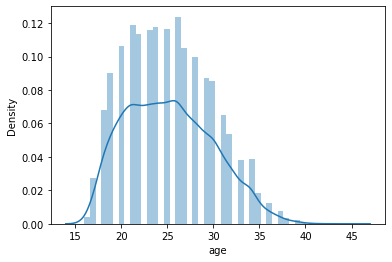

In [113]:
sns.distplot(data.age)

<AxesSubplot:xlabel='age'>

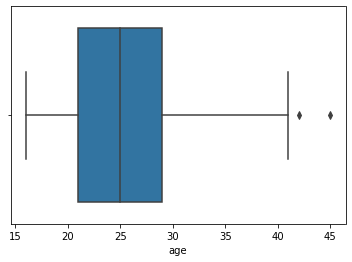

In [114]:
sns.boxplot(data.age)

#### `We can leave outliers in Age` 

### `Overall`

<AxesSubplot:xlabel='overall', ylabel='Density'>

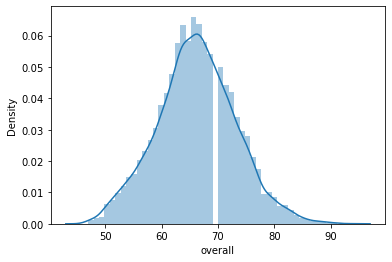

In [115]:
sns.distplot(data.overall)

<AxesSubplot:xlabel='overall'>

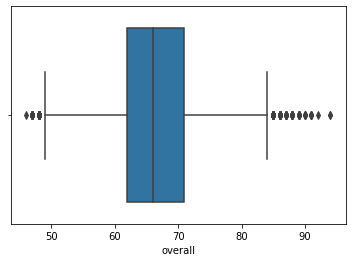

In [116]:
sns.boxplot(data.overall)

In [117]:
# #limit_1 = np.percentile(data.overall,99)
# limit_2 = np.percentile(data.overall,1)
# data = data[data.overall > limit_2]

In [118]:
# sns.boxplot(data.overall)

#### `We should not drop Messi, Ronaldo, Neymar....etc, I will not drop outliers`

### `Potential`

<AxesSubplot:xlabel='potential', ylabel='Density'>

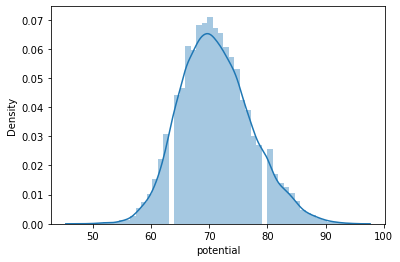

In [119]:
sns.distplot(data.potential)

<AxesSubplot:xlabel='potential'>

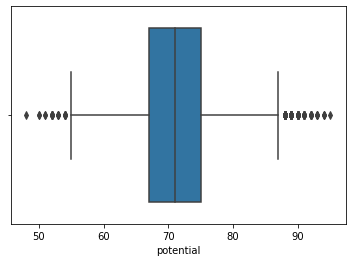

In [120]:
sns.boxplot(data.potential)

### It's not good to drop outliers in potential, because we cannot drop good players as Messi, Neymar and we also should not drop players who have very low potential rating

<AxesSubplot:xlabel='wage', ylabel='Density'>

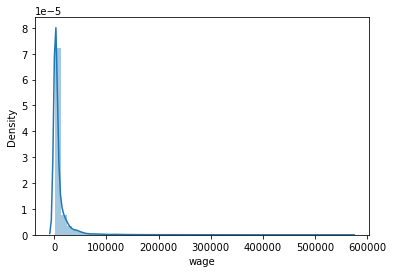

In [121]:
sns.distplot(data.wage)

<AxesSubplot:xlabel='value', ylabel='Density'>

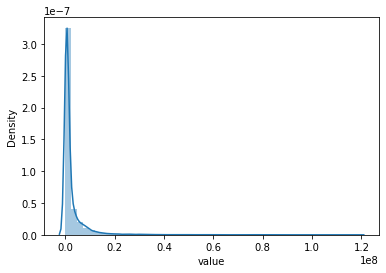

In [122]:
sns.distplot(data.value)

### Some players like Messi, Neymarn, Ronaldo....etc have very high value and wage, hence they are outliers

In [123]:
data.columns

Index(['name', 'age', 'nationality', 'overall', 'potential', 'club', 'value',
       'wage', 'special', 'preferred_foot', 'international_reputation',
       'weak_foot', 'skill_moves', 'work_rate', 'body_type', 'real_face',
       'position', 'jersey_number', 'contract_valid_until', 'height', 'weight',
       'crossing', 'finishing', 'headingaccuracy', 'shortpassing', 'volleys',
       'dribbling', 'curve', 'fkaccuracy', 'longpassing', 'ballcontrol',
       'acceleration', 'sprintspeed', 'agility', 'reactions', 'balance',
       'shotpower', 'jumping', 'stamina', 'strength', 'longshots',
       'aggression', 'interceptions', 'positioning', 'vision', 'penalties',
       'composure', 'marking', 'standingtackle', 'slidingtackle', 'gkdiving',
       'gkhandling', 'gkkicking', 'gkpositioning', 'gkreflexes',
       'release_clause', 'date_joined'],
      dtype='object')

In [124]:
data.drop('jersey_number',axis=1,inplace=True)  # do not make any contribution

### `Plots based on players skill, some are expectionally good, : We should not drop them`

In [125]:
features_other = ['crossing', 'finishing',
       'headingaccuracy', 'shortpassing', 'volleys', 'dribbling', 'curve',
       'fkaccuracy', 'longpassing', 'ballcontrol', 'acceleration',
       'sprintspeed', 'agility', 'reactions', 'balance', 'shotpower',
       'jumping', 'stamina', 'strength', 'longshots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'composure',
       'marking', 'standingtackle', 'slidingtackle', 'gkdiving', 'gkhandling',
       'gkkicking', 'gkpositioning', 'gkreflexes']

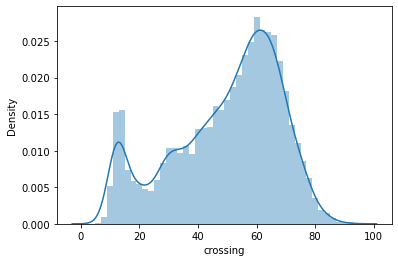

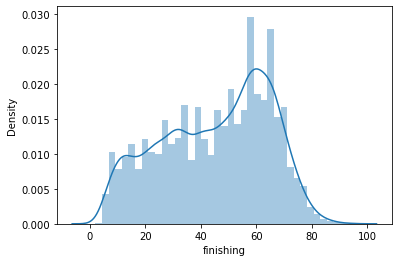

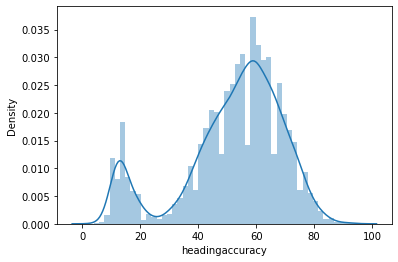

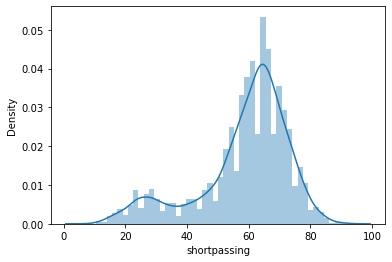

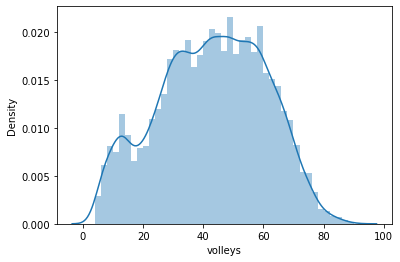

...

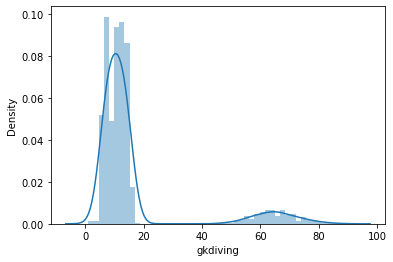

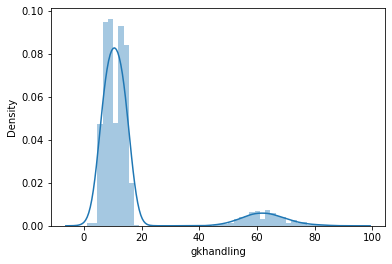

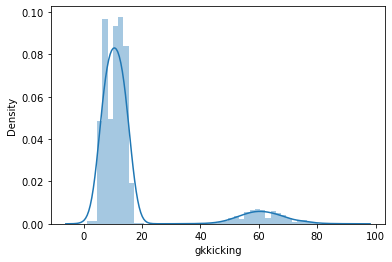

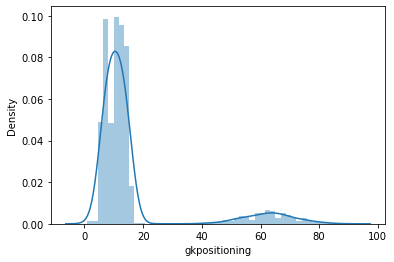

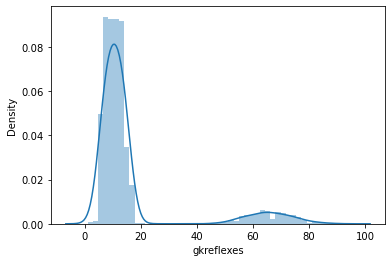

In [126]:
for i in features_other:
    sns.distplot(data[i])
    plt.show()

<AxesSubplot:xlabel='release_clause', ylabel='Density'>

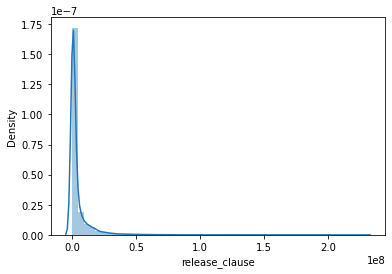

In [127]:
sns.distplot(data.release_clause)

#### `Star footballers like messi, ronaldo, Nwymar, have very high release clause,it's obvious,  so it's good to drop them`

# `Task 2 - K Means`

In [128]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

In [129]:
data['Experience'] = data.contract_valid_until - data.date_joined

In [130]:
data.drop(['date_joined','contract_valid_until'],axis=1,inplace=True)

In [131]:
data.head()

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,Experience
0,L. Messi,31,Argentina,94,94,FC Barcelona,110500000.0,565000.0,2202,Left,5.0,4.0,4.0,Medium/ Medium,Lean,Yes,RF,173.7360,159.0,84.0,95.0,70.0,90.0,86.0,97.0,93.0,94.0,87.0,96.0,91.0,86.0,91.0,95.0,95.0,85.0,68.0,72.0,59.0,94.0,48.0,22.0,94.0,94.0,75.0,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,226500000.0,17.0
1,Cristiano Ronaldo,33,Portugal,94,94,Juventus,77000000.0,405000.0,2228,Right,5.0,4.0,5.0,High/ Low,Lean,Yes,ST,188.9760,183.0,84.0,94.0,89.0,81.0,87.0,88.0,81.0,76.0,77.0,94.0,89.0,91.0,87.0,96.0,70.0,95.0,95.0,88.0,79.0,93.0,63.0,29.0,95.0,82.0,85.0,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,127100000.0,4.0
2,Neymar Jr,26,Brazil,92,93,Paris Saint-Germain,118500000.0,290000.0,2143,Right,5.0,5.0,5.0,High/ Medium,Lean,Yes,LW,179.8320,150.0,79.0,87.0,62.0,84.0,84.0,96.0,88.0,87.0,78.0,95.0,94.0,90.0,96.0,94.0,84.0,80.0,61.0,81.0,49.0,82.0,56.0,36.0,89.0,87.0,81.0,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,228100000.0,5.0
3,De Gea,27,Spain,91,93,Manchester United,72000000.0,260000.0,1471,Right,4.0,3.0,1.0,Medium/ Medium,Lean,Yes,GK,195.0720,168.0,17.0,13.0,21.0,50.0,13.0,18.0,21.0,19.0,51.0,42.0,57.0,58.0,60.0,90.0,43.0,31.0,67.0,43.0,64.0,12.0,38.0,30.0,12.0,68.0,40.0,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,138600000.0,9.0
4,K. De Bruyne,27,Belgium,91,92,Manchester City,102000000.0,355000.0,2281,Right,4.0,5.0,4.0,High/ High,Normal,Yes,RCM,155.7528,154.0,93.0,82.0,55.0,92.0,82.0,86.0,85.0,83.0,91.0,91.0,78.0,76.0,79.0,91.0,77.0,91.0,63.0,90.0,75.0,91.0,76.0,61.0,87.0,94.0,79.0,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,196400000.0,8.0


In [132]:
data.shape

(16643, 55)

In [133]:
data[['age', 'overall', 'potential', 'value',
       'wage', 'special',
       'skill_moves',
       'height', 'weight', 'crossing', 'finishing',
       'headingaccuracy', 'shortpassing', 'volleys', 'dribbling', 'curve',
       'fkaccuracy', 'longpassing', 'ballcontrol', 'acceleration',
       'sprintspeed', 'agility', 'reactions', 'balance', 'shotpower',
       'jumping', 'stamina', 'strength', 'longshots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'composure',
       'marking', 'standingtackle', 'slidingtackle', 'gkdiving', 'gkhandling',
       'gkkicking', 'gkpositioning', 'gkreflexes', 'release_clause',
       'Experience']] = sc.fit_transform(data[['age', 'overall', 'potential', 'value',
                                               'wage', 'special',
                                               'skill_moves',
                                               'height', 'weight', 'crossing', 'finishing',
                                               'headingaccuracy', 'shortpassing', 'volleys', 'dribbling', 'curve',
                                               'fkaccuracy', 'longpassing', 'ballcontrol', 'acceleration',
                                               'sprintspeed', 'agility', 'reactions', 'balance', 'shotpower',
                                               'jumping', 'stamina', 'strength', 'longshots', 'aggression',
                                               'interceptions', 'positioning', 'vision', 'penalties', 'composure',
                                               'marking', 'standingtackle', 'slidingtackle', 'gkdiving', 'gkhandling',
                                               'gkkicking', 'gkpositioning', 'gkreflexes', 'release_clause',
                                               'Experience']])

In [134]:
data.head()

,name,age,nationality,overall,potential,club,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,work_rate,body_type,real_face,position,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,Experience
0,L. Messi,1.224180,Argentina,3.972193,3.716187,FC Barcelona,18.889634,24.946580,2.200160,Left,5.0,4.0,2.183663,Medium/ Medium,Lean,Yes,RF,-0.212555,-0.448621,1.864404,2.545911,1.023382,2.123931,2.441998,2.204082,2.490897,2.920422,2.232619,2.255869,1.765474,1.453487,1.864816,3.642633,2.191081,1.718789,0.242862,0.550303,-0.503893,2.439461,-0.454851,-1.195295,2.258488,2.872055,1.691432,3.244788,-0.718726,-0.912142,-0.927542,-0.602719,-0.323818,-0.081598,-0.145992,-0.488513,19.959280,5.576596
1,Cristiano Ronaldo,1.648228,Portugal,3.972193,3.716187,Juventus,13.033458,17.759719,2.294460,Right,5.0,4.0,3.506707,High/ Low,Lean,Yes,ST,0.901459,1.092325,1.864404,2.494729,2.110912,1.516246,2.498367,1.730598,1.841076,1.894604,1.582928,2.136712,1.632521,1.792276,1.594741,3.752289,0.429601,2.296551,2.520165,1.546327,1.092235,2.387738,0.406136,-0.857809,2.309481,2.025267,2.325686,3.158125,-0.969521,-0.773773,-1.068423,-0.546639,-0.323818,-0.081598,-0.145992,-0.322679,11.019132,0.093215
2,Neymar Jr,0.164060,Brazil,3.686806,3.553618,Paris Saint-Germain,20.288124,12.594163,1.986171,Right,5.0,5.0,3.506707,High/ Medium,Lean,Yes,LW,0.233051,-1.026476,1.593446,2.136454,0.565475,1.718807,2.329260,2.151473,2.220138,2.521493,1.647897,2.196291,1.964904,1.724518,2.202408,3.532978,1.416030,1.429908,-0.347549,1.110566,-1.301958,1.818794,0.004342,-0.520322,2.003524,2.378095,2.071984,3.071461,-1.019680,-1.096634,-0.598820,-0.434479,-0.441234,-0.081598,-0.087687,-0.322679,20.103186,0.515013
3,De Gea,0.376084,Spain,3.544112,3.553618,Manchester United,12.159402,11.246627,-0.451131,Right,4.0,3.0,-1.785470,Medium/ Medium,Lean,Yes,GK,1.347064,0.129234,-1.766444,-1.651019,-1.781301,-0.576893,-1.672940,-1.952055,-1.408031,-1.353821,-0.106270,-0.961377,-0.494730,-0.443734,-0.228260,3.094357,-1.472798,-1.401126,0.158518,-1.254990,-0.104861,-1.801763,-1.028842,-0.809596,-1.922933,1.037348,-0.528454,0.818216,-1.621587,-1.235003,-1.538027,4.107983,4.020589,4.251792,4.168576,4.265379,12.053455,2.202208
4,K. De Bruyne,0.376084,Belgium,3.544112,3.391048,Manchester City,17.403739,15.513825,2.486688,Right,4.0,5.0,2.183663,High/ High,Normal,Yes,RCM,-1.527091,-0.769652,2.352130,1.880544,0.164806,2.258972,2.216522,1.625380,2.057683,2.293533,2.492496,1.957976,0.901278,0.775908,1.054593,3.204012,0.922815,2.065446,-0.178860,1.670830,0.773009,2.284294,1.152324,0.684988,1.901538,2.872055,1.945134,2.551482,1.036837,0.471548,0.246466,-0.098001,-0.206401,-0.683458,-0.379212,-0.212124,17.252052,1.780409


In [135]:
data.preferred_foot.isnull().sum()

0

### `Drop categorical columns, as Kmeans works only with numerical data`

In [136]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
data['preferred_foot']= le.fit_transform(data['preferred_foot'])
data['real_face']= le.fit_transform(data['real_face'])

In [137]:
data.drop(['name','nationality','club','work_rate','body_type','position'],axis=1,inplace=True)

In [138]:
data.shape

(16643, 49)

In [139]:
data.head()

,age,overall,potential,value,wage,special,preferred_foot,international_reputation,weak_foot,skill_moves,real_face,height,weight,crossing,finishing,headingaccuracy,shortpassing,volleys,dribbling,curve,fkaccuracy,longpassing,ballcontrol,acceleration,sprintspeed,agility,reactions,balance,shotpower,jumping,stamina,strength,longshots,aggression,interceptions,positioning,vision,penalties,composure,marking,standingtackle,slidingtackle,gkdiving,gkhandling,gkkicking,gkpositioning,gkreflexes,release_clause,Experience
0,1.224180,3.972193,3.716187,18.889634,24.946580,2.200160,0,5.0,4.0,2.183663,1,-0.212555,-0.448621,1.864404,2.545911,1.023382,2.123931,2.441998,2.204082,2.490897,2.920422,2.232619,2.255869,1.765474,1.453487,1.864816,3.642633,2.191081,1.718789,0.242862,0.550303,-0.503893,2.439461,-0.454851,-1.195295,2.258488,2.872055,1.691432,3.244788,-0.718726,-0.912142,-0.927542,-0.602719,-0.323818,-0.081598,-0.145992,-0.488513,19.959280,5.576596
1,1.648228,3.972193,3.716187,13.033458,17.759719,2.294460,1,5.0,4.0,3.506707,1,0.901459,1.092325,1.864404,2.494729,2.110912,1.516246,2.498367,1.730598,1.841076,1.894604,1.582928,2.136712,1.632521,1.792276,1.594741,3.752289,0.429601,2.296551,2.520165,1.546327,1.092235,2.387738,0.406136,-0.857809,2.309481,2.025267,2.325686,3.158125,-0.969521,-0.773773,-1.068423,-0.546639,-0.323818,-0.081598,-0.145992,-0.322679,11.019132,0.093215
2,0.164060,3.686806,3.553618,20.288124,12.594163,1.986171,1,5.0,5.0,3.506707,1,0.233051,-1.026476,1.593446,2.136454,0.565475,1.718807,2.329260,2.151473,2.220138,2.521493,1.647897,2.196291,1.964904,1.724518,2.202408,3.532978,1.416030,1.429908,-0.347549,1.110566,-1.301958,1.818794,0.004342,-0.520322,2.003524,2.378095,2.071984,3.071461,-1.019680,-1.096634,-0.598820,-0.434479,-0.441234,-0.081598,-0.087687,-0.322679,20.103186,0.515013
3,0.376084,3.544112,3.553618,12.159402,11.246627,-0.451131,1,4.0,3.0,-1.785470,1,1.347064,0.129234,-1.766444,-1.651019,-1.781301,-0.576893,-1.672940,-1.952055,-1.408031,-1.353821,-0.106270,-0.961377,-0.494730,-0.443734,-0.228260,3.094357,-1.472798,-1.401126,0.158518,-1.254990,-0.104861,-1.801763,-1.028842,-0.809596,-1.922933,1.037348,-0.528454,0.818216,-1.621587,-1.235003,-1.538027,4.107983,4.020589,4.251792,4.168576,4.265379,12.053455,2.202208
4,0.376084,3.544112,3.391048,17.403739,15.513825,2.486688,1,4.0,5.0,2.183663,1,-1.527091,-0.769652,2.352130,1.880544,0.164806,2.258972,2.216522,1.625380,2.057683,2.293533,2.492496,1.957976,0.901278,0.775908,1.054593,3.204012,0.922815,2.065446,-0.178860,1.670830,0.773009,2.284294,1.152324,0.684988,1.901538,2.872055,1.945134,2.551482,1.036837,0.471548,0.246466,-0.098001,-0.206401,-0.683458,-0.379212,-0.212124,17.252052,1.780409


### `Feature Selection ------------------------------------------------`

In [140]:
from statsmodels.stats.outliers_influence import variance_inflation_factor # to check multicollinearity


### function of vif
def cal_vif(X):
    vif=pd.DataFrame()
    vif['var']=X.columns
    vif['VIF']=[variance_inflation_factor(X.values,i) for i in range(X.shape[1])]
    vif['VIF'] = round(vif['VIF'], 2)
    vif = vif.sort_values(by = "VIF", ascending = False)
    return(vif)

In [141]:
cal_vif(data)

,var,VIF
5,special,25769.49
40,standingtackle,186.55
41,slidingtackle,176.36
34,interceptions,157.20
39,marking,141.61
35,positioning,140.78
46,gkreflexes,140.33
14,finishing,140.17
18,dribbling,139.46
42,gkdiving,136.17


In [142]:
data.drop(['special','slidingtackle','slidingtackle','interceptions','marking'],axis=1,inplace=True)

In [143]:
cal_vif(data)

,var,VIF
3,value,99.54
43,release_clause,93.79
42,gkreflexes,29.71
38,gkdiving,29.18
39,gkhandling,27.16
41,gkpositioning,26.57
40,gkkicking,21.76
21,ballcontrol,19.96
17,dribbling,16.54
1,overall,15.16


In [144]:
data.drop(['value','release_clause','gkreflexes','gkdiving'],axis=1,inplace=True)

In [145]:
cal_vif(data)

,var,VIF
37,gkhandling,23.62
39,gkpositioning,22.87
20,ballcontrol,19.82
38,gkkicking,19.35
16,dribbling,16.53
1,overall,14.22
14,shortpassing,13.00
6,weak_foot,12.33
5,international_reputation,11.99
12,finishing,10.91


In [146]:
data.drop(['gkhandling','gkpositioning','ballcontrol','gkkicking','dribbling'],axis=1,inplace=True)

In [147]:
cal_vif(data)

,var,VIF
6,weak_foot,12.30
5,international_reputation,11.96
1,overall,11.87
14,shortpassing,10.80
12,finishing,10.69
28,longshots,9.46
30,positioning,9.14
19,acceleration,9.00
20,sprintspeed,7.45
18,longpassing,7.39


In [148]:
data.drop(['overall','international_reputation','shortpassing','finishing'],axis=1,inplace=True)

In [149]:
cal_vif(data)

,var,VIF
15,acceleration,8.99
24,longshots,8.64
26,positioning,7.81
16,sprintspeed,7.42
12,curve,7.21
20,shotpower,6.66
11,volleys,6.48
9,crossing,6.06
13,fkaccuracy,5.10
17,agility,4.77


In [150]:
data.to_csv('fifa_clean_final')

### `now it's tolerable state`

## `PCA for visualization`

In [151]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
pca.fit(data)
data = pca.transform(data)
data

array([[11.6949838 ,  4.60212222, 11.92836915],
       [10.91338217,  5.84140005,  7.76665387],
       [10.08390895,  1.13724522,  7.42963408],
       ...,
       [-2.81762087, -3.73684986,  0.16129887],
       [-2.97705179, -4.35958158, -0.33198931],
       [-2.84255721, -1.48395781, -1.05112701]])

In [152]:
sum(pca.explained_variance_ratio_)

0.6320948580779183

In [153]:
data = pd.DataFrame(data,columns=['PCA1','PCA2','PCA3'])

In [154]:
data.head()

,PCA1,PCA2,PCA3
0,11.694984,4.602122,11.928369
1,10.913382,5.841400,7.766654
2,10.083909,1.137245,7.429634
3,-2.507344,3.710601,6.749564
4,10.342247,3.757125,7.238854



-----------------------------------------------------------------
-----------------------------------------------------------------

## `K-means`
### `K = 3`

In [155]:
from sklearn.cluster import KMeans
km = KMeans(n_clusters=3,random_state=0,init='k-means++')
km.fit(data)

KMeans(n_clusters=3, random_state=0)

In [156]:
np.round(km.cluster_centers_) 

array([[ 3., -0.,  0.],
       [-8.,  0.,  2.],
       [-1.,  0., -1.]])

In [157]:
cluster_id_3 = km.predict(data)

In [158]:
cluster_id_3

array([0, 0, 0, ..., 2, 2, 2])

In [159]:
data['cluster_id_3'] = cluster_id_3

In [160]:
data.cluster_id_3.value_counts()

0    7383
2    7328
1    1932
Name: cluster_id_3, dtype: int64

In [161]:
data.head()

,PCA1,PCA2,PCA3,cluster_id_3
0,11.694984,4.602122,11.928369,0
1,10.913382,5.841400,7.766654,0
2,10.083909,1.137245,7.429634,0
3,-2.507344,3.710601,6.749564,1
4,10.342247,3.757125,7.238854,0


In [162]:
#X = data[['PCA1','PCA2','PCA3']].values
# y = data.cluster_id_3

In [163]:
# X

In [164]:
import plotly.express as px
px.scatter_3d(data,x='PCA1',y="PCA2",z="PCA3",color="cluster_id_3")

### `K = 5`

In [165]:
km = KMeans(n_clusters=5,random_state=0,init='k-means++')
km.fit(data)

KMeans(n_clusters=5, random_state=0)

In [166]:
np.round(km.cluster_centers_) 

array([[-1.,  2., -1.,  2.],
       [-1., -2., -1.,  2.],
       [-8.,  0.,  2.,  1.],
       [ 4.,  1.,  1.,  0.],
       [ 2., -1.,  0., -0.]])

In [167]:
cluster_id_5 = km.predict(data)

In [168]:
cluster_id_5

array([3, 3, 3, ..., 1, 1, 1])

In [169]:
data['cluster_id_5'] = cluster_id_5

In [170]:
data.cluster_id_5.value_counts()

4    4023
1    3951
0    3394
3    3360
2    1915
Name: cluster_id_5, dtype: int64

In [171]:
data.head()

,PCA1,PCA2,PCA3,cluster_id_3,cluster_id_5
0,11.694984,4.602122,11.928369,0,3
1,10.913382,5.841400,7.766654,0,3
2,10.083909,1.137245,7.429634,0,3
3,-2.507344,3.710601,6.749564,1,2
4,10.342247,3.757125,7.238854,0,3


In [172]:
import plotly.express as px
px.scatter_3d(data,x='PCA1',y="PCA2",z="PCA3",color="cluster_id_5")

### `K = 7`

In [173]:
km = KMeans(n_clusters=7,random_state=0,init='k-means++')
km.fit(data)

KMeans(n_clusters=7, random_state=0)

In [174]:
np.round(km.cluster_centers_) 

array([[-1., -2., -1.,  2.,  1.],
       [ 2., -1.,  0., -0.,  4.],
       [-0.,  2., -1.,  2.,  0.],
       [-8.,  0.,  2.,  1.,  2.],
       [ 5.,  1.,  2., -0.,  3.],
       [-3.,  1., -2.,  2.,  0.],
       [ 3.,  2.,  0.,  0.,  3.]])

In [175]:
cluster_id_7 = km.predict(data)

In [176]:
cluster_id_7

array([4, 4, 4, ..., 0, 0, 0])

In [177]:
data['cluster_id_7'] = cluster_id_7

In [178]:
data.cluster_id_7.value_counts()

0    3629
1    3520
6    2363
2    2080
3    1901
5    1650
4    1500
Name: cluster_id_7, dtype: int64

In [179]:
data.head()

,PCA1,PCA2,PCA3,cluster_id_3,cluster_id_5,cluster_id_7
0,11.694984,4.602122,11.928369,0,3,4
1,10.913382,5.841400,7.766654,0,3,4
2,10.083909,1.137245,7.429634,0,3,4
3,-2.507344,3.710601,6.749564,1,2,3
4,10.342247,3.757125,7.238854,0,3,4


In [180]:
import plotly.express as px
px.scatter_3d(data,x='PCA1',y="PCA2",z="PCA3",color="cluster_id_7")

### `Elbow method`

In [181]:
wss = []

for i in range(2,12):
    km = KMeans(n_clusters=i,random_state=0,init='k-means++')
    km.fit(data)
    wss.append(km.inertia_)

Text(0.5, 1.0, 'Elbow Method')

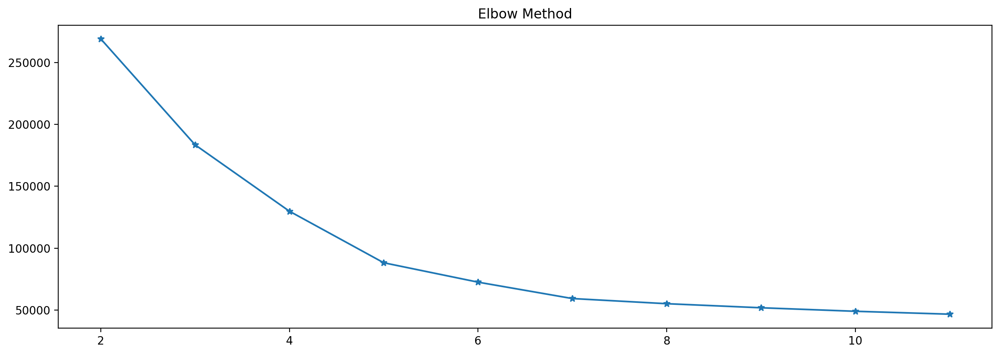

In [182]:
plt.figure(figsize=(15,5),dpi=200)
plt.plot(range(2,12),wss,marker='*')
plt.title('Elbow Method')

### `Silhoutte method`

In [183]:
from sklearn.metrics import silhouette_score
Silhoutte_scores = []

for i in range(2,12):
    km = KMeans(n_clusters=i,random_state=0,init='k-means++')
    km.fit(data)
    cluster_id = km.predict(data)
    scores = silhouette_score(data,cluster_id)
    Silhoutte_scores.append(scores)

Text(0.5, 1.0, 'Silhouette Method')

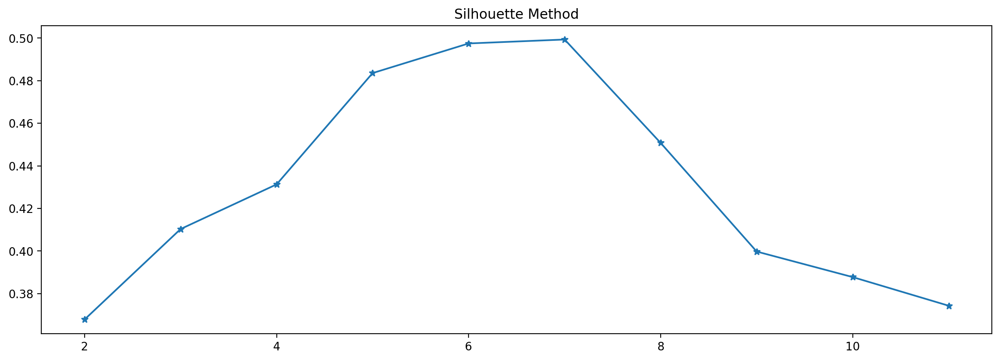

In [184]:
plt.figure(figsize=(15,5),dpi=200)
plt.plot(range(2,12),Silhoutte_scores,marker='*')
plt.title('Silhouette Method')

### `I am getting 7 as the optimum number of custer acc. to silhoutte and elbow method`

### `Final fit`

In [185]:
from sklearn.cluster import KMeans
km = KMeans(n_clusters=7,random_state=0,init='k-means++')
km.fit(data)

KMeans(n_clusters=7, random_state=0)

In [186]:
np.round(km.cluster_centers_) 

array([[ 2., -1.,  0., -0.,  4.,  1.],
       [-0.,  2., -1.,  2.,  0.,  2.],
       [ 5.,  1.,  2., -0.,  3.,  4.],
       [-1., -2., -1.,  2.,  1.,  0.],
       [-8.,  0.,  2.,  1.,  2.,  3.],
       [ 3.,  2.,  0.,  0.,  3.,  6.],
       [-3.,  1., -2.,  2.,  0.,  5.]])

In [187]:
cluster_id_7 = km.predict(data)

In [188]:
data['cluster_id_7'] = cluster_id_7

In [189]:
data.cluster_id_7.value_counts()

3    3629
0    3520
5    2363
1    2080
4    1901
6    1650
2    1500
Name: cluster_id_7, dtype: int64

In [190]:
data.head(5)

,PCA1,PCA2,PCA3,cluster_id_3,cluster_id_5,cluster_id_7
0,11.694984,4.602122,11.928369,0,3,2
1,10.913382,5.841400,7.766654,0,3,2
2,10.083909,1.137245,7.429634,0,3,2
3,-2.507344,3.710601,6.749564,1,2,4
4,10.342247,3.757125,7.238854,0,3,2


In [191]:
import plotly.express as px
px.scatter_3d(data,x='PCA1',y="PCA2",z="PCA3",color="cluster_id_7")

### `Star players are clustered together: Messi, Ronaldo, Neymar, K. De Bruyne are in 0 ....etc`

- [Evaluating clusters](https://towardsdatascience.com/clustering-evaluation-strategies-98a4006fcfc)
- [Silhoutte coefficient for cluster analysis](https://towardsdatascience.com/silhouette-coefficient-validating-clustering-techniques-e976bb81d10c)
#### -  `Non-uniform distribution of points in data set becomes important in clustering: clustering tendency`
#### - `Ideal clustering is characterised by minimal intra cluster distance and maximal inter cluster distance`

# `Task 3 - Hierarchical Clustering`

In [192]:
data.drop(['cluster_id_3','cluster_id_5','cluster_id_7'],axis=1,inplace=True)

In [193]:
from sklearn.cluster import AgglomerativeClustering

agg = AgglomerativeClustering(n_clusters=6, affinity='euclidean', linkage='ward')
agg.fit(data)
cluster_hierarchical = agg.fit_predict(data)

In [194]:
data['cluster_hierarchical'] = cluster_hierarchical

In [195]:
data.head()

,PCA1,PCA2,PCA3,cluster_hierarchical
0,11.694984,4.602122,11.928369,5
1,10.913382,5.841400,7.766654,5
2,10.083909,1.137245,7.429634,5
3,-2.507344,3.710601,6.749564,3
4,10.342247,3.757125,7.238854,5


In [196]:
data.cluster_hierarchical.value_counts()

1    3684
2    3519
0    3204
4    2404
5    1933
3    1899
Name: cluster_hierarchical, dtype: int64

In [197]:
import plotly.express as px
px.scatter_3d(data,x='PCA1',y="PCA2",z="PCA3",color='cluster_hierarchical')

In [198]:
data.drop('cluster_hierarchical',axis=1,inplace=True)

In [199]:
data.head()

,PCA1,PCA2,PCA3
0,11.694984,4.602122,11.928369
1,10.913382,5.841400,7.766654
2,10.083909,1.137245,7.429634
3,-2.507344,3.710601,6.749564
4,10.342247,3.757125,7.238854


### `Dendogram`

#### `My cpu is taking time: So I have made dendogram in Tpu in colab`
#### `It has suggested to cluster data into 2 classes`
- [colab link to plotting dendogram](https://colab.research.google.com/drive/1hGabeC_bxJ_hfWulTx7YE0KzjvSU6MDL#scrollTo=6_TCA3SYCgKK)

In [200]:
from sklearn.cluster import KMeans
km = KMeans(n_clusters=2,random_state=0,init='k-means++')
km.fit(data)

KMeans(n_clusters=2, random_state=0)

In [201]:
np.round(km.cluster_centers_) 

array([[ 2., -0., -0.],
       [-5.,  1.,  0.]])

In [202]:
cluster_id_2 = km.predict(data)

In [203]:
data['cluster_id_2'] = cluster_id_2

In [204]:
import plotly.express as px
px.scatter_3d(data,x='PCA1',y="PCA2",z="PCA3",color="cluster_id_2")

In [205]:
# import scipy.cluster.hierarchy as sch

# plt.figure(figsize=(24,8))
# dend = sch.dendrogram(sch.linkage(data,method="ward"))
# plt.title('Dendogram')
# plt.xlabel("Player")
# plt.ylabel("Distance")
# plt.show()

# `Task 4 - DBScan`
 - [Blog on DBScan](https://www.analyticsvidhya.com/blog/2020/09/how-dbscan-clustering-works/)
 - [sklearn documentation](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html)
 - [Evatuating clustering](https://www.geeksforgeeks.org/ml-intercluster-and-intracluster-distance/)
 - [Are clusters good](https://towardsdatascience.com/are-the-clusters-good-1567de6a9524)
 - [Purity in clusters](https://towardsdatascience.com/evaluation-metrics-for-clustering-models-5dde821dd6cd)
### => K-Means and Hierarchical Clustering both fail in creating clusters of arbitrary shapes. They are not able to form clusters based on varying densities. That’s why we need DBSCAN clustering.
### => DBSCAN stands for `Density-Based Spatial Clustering of Applications with Noise`
### => DBSCAN is a density-based clustering algorithm that works on the assumption that clusters are dense regions in space separated by regions of lower density.
### => It groups `‘densely grouped’` data points into a single cluster. It can identify clusters in large spatial datasets by looking at the local density of the data points. 
### => The most exciting feature of DBSCAN clustering is that it is robust to outliers. It also does not require the number of clusters to be told beforehand, unlike K-Means, where we have to specify the number of centroids.
### => DBSCAN requires only two parameters: `epsilon` and `minPoints`. `Epsilon` is the radius of the circle to be created around each data point to check the density and minPoints is the minimum number of data points required inside that circle for that data point to be classified as a Core point.
### => In higher dimensions the circle becomes hypersphere, epsilon becomes the radius of that hypersphere, and minPoints is the minimum number of data points required inside that hypersphere.

In [206]:
from sklearn.cluster import DBSCAN
clustering = DBSCAN(eps=3, min_samples=data.shape[1]).fit(data)   # eps: epsilon , min_samples: midPoints

In [207]:
clustering.labels_

array([-1,  0,  0, ...,  0,  0,  0], dtype=int64)

In [208]:
data['dubscan_cluster'] = clustering.labels_

In [209]:
data.head()

,PCA1,PCA2,PCA3,cluster_id_2,dubscan_cluster
0,11.694984,4.602122,11.928369,0,-1
1,10.913382,5.841400,7.766654,0,0
2,10.083909,1.137245,7.429634,0,0
3,-2.507344,3.710601,6.749564,1,0
4,10.342247,3.757125,7.238854,0,0


In [210]:
data.dubscan_cluster.value_counts()

 0    16642
-1        1
Name: dubscan_cluster, dtype: int64

In [211]:
import plotly.express as px
px.scatter_3d(data,x='PCA1',y="PCA2",z="PCA3",color='dubscan_cluster')

### `Evaluation of Clusters ( Extra topics to do ) `
##### - [Silhouette Coefficient](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html)
- The best value is 1 and the worst value is -1. Values near 0 indicate overlapping clusters. Negative values generally indicate that a sample has been assigned to the wrong cluster, as a different cluster is more similar.

##### - [Gap Estimate *****](https://towardsdatascience.com/k-means-clustering-and-the-gap-statistics-4c5d414acd29)

##### - [Gap Estimate vs Elbow vs Silhoutte](https://www.datanovia.com/en/lessons/determining-the-optimal-number-of-clusters-3-must-know-methods/)

## `END ------------------------------------------------------------------------`